In [4]:
import os
os.chdir('..')

In [5]:
!nvidia-smi

Thu May 11 21:11:39 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 510.47.03    Driver Version: 510.47.03    CUDA Version: 11.6     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  On   | 00000000:15:00.0 Off |                    0 |
| N/A   25C    P0    40W / 300W |      0MiB / 32768MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-SXM2...  On   | 00000000:16:00.0 Off |                    0 |
| N/A   

In [8]:
#from utils.marvl_preproc import marvl_preproc
#import argparse
#import os
#import sys
#import math
#
#import ruamel.yaml as yaml
#import numpy as np
#import random
#import time
#import datetime
#import json
#from pathlib import Path
#import json
#import pickle
#
#import torch
#import torch.backends.cudnn as cudnn
#import torch.distributed as dist
#from torch.utils.data import Dataset
#import torch.nn as nn
#
#from models.model_nlvr import NLVRModel
#
#import utils
#from torch.utils.data import DataLoader,WeightedRandomSampler
#from dataset import create_dataset, create_sampler, create_loader, build_tokenizer
#from scheduler import create_scheduler
#from optim import create_optimizer
#from models.model_pretrain_cclm import CrossViewLM
#
#from torch.utils.data import DataLoader
#from torchvision import transforms
#
#from torchvision.transforms import InterpolationMode
#from dataset.randaugment import RandomAugment
#
#from dataset.nlvr_dataset import nlvr_dataset
#from PIL import Image
#import pandas as pd
#import numpy as np
#
#import matplotlib.pyplot as plt
#from transformers import AutoTokenizer, AutoModelForMaskedLM
#from models import build_mlp
#import re
#from collections import OrderedDict
#from optim import create_optimizer

from useful_functions import *
device = 'cuda'
# remember to set GPU
os.environ['CUDA_VISIBLE_DEVICES'] = '2,3'
config = yaml.load(open('configs/Pretrain_4m.yaml', 'r'), Loader=yaml.Loader)
os.environ["TOKENIZERS_PARALLELISM"] = "false"

In [9]:
# data augumentations
normalize = transforms.Normalize((0.48145466, 0.4578275, 0.40821073), (0.26862954, 0.26130258, 0.27577711))

pretrain_transform = transforms.Compose([
    transforms.RandomResizedCrop(config['image_res'], scale=(0.2, 1.0),
                                 interpolation=InterpolationMode.BICUBIC),
    transforms.RandomHorizontalFlip(),
    RandomAugment(2, 7, isPIL=True, augs=['Identity', 'AutoContrast', 'Equalize', 'Brightness', 'Sharpness',
                                          'ShearX', 'ShearY', 'TranslateX', 'TranslateY', 'Rotate']),
    transforms.ToTensor(),
    normalize,
])

train_transform_zoom_corp = transforms.Compose([
    transforms.Resize((int(config['image_res'] * 1.5), int(config['image_res'] * 1.5)), interpolation=InterpolationMode.BICUBIC),
    transforms.CenterCrop(config['image_res'],# scale=(0.5, 1.0),
                                 #interpolation=InterpolationMode.BICUBIC
                         ),
    #transforms.RandomHorizontalFlip(),
    RandomAugment(2, 7, isPIL=True, augs=['AutoContrast','Identity', 'Brightness', 'Sharpness']),
    transforms.ToTensor(),
    normalize,
])

train_transform = transforms.Compose([
    transforms.CenterCrop(config['image_res'],# scale=(0.5, 1.0),
                                 #interpolation=InterpolationMode.BICUBIC
                         ),
    #transforms.RandomHorizontalFlip(),
    RandomAugment(2, 7, isPIL=True, augs=['AutoContrast','Identity', 'Brightness', 'Sharpness']),
    transforms.ToTensor(),
    normalize,
])

val_transform = transforms.Compose([
    transforms.Resize((config['image_res'], config['image_res']), interpolation=InterpolationMode.BICUBIC),
    transforms.ToTensor(),
    normalize,
])

In [10]:
num_gpus = torch.cuda.device_count()
print(f"Number of available GPUs: {num_gpus}")

for i in range(num_gpus):
    gpu_name = torch.cuda.get_device_name(i)
    print(f"GPU {i}: {gpu_name}")

Number of available GPUs: 2
GPU 0: Tesla V100-SXM2-32GB
GPU 1: Tesla V100-SXM2-32GB


In [23]:
# load and preprocess dataset
data_path = '/mnt/swordfish-pool2/ccu/amith-cache.pkl'
with open(data_path, 'rb') as handle:
    dataset = pickle.load(handle)

# delete file without jpgs
keys_to_remove = []
for key in dataset.keys():
    if dataset[key]['data_type'] !='video':
        keys_to_remove.append(key)
    elif dataset[key]['processed'] == False:
        keys_to_remove.append(key)
for key in keys_to_remove:
    del dataset[key]

# train val test split
train_dataset = {}
val_dataset = {}
test_dataset = {}
final_eval_dataset = {}
for key in dataset.keys():
    if 'INTERNAL_TRAIN' in dataset[key]['splits']:
        train_dataset.update({key:dataset[key]})
    # some file have both split EVALUATION_LDC2023E07 and INTERNAL_TRAIN
    if 'EVALUATION_LDC2023E07' in dataset[key]['splits']:
        final_eval_dataset.update({key:dataset[key]})
    if 'INTERNAL_VAL' in dataset[key]['splits']:
        val_dataset.update({key:dataset[key]})
    if 'INTERNAL_TEST' in dataset[key]['splits']:
        test_dataset.update({key:dataset[key]})

In [24]:
# convert dataset into csv_form
train_csv = construct_dataset_csv(train_dataset,'whisper', use_context=True)
val_csv = construct_dataset_csv(val_dataset,'whisper', use_context=True)
test_csv = construct_dataset_csv(test_dataset,'whisper', use_context=True)

In [27]:
# test_parameters 
train_batch_size_for_test = 32
test_seed = 123

# val_dataset
val_dataset = LDCDataset_val(val_csv, val_transform)


# train_dataloader
# random_corp dataloader
test_data_loader = create_down_sample_dataloader(train_csv, 123, train_batch_size_for_test, 
                              train_transform_zoom_corp,2)

# zoom_corp dataloader
#test_data_loader = create_down_sample_dataloader(train_csv, 123, train_batch_size_for_test, 
#                              train_transform_zoom_corp,2)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


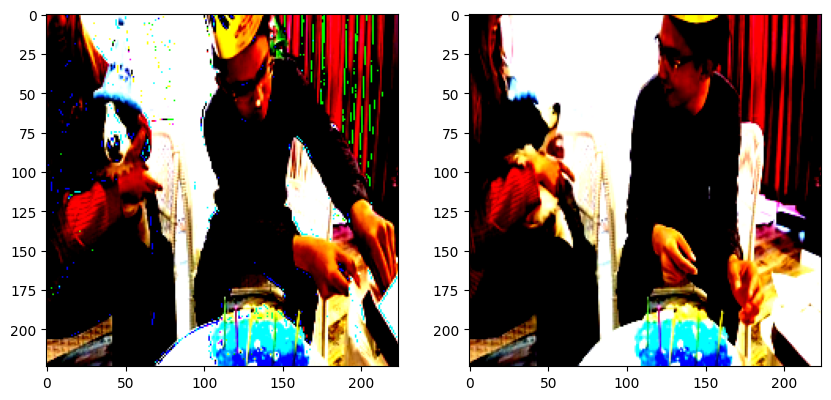

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


这么快 多许点 来半斤来 一起吹 哇 弄了狗又弄了笛子 快乐 半斤 来笛子别动 笛子<Pre_Context>看他有没有吃<Post_Context>他在舔 舔 他明明舔不到你看他 舔到了 开心吗半斤 开心吗 哎哟 不会吧一口就吃完了 一口就吃了 天呐
label: 1


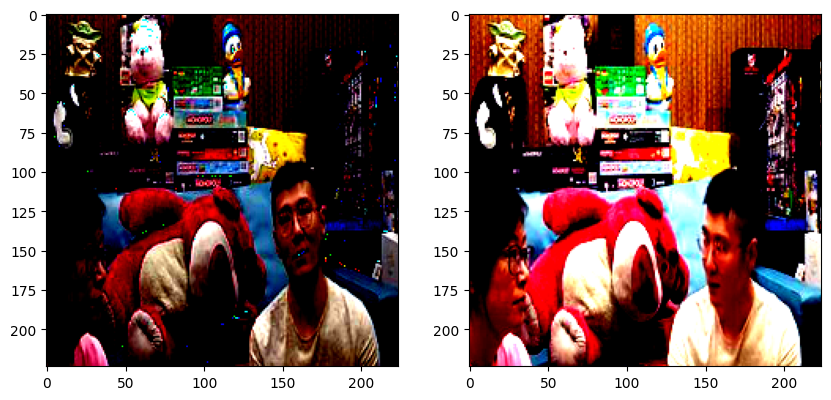

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


其实过了那个村就没那个店了, 没错, 这种行业, 这种行业就是所谓的叫做起了规模以后, 那规模效应太独特, 以至于你很, 你很难想象有第二家公司能起同样的规模, 这就不现实, 他跟Facebook不一样, 你说Facebook做起来了,<Pre_Context>我可以有个TikTok,<Post_Context>嗯, 抖音可以做起来, 因为本身他的编辑成本很低很低, 所以可以, 但这种公司不一样, 他成本是很高的, 他很难去复制他的这个, 本质上他是一个重资产, 对, 他就是重资产,
label: 0


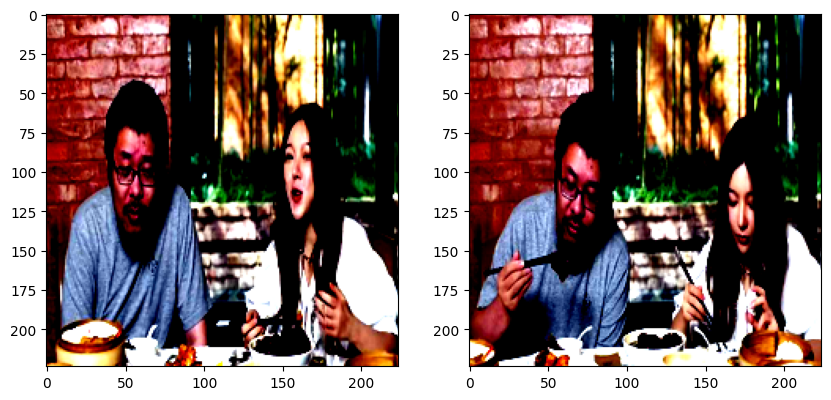

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


 ♪♪  ♪♪  ♪♪  ♪♪  ♪♪  ♪♪  ♪♪  ♪♪  ♪♪  ♪♪<Pre_Context> ♪♪<Post_Context> ♪♪  ♪♪  ♪♪  ♪♪  ♪♪  ♪♪  ♪♪  ♪♪  ♪♪  ♪♪
label: 1


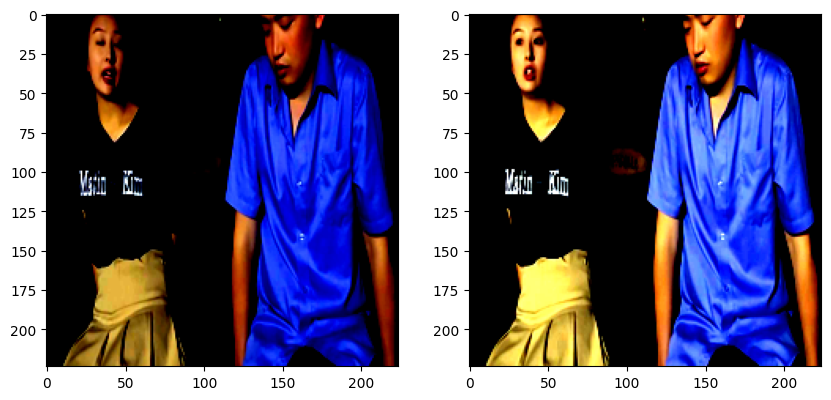

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


你看不然我現在就做 你看我做了也有一年多了嘛 如果是我想把自媒體 做大做強的話 那如果按照我現在這個狀態 我肯定早就不幹了唄 我是覺得在裡面能夠 學到很多東西嘛 然後再加上 因為要被考<Pre_Context>然後我又不想去太遠的地方<Post_Context>去太遠的話 像你上班什麼 就是時間就會沒有那麼多 然後呢 還有一個就是 我奶奶不是在家嗎 很多人說我 就是說我 反正都是在這個山裡面拍 為什麼不為自己的老家拍呢
label: 0


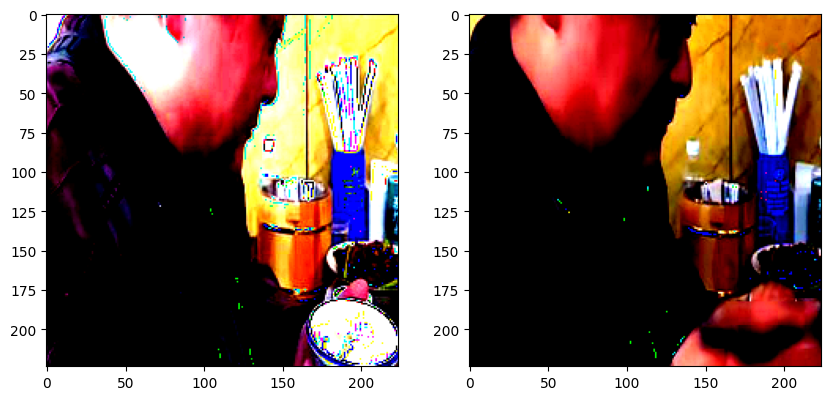

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


这湖南烧烤肉 对 这个味道特别香 这个是基本上吃的必点 朋友们 这是第一次吃那个正宗的湖南菜 但是在我印象中 都是那种 特别辣 但是可以吃<Pre_Context>香辣香辣的<Post_Context>特别特别下饭 我疫情那会儿 当时不是在街 在恒大困了俩月 就是不让出去 我吃咱们自个儿做的菜 然后都没味 就是吃自个儿家里人做的菜 都没味 都习惯了
label: 0


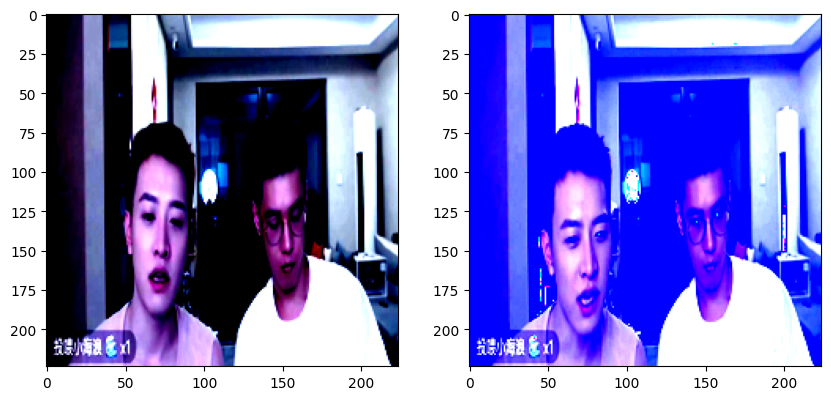

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


说你玻璃体浑浊 而且之前他用激光补过眼角膜 就是比较危险 然后他说你这个眼睛 千万不能受到重击 一旦受到重击 很有可能 就是你玻璃体带着眼角膜 一块就滑落 就是瞎了<Pre_Context>你说多危险<Post_Context>你说之前打排球多危险 你说打排球那个力道 其实还是挺重的 那个排球如果砸到了 真的 你说真的非常危险 你说一下要砸到那个眼睛 真有可能砸瞎了 我就跟我妈说 我妈就是
label: 0


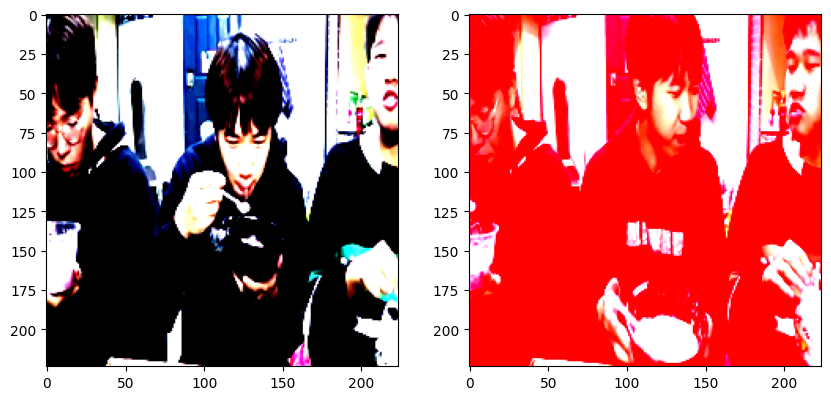

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


又亲情推荐了 那我亲情推荐 那是什么 忘记了 有可能的什么的 有可能的又啊 你唱一遍吧 忘了怎么唱了 哪有人 哪有人录视频唱歌的呀<Pre_Context>吞出来吧<Post_Context>既然没有人 你就要做第一人 是吧 嗯 哎 你让他吐口盖子 哈哈哈 这什么木瓜 木瓜好难吃啊 木瓜很难吃吗
label: 0


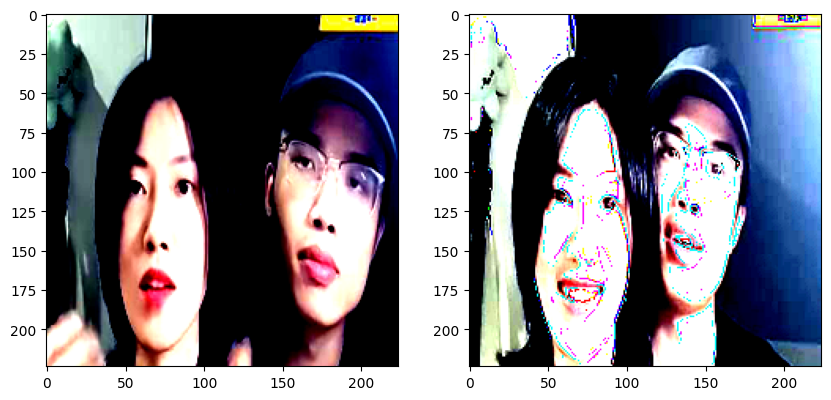

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


在有很多消费主义会把美定义为你身上有很多那种logo名牌你可能把头发搞得特别好有很多护肤品或者是整形怎么样的它会有一个既定的标准让你觉得那个是美的但其实可能我自己会认为<Pre_Context>就是从精神层面由内而外散发出来的那种气质会让你觉得这个人好美他会有内而外的自信 阳光 开朗你说是女王自信放光芒像海青那种就很自信你是我的神男生面子最重要我觉得他好像不是这个谎言是在于比如很多时候你去外面的餐馆吃饭有的东西嫌贵了可能觉得就没必要买了有的男的就会成为 我指的是很多男生他有种逞强的心态感觉自己的消费跟自己的经济水平不太相符合那你会选择逞强还是说就算了我肯定不会选择逞强什么样的资金过什么样的生活所以说你会在德物上买鞋吗那要看德物的鞋的价位是什么样子的吗<Post_Context>4位数的4位数怎么样4位数1000也是4位数9999也4位数你指的是什么4位数南括99块99我会买你可以去听多多听多多女生有情绪只会说没事那倒不至于我觉得这个东西完全是
label: 1


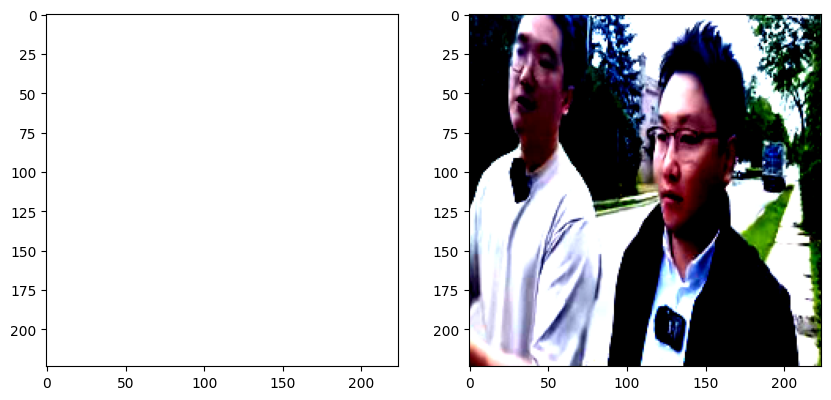

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


就多大 Roteman 學 MMA 當時的感受如何呢 MMA 其實是一個商和禮 combine 在一起的一個 master program 所以它就會有一些 MBA 的課程 它也會有一些比較偏理工科的課程 統計 概率論 machine learning 這些課程也會在 MMA 下面 那麼我作為一個理工科<Pre_Context>其實我對於這些理工背景的課程<Post_Context>我是完全可以 handle 的 我覺得難度沒有那麼高 但是我作為一個理科生 我的商業的 sense 還不是 在當時還不是那麼高 所以 MBA 的這些課程真的 我覺得對我是有一定的難度 但是當你把這些課程吃下來之後 我覺得對我還是有一個很大的 提升
label: 0


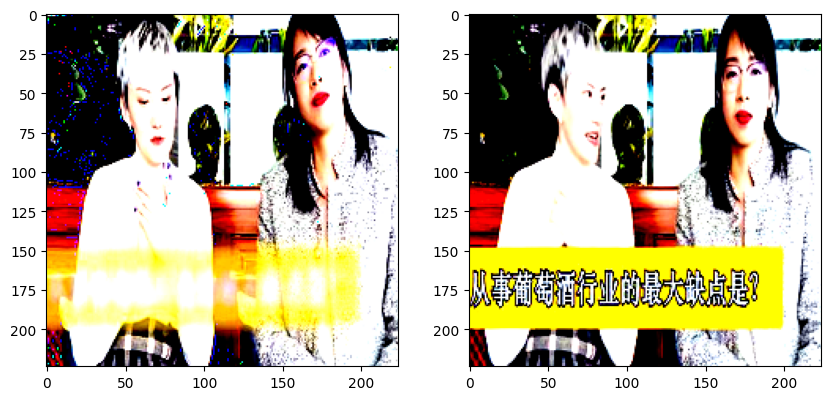

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


都可以考虑一下 把这个做成自己的一个职业 或者一部分职业 可以尝试一下 对 可以上上课学习学习 我们了解了你的职业了解了一点 要不要跟我们分享一下 如果说让你用一个点去总结 你现在这个工作最好的优点<Pre_Context>最大的缺点<Post_Context>会是什么 葡萄酒作为一个职业的话 等于说你就选择了一种生活方式 就是你要不断不断的学习 因为这个世界一直也不断在一爆 然后也不断有新的变化 身边会有一帮非常纯粹的朋友 大家真的是因为爱酒才聚在一起的 工作中我会跟很多进口商 不管是刚刚入这个行业
label: 0


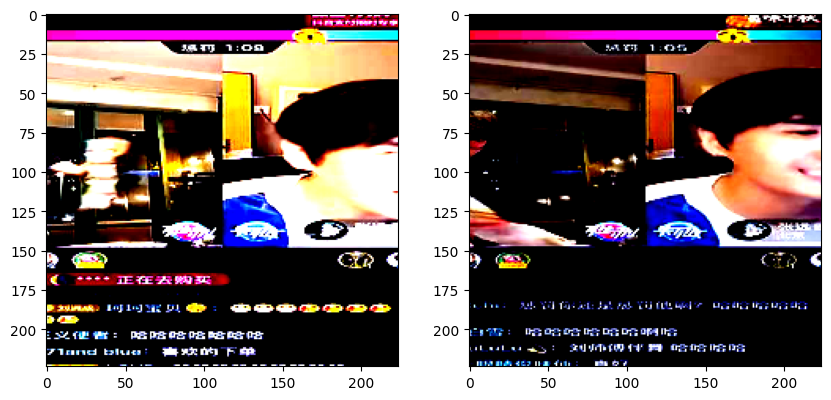

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


谁说你有女朋友的 张伟单身 像我这种不红的人才怎么交女朋友 来给他带来一首新贵妃醉酒 来 哎你不能害羞 你得做出来 公子有你 你们 是你给我的礼物<Pre_Context>一起去办轮回为你歌舞<Post_Context>千本关是你对于我深深的思念 马尾破侠愿为真爱浑身活跃 有请 三个点 爱恨解忧在一瞬间 举杯对月清思甜 爱恨茫茫春节何时 菊花太多云云 心知我爱心传 醉在君王怀 梦回到堂岸
label: 0


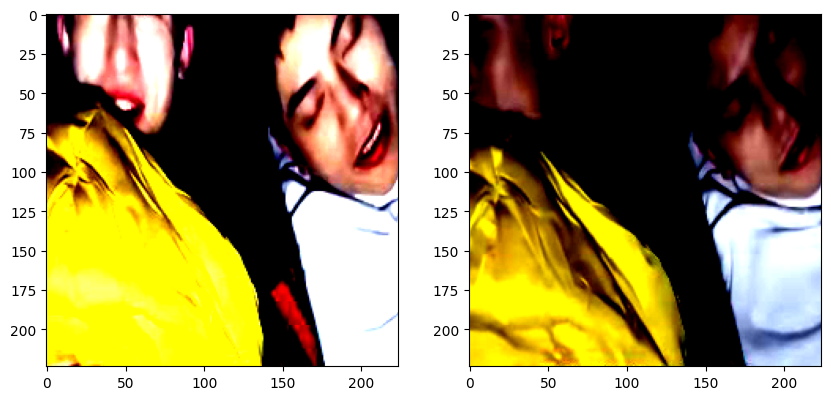

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


这应该是我 2022年 拍的最惨的一个视频了 啥也不说了 都在奶里了 睡觉睡觉睡觉 兄弟 我不知道为什么 今天睡帐篷里也这么爽 现在老宿<Pre_Context>其实虽然说我们是第一次<Post_Context>但是我感觉还挺不错的 咱明天的安排就是 开开日出 咱早起开日出 嗨Siri 5点半叫我 记得清晨5点30分闹钟 已经打开 灯光了 晚安
label: 0


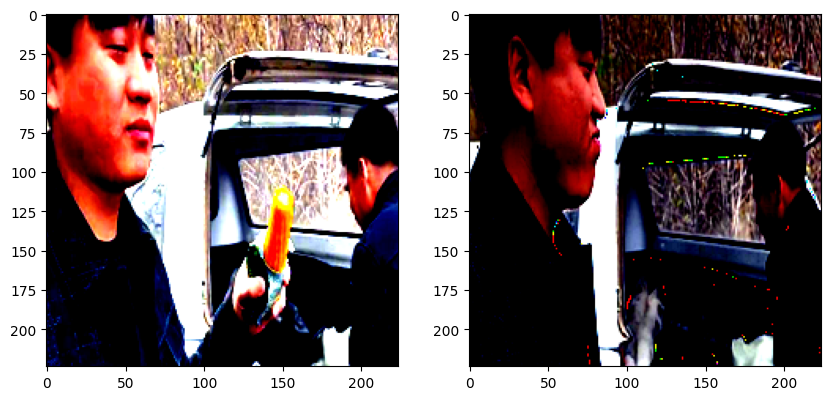

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


就直接就放绳子 第一场他们一点压力没有 我们换第二场 今天我赢定了 我们又到了下一个地方了 还是之前我们整鱼在这 看看我这次他们要用钓的 跟我比 我用巨龙抓鱼 看谁能抓到<Pre_Context>都没人跟你一伙<Post_Context>我需要跟你们一伙吗 我跟你一伙 我挑战你们一把 人家都不需要 我跟你一伙 再拿一个 好 全拿一个 这不能两个 是
label: 1


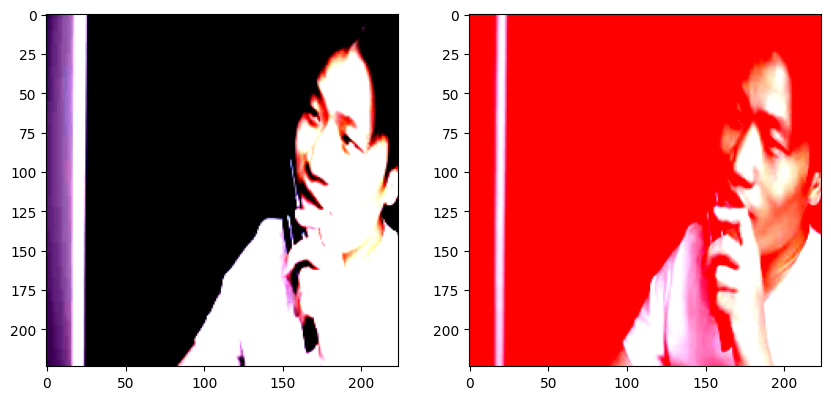

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


对吧 你这才能体现出一个高端CS的老玩家的实力 是不是这个道理 一会就看你翻车了 而且稳定30帧够了 打任何人都够了 咱们公司的 我问一下看谁会打CS 咱们公司谁CS打得比较好 CSGO<Pre_Context>AK你是又准备上网玩游戏吗<Post_Context>你都多久没出片子了 这个是工作需求 我们要拍个片子 那这样吧 我陪你打 你打赢我了 你就继续玩 你打不赢的话 那你就去做片子吧 30帧够了
label: 0


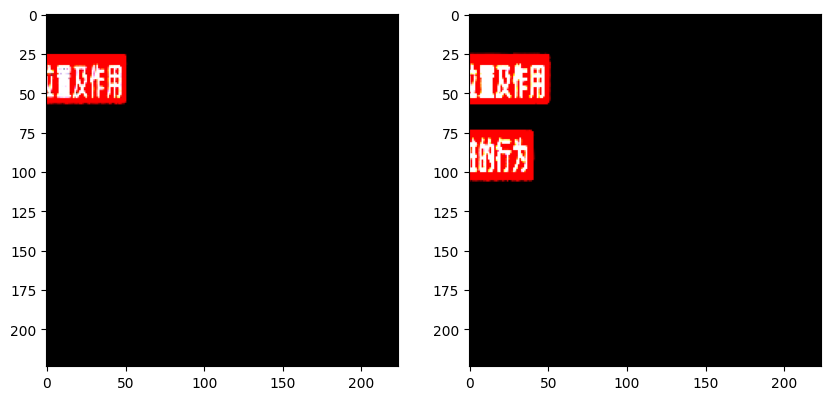

肝膽移外科主治醫師 外科學博士、臨床博士後 呂正呂醫生 來為我們分享 關於肝的重要知識點 或者說幫助大家來看懂你的體檢報告 本期視頻會包含以下五個部分 肝臟的位置及作用 傷害肝臟的行為 體檢中常見的肝臟問題<Pre_Context>及應對措施<Post_Context>肝血管流 肝鈣化造 肝囊腫 脂肪肝 肝臟報警信號 日常防護 呂醫生 在正式開始前呢 我覺得有必要向大家科普一下 我們的肝是在人體中的
label: 0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


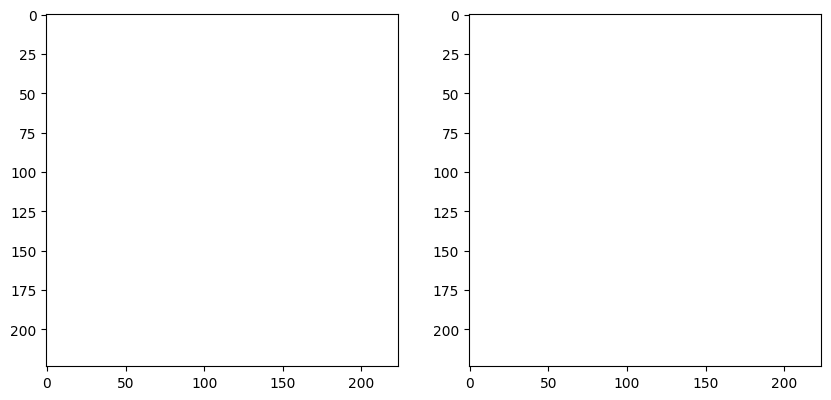

找不到了 哎 可惜了 没有什么可惜的 被我们踩了 没有什么可惜的 这里有水 这里有水 找一下嘛 哎发现了<Pre_Context>有一条<Post_Context>嗯 这什么地方 我想用手试一下 搓手 对了 怎么抓 就这么抓 换车了吧 有 用夹子吧
label: 0


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


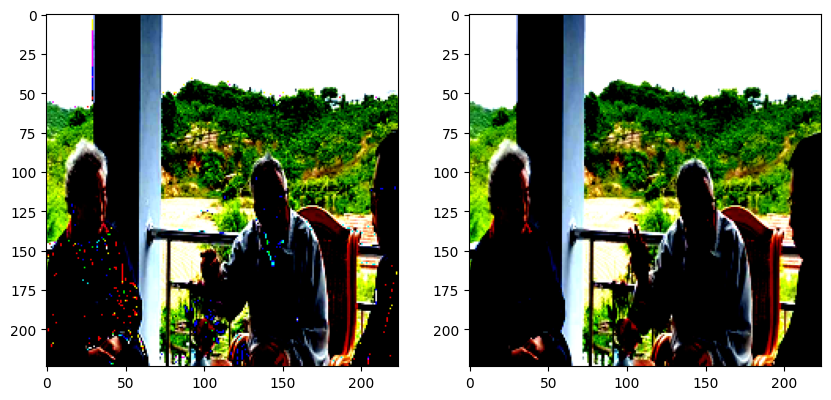

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


叫自治统建对不对 自治统建是给皇帝的 但是他说 我这一生当中 19年 自治统建 还有很多人帮着弄 而我个人弄的 给我们家的 这个要比<Pre_Context>自治统建还要重要<Post_Context>他说他这个温公家范 比自治统建还要重要 还有另外一本书 就是那个 顺简世康 简是简这个字 来教育 给我的儿子司马康看 这是两个东西 这两个都属于家庭范围
label: 0


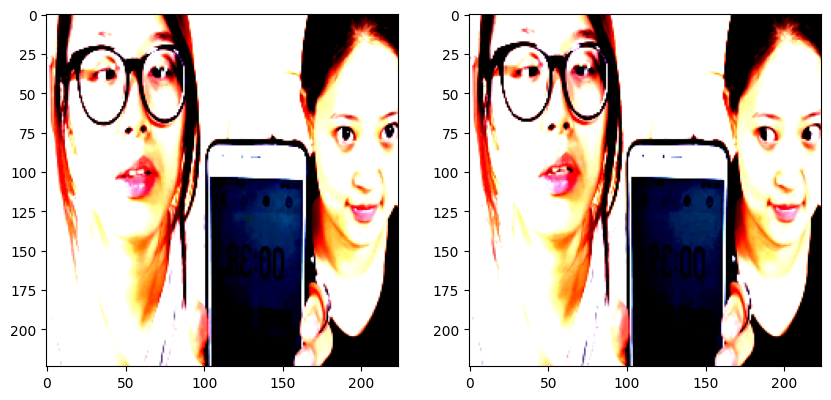

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


大家一起来 我眼睛小 可能会有一些优势 你咋不说话 没时间 好像不能长时间盯着自己看 越看越丑 坚持不住的时候 转眼睛好像是会好很多 我转一转<Pre_Context>斗劲也不错<Post_Context>算了 反正回不来了 睡觉 不想看你 看你要笑 眼睛有点发酸了 晚上看我俩还挺吓人 就干瞪着不说话 说点话 别让大家害怕
label: 0


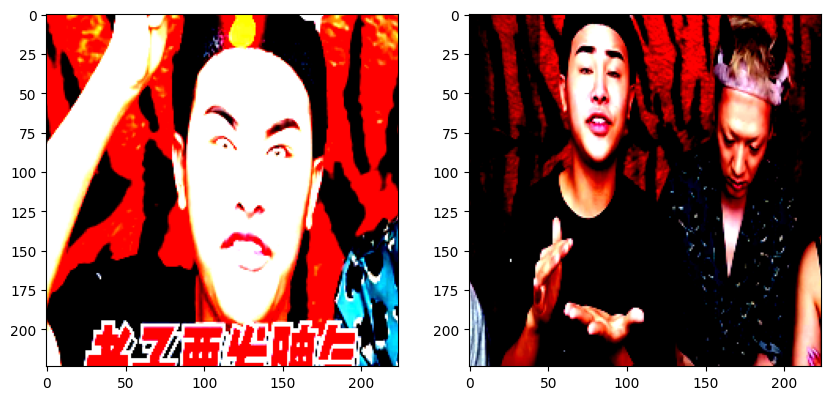

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


所以說它比較貴 但是很多人總是把這個Logo 拿來掛在自己的身上 掛在好不好用這個點上 好不好用 好不好穿 夠不夠體現自己的個人價值 你們說到Logo這一點 我要在這裡 向我所有的有一些粉絲 Logia發脾氣<Pre_Context>就是我之前就是分享了一期<Post_Context>我去花多少多少錢 買什麼奢侈品的那一期 當我那一天是第一次 在我的視頻裡面 出現那麼大金額的東西 就開始有粉絲來酸了 這一萬多不值 我在兩元店能買到一樣的 我又覺得每個人對於消費 那只是說的是一個
label: 1


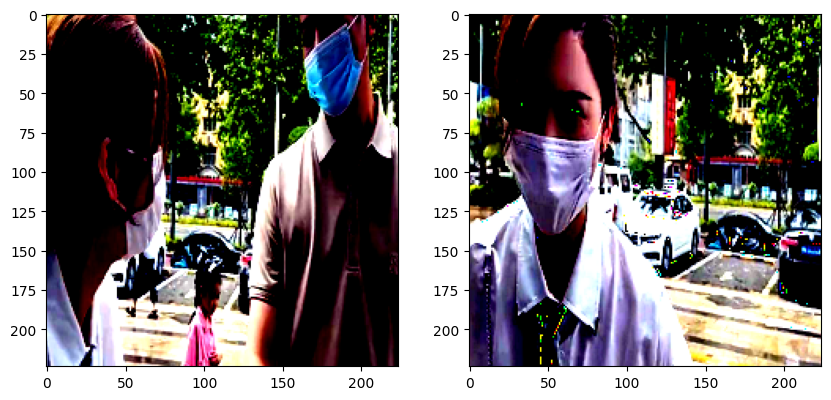

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


你这得上个 哈哈哈哈哈哈 哈哈哈哈 我收拾捡用啊 你这家伙都是老婆拍的正好多 这钱就是你老婆发的 大哥到这多少 到这10万 一人一把正好 哈哈哈哈<Pre_Context>哈哈哈哈<Post_Context>你的果子剩我一半 我的果子也剩你一半 好好好 哎呀啊小褲子 大褲 哎呀哈哈哎呀 哈哈哈哈 这几天没见盘子了 抱一下快 我这还拿着干嘛抱我跟你
label: 0


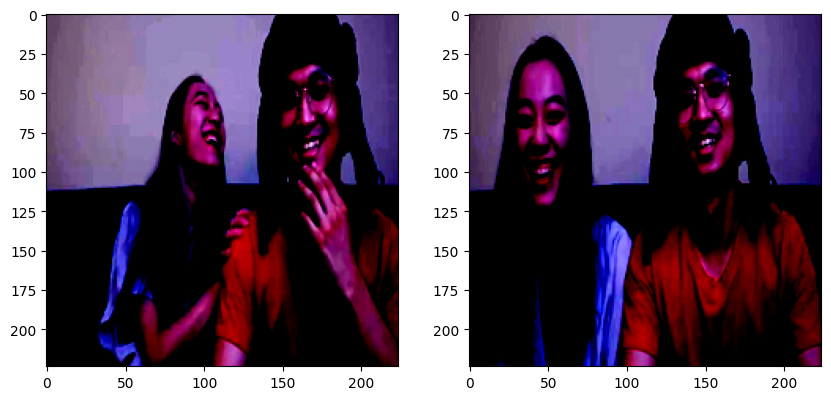

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


我最想学的就是伏地魔的那个 因为讲哈利波特文学 这个是有另外一节课 所以这节课是专门教人魔法的 上这节课老师的心理压力会不会很大 就是学生一生气你教的不好 然后就一个阿瓦拉所命令 那么下一个课叫music of the beatles beatles 哈哈哈哈<Pre_Context>beatles<Post_Context>不合乎本 大概就是beatles的音乐欣赏吧应该是 我觉得这个相对于别的还是比较正常一点 音乐鉴赏就是beatles的歌迷可能 会很感兴趣这节课 所以我觉得这节课还是2000years later 而且非常适合想选水课的同学 大家没有一节比听音乐更水的课了 但是很多听乐老师会叫你们写 那个无后感听后感
label: 1


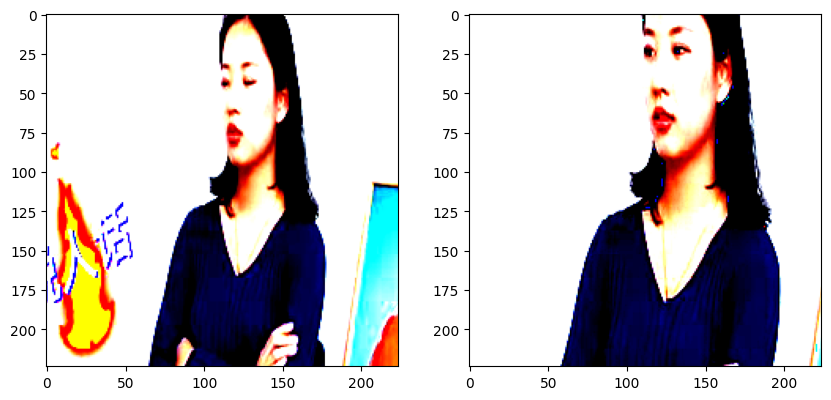

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


我们去年做了个项目 今年真的好得鸭皮 Fantastic 了总 失陆 我跟你说啊 我今天我们投合合项目整理 发现好大个变化 so big 我们去年投了澎湖啊 今年感觉还可以哦<Pre_Context>说人话<Post_Context>首先啊 澎湖它现在是切入了特高压领域 帮电力电厂做柔性检测 而且再加上我们现在 中国的特高压 不管是在技术还是规模 都已经到了全世界领先的水平 这个市场变化我们得把握住啊 我们投资呢就需要投变化 刚听完你讲的
label: 0


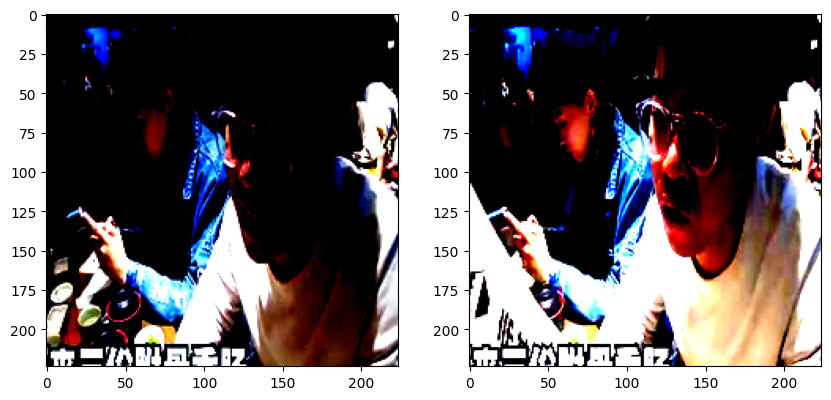

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


来来来 哇操 你好 给点菜 那个帝王满烧的牛肉丼 两个大份 龙虾丼 鳗鱼丼 试验三顶丼 要一个火山<Pre_Context>再来三份复古香肠<Post_Context>您可以尝一下我们家的蟹堡 蟹堡是吧 这一份是一个 对 一人一个 好 谢谢 哇操全是肉 饭在哪呢 这叫什么 帝王满烧牛肉丼
label: 0


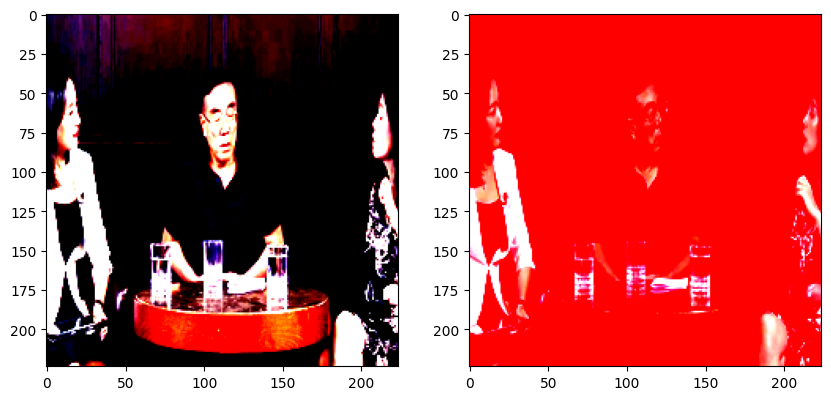

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


儲蓄 對不對 否則的話銀行 中小銀行全面臨這樣的風險 而且我補充一下 包括剛才劉老師談到的 你比如說在中美這樣的一個背景下 大背景下 其實本身你看咱們的產業 現在也進行轉型升級<Pre_Context>也就是過去你勞動密集型<Post_Context>現在你是技術密集型 資本密集型 所以說你如果要進行進一步的產業升級的話 你資本密集型怎麼來進行融資 你資本市場 然後包括你這個金融市場 怎麼能運作得好 其實是非常關鍵的 咱們雖然就是不要過度的什麼經濟金融化 對吧
label: 0


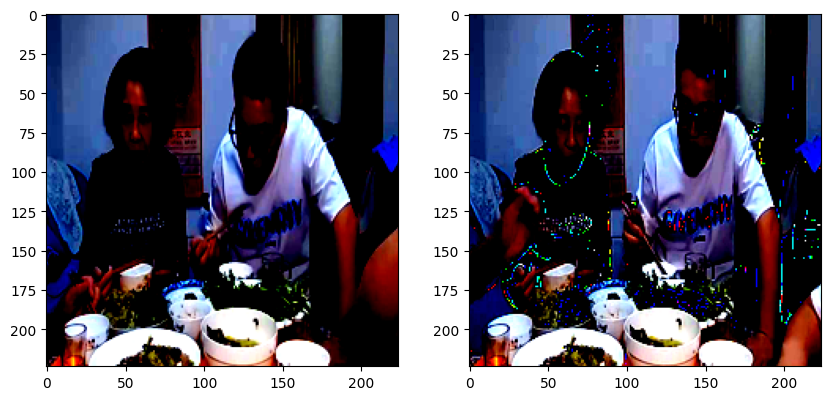

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


你刚刚因为干活 这是 不干活 因为不输体力 你说你消耗不能小 你说你吃 这锅不丢 这月数能要吗 能 我还能要吗<Pre_Context>火候真高<Post_Context>能 体格都跟这一样 像大叔 胖子 牛郎 减肥不吃饭 他一天干可多活了 活可重了 不吃饭能减肥 活可多了
label: 0


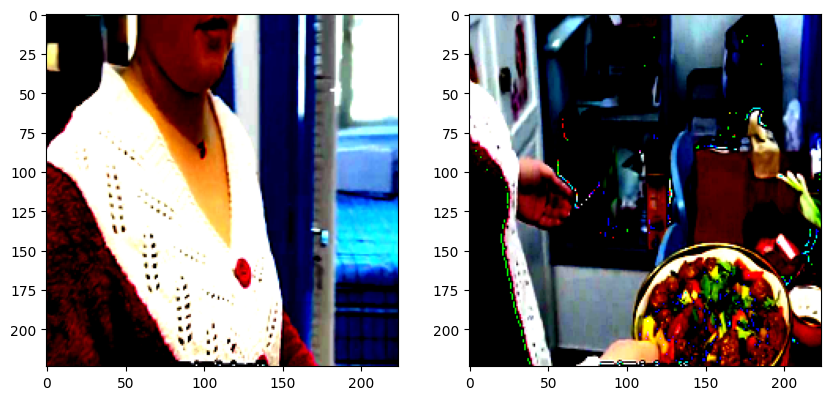

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


不是 人家是小体重的人 才真正爱不管事 要按说大体重的人应该管事 但是不管事 就是说说明你只要吃东西不管事 今天如果我再吃主食 然后晚餐不吃 明天早上还不吊床 我就继续啥也不吃<Pre_Context>刚到家<Post_Context>来一个溜丸子 这你吃不了啊 媳妇 我不吃 我连尝一口 我都忘了我都吐了 你问大姐 真够坚持的 来一酱牛肉 鸡腿
label: 0


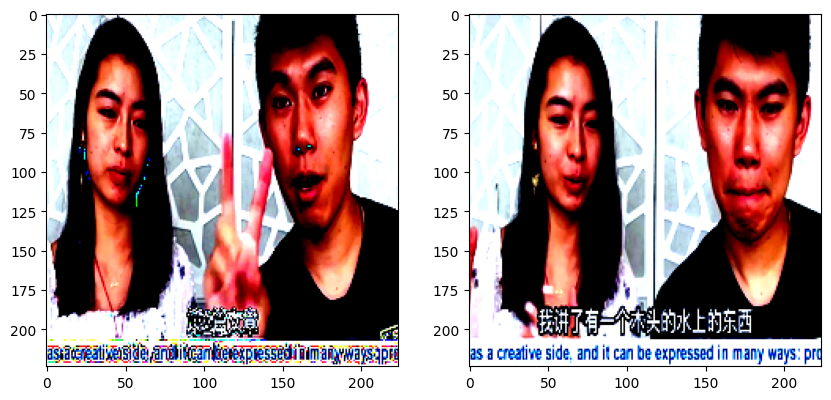

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


这第一篇文章是讲 我主动去帮别的学生 提高他们数学能力 美国呢 他不光想知道你多厉害 他想看到你用你的厉害怎么帮别人 所以在这个里面呢 我就给很多例子 就是说我怎么教他们啊 我主动做了什么活动<Pre_Context>第二篇文章<Post_Context>我讲了有一个木头的水上的东西 木头的码头 有个木头的码头 后面有很漂亮的水 然后有一副眼镜 为什么讲这样呢 就说嗯 这是我最喜欢的照片 我照的这个照片呢 是在那个Promise的数学的项铃营照的
label: 0


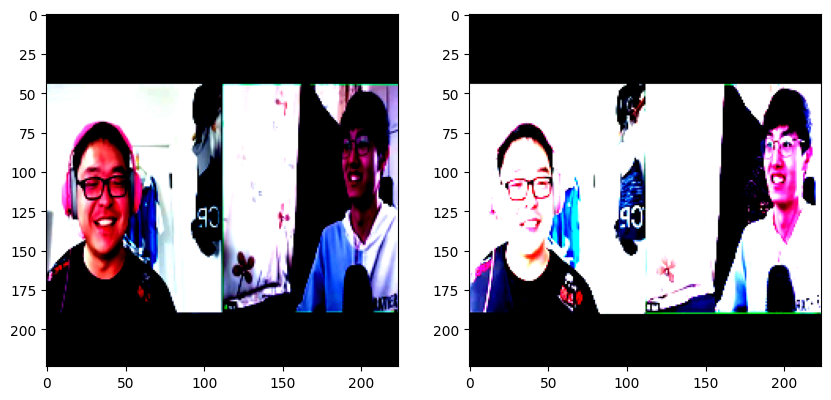

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


能介绍一下你做这个网站吗 如果需要演示的话 可以共享一下屏幕 其实这个话题还有点敏感 因为我被攻击的不是这个网站 是另外一个网站 这个网站暂时还没怎么被人盯上 但是大树的老师你这么一说的话 我估计可能有点危险了 这个网站也估计这个网站可能也有点危险了<Pre_Context>要不屏幕分享一下<Post_Context>可以好 这个就是我去年做的一个编程资源网站 然后各位小伙伴们可以在这里去根据你的需求 然后选择不同方向的编程资源 比如说你是学Java的 就可以选择Java的标签 然后就能够看到很多和Java相关的学习资料 然后一些网站一些项目之类的 因为这个网站本身就是我自己的一个需求 我平时可能比较喜欢收集一些和自己职业
label: 0


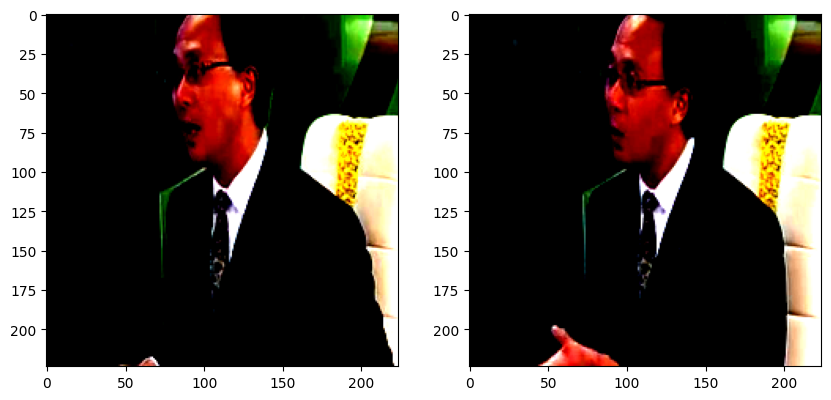

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


那麼中國方面可以考慮恢復一些高層的對話 因為我們知道明年就是中日聯合聲明 以及中日邦交很多年的日子了 一個35年 一個30年 所以在這個時候中日的高層對話應該恢復 但是是有前提條件的 就是下一任日本領導人不應該參拜晉國神社 所以一方面從現在開始要做好高層往來的準備 但是前提條件也是要設在那裡 所以我覺得如果以一手軟一手硬的政策去推行的話<Pre_Context>我想可能在目前日本民意的發酵的關鍵時刻<Post_Context>會起到一定的作用 對 提到中日關係 昨天我們鳳凰衛視的資訊台直播的中日辯論會 還是非常的精彩 您跟日本方面的政論家有交鋒 在這裡再預告一下 在這個星期六的上午10點10分和晚上的11點45分 還會重播這個中日辯論會 大家可以留意一下 好 今天談到這
label: 0


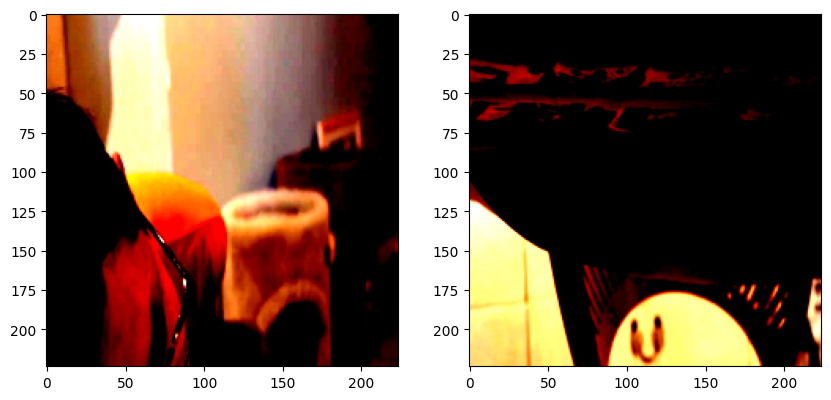

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


对对对 这些椅子是怎么都是哪来的 都是什么 这个是都两个都是中古的椅子 因为我们想说家里不同风格就有点变化嘛 就不需要很统一 而且我们家就一般就三个人吃饭 所以就这样的椅子的搭配就已经够用 就没有那种一桌四椅的那种配套的那个 今天其实我做了一个收纳<Pre_Context>就会想到<Post_Context>这边做一个主卧 这有个机关 其实它就是用一根那个伸缩的一个双连杆 对 然后就把纸巾放在这边 因为有小孩的家庭那个纸巾消耗特别快 它把放在这边还蛮方便拿取的 一开始的时候我们这边是没有柜子的 但是后来我们觉得想打造一种就是一个餐饮区的一种感觉 就把柜子挪过来这边做一个L型的一个餐饮区
label: 1


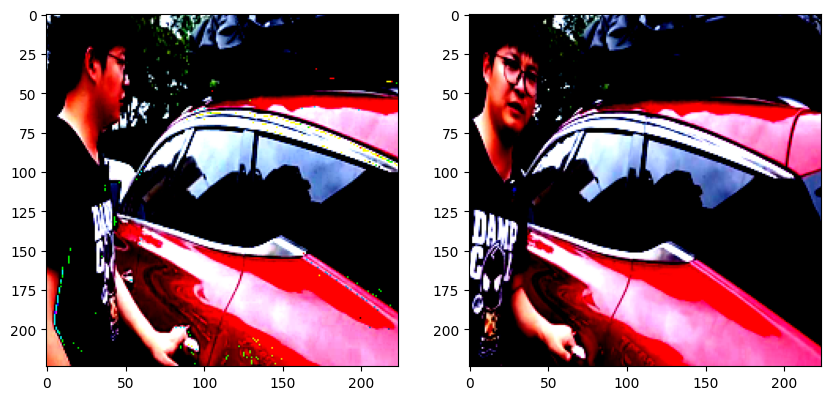

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


就是可以过滤水的 其他这些东西没怎么改变 然后就是这个 两个座位之间有一个空隙 就放了很多工具那些 其实很多东西都可以放在里面去 空间还蛮大的 其实上次车里面塞的东西有点多 这次全部放在行李包里面 又优化了一下<Pre_Context>估计这次出去跑一趟<Post_Context>又能再优化一下 这个位置就还有这么宽一个位置 都可以放一个那种大箱子 因为这个行李包我是往后面移来的 其实还可以往前面 再放个大概10厘米多 但是这个没想好用什么箱子 然后这后面全是空的 都是空的 这个平台也装得好
label: 0


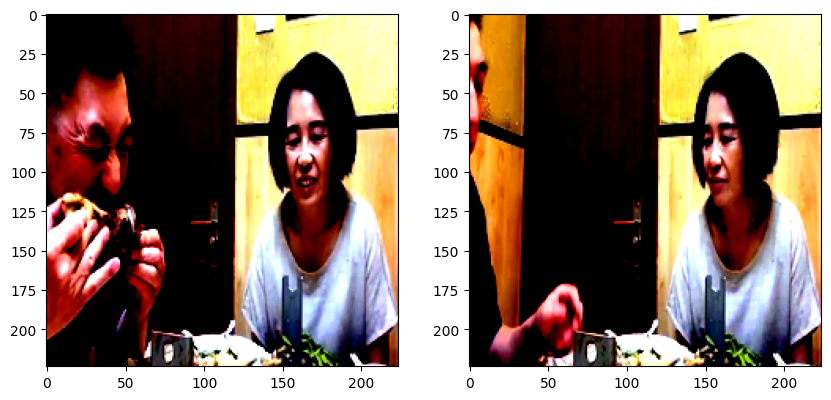

就来两瓶 喝 这家的挺凉的 你来给你妈喝吗 这个挺好吃 你不倒杯里 喝酒 好玩吗 这杯是小的 你不请人家吗<Pre_Context>请人家您就倒个杯<Post_Context>花钱请别怕人家吃 说你别花钱 那我去解除你随便 明天您请我随便吃 等你孙子要是来的话你请 等我孙子来的时候我请去 人家不罚一千二了 那你不知道吗 人家不就罚三百去了吗 我不是罚三百
label: 1


In [28]:
for batch in test_data_loader:
    show_a_batch(batch)
    break

In [10]:
# run this chunk when training
# parameters
train_batch_size = 512
eval_batch_size = 512
num_epoch = 100
custom_lr = 0.0002
# original 0.0001

# load model
my_nvlr_model = NLVRModel(config=config)
my_nvlr_model.load_pretrained('data/cclm_4m_epoch_29.th', config,  ## need to match 3m or 4m
                              load_nlvr_pretrain= False, is_eval=False) # load_nlvr_pretrain= False because current checkpoint is CCLM model

tokenizer = AutoTokenizer.from_pretrained('xlm-roberta-large')
tokenizer.add_special_tokens({'bos_token': tokenizer.cls_token, 'eos_token': tokenizer.sep_token})

# training parameters 
world_size = utils.get_world_size()

arg_opt = utils.AttrDict(config['optimizer'])
arg_opt['lr'] = custom_lr
optimizer = create_optimizer(arg_opt, my_nvlr_model)
arg_sche = utils.AttrDict(config['schedular'])
arg_sche['step_per_epoch'] = math.ceil(len(train_dataset)/(train_batch_size*world_size))
lr_scheduler = create_scheduler(arg_sche, optimizer)
log = []
my_nvlr_model = nn.DataParallel(my_nvlr_model)
my_nvlr_model.to(device)

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


### Loading pretrained vision encoder
### Loading pretrained text encoder
load_nlvr_pretrain,  False
load checkpoint from data/cclm_4m_epoch_29.th
missing_keys:  ['cls_head.0.weight', 'cls_head.0.bias', 'cls_head.1.weight', 'cls_head.1.bias', 'cls_head.3.weight', 'cls_head.3.bias']
unexpected_keys:  ['temp', 'text_proj.weight', 'text_proj.bias', 'vision_proj.weight', 'vision_proj.bias', 'itm_head.0.weight', 'itm_head.0.bias', 'itm_head.1.weight', 'itm_head.1.bias', 'itm_head.3.weight', 'itm_head.3.bias', 'bbox_head.0.weight', 'bbox_head.0.bias', 'bbox_head.1.weight', 'bbox_head.1.bias', 'bbox_head.3.weight', 'bbox_head.3.bias', 'text_encoder.cls.predictions.bias', 'text_encoder.cls.predictions.transform.dense.weight', 'text_encoder.cls.predictions.transform.dense.bias', 'text_encoder.cls.predictions.transform.LayerNorm.weight', 'text_encoder.cls.predictions.transform.LayerNorm.bias', 'text_encoder.cls.predictions.decoder.weight', 'text_encoder.cls.predictions.decoder.bias']
### lr_mult

/home/kh3074/anaconda3/lib/python3.10/site-packages/transformers/optimization.py:391: FutureWarning: This implementation of AdamW is deprecated and will be removed in a future version. Use the PyTorch implementation torch.optim.AdamW instead, or set `no_deprecation_warning=True` to disable this warning
  warnings.warn(


DataParallel(
  (module): NLVRModel(
    (vision_encoder): SwinTransformer(
      (patch_embed): PatchEmbed(
        (proj): Conv2d(3, 128, kernel_size=(4, 4), stride=(4, 4))
        (norm): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
      )
      (pos_drop): Dropout(p=0.0, inplace=False)
      (layers): ModuleList(
        (0): BasicLayer(
          dim=128, input_resolution=(56, 56), depth=2
          (blocks): ModuleList(
            (0): SwinTransformerBlock(
              dim=128, input_resolution=(56, 56), num_heads=4, window_size=7, shift_size=0, mlp_ratio=4.0
              (norm1): LayerNorm((128,), eps=1e-05, elementwise_affine=True)
              (attn): WindowAttention(
                dim=128, window_size=(7, 7), num_heads=4
                (qkv): Linear(in_features=128, out_features=384, bias=True)
                (attn_drop): Dropout(p=0.0, inplace=False)
                (proj): Linear(in_features=128, out_features=128, bias=True)
                (proj_drop): D

Start training!!


/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [0] [ 0/14]  eta: 0:05:00  lr: 0.000000  loss: 0.6992  time: 21.4963  data: 15.9794  max mem: 14737
Train Epoch: [0] [ 6/14]  eta: 0:00:45  lr: 0.000001  loss: 0.7041  time: 5.7149  data: 2.6470  max mem: 14769
Train Epoch: [0] [12/14]  eta: 0:00:09  lr: 0.000001  loss: 0.7161  time: 4.8443  data: 1.9401  max mem: 14769
Train Epoch: [0] [13/14]  eta: 0:00:04  lr: 0.000001  loss: 0.6978  time: 4.6395  data: 1.8017  max mem: 14769
Train Epoch: [0] Total time: 0:01:04 (4.6399 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.7002e_eval_time_per_batch: 14.1301


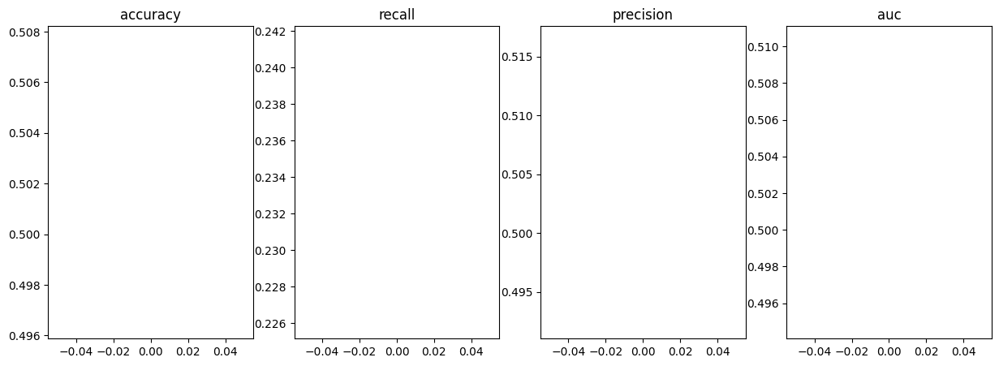

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [1] [ 0/14]  eta: 0:04:31  lr: 0.000001  loss: 0.7021  time: 19.3977  data: 16.1310  max mem: 15188
Train Epoch: [1] [ 6/14]  eta: 0:00:45  lr: 0.000002  loss: 0.7023  time: 5.6792  data: 2.8441  max mem: 15188
Train Epoch: [1] [12/14]  eta: 0:00:10  lr: 0.000002  loss: 0.7071  time: 5.0808  data: 2.3603  max mem: 15188
Train Epoch: [1] [13/14]  eta: 0:00:04  lr: 0.000002  loss: 0.6942  time: 4.8453  data: 2.1917  max mem: 15188
Train Epoch: [1] Total time: 0:01:07 (4.8457 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6993e_eval_time_per_batch: 14.6029


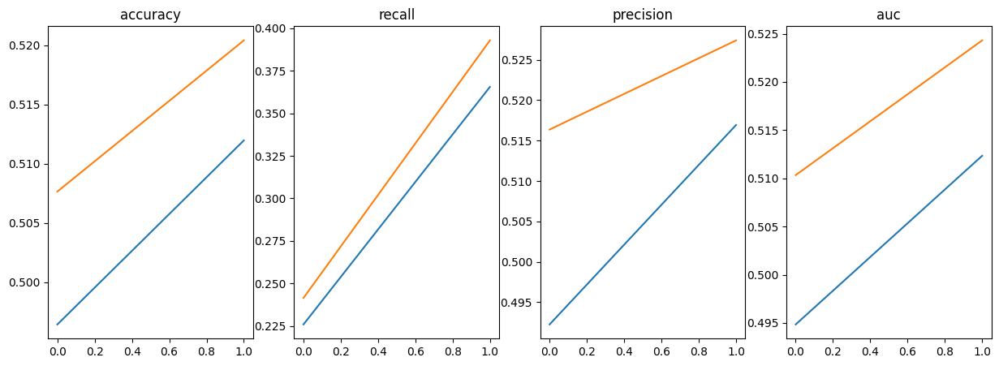

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [2] [ 0/14]  eta: 0:06:26  lr: 0.000002  loss: 0.6933  time: 27.6115  data: 25.0339  max mem: 15188
Train Epoch: [2] [ 6/14]  eta: 0:01:04  lr: 0.000003  loss: 0.6993  time: 8.0704  data: 5.3870  max mem: 15188
Train Epoch: [2] [12/14]  eta: 0:00:14  lr: 0.000003  loss: 0.6839  time: 7.1938  data: 4.4453  max mem: 15188
Train Epoch: [2] [13/14]  eta: 0:00:06  lr: 0.000003  loss: 0.6938  time: 6.8142  data: 4.1278  max mem: 15188
Train Epoch: [2] Total time: 0:01:35 (6.8146 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6977e_eval_time_per_batch: 15.9535


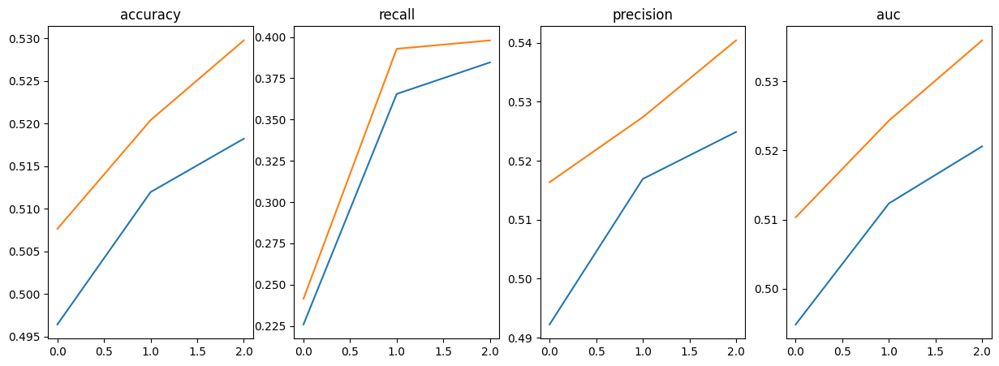

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [3] [ 0/14]  eta: 0:16:30  lr: 0.000003  loss: 0.6983  time: 70.7617  data: 67.4949  max mem: 15188
Train Epoch: [3] [ 6/14]  eta: 0:02:43  lr: 0.000004  loss: 0.6927  time: 20.3887  data: 17.7146  max mem: 15188
Train Epoch: [3] [12/14]  eta: 0:00:36  lr: 0.000004  loss: 0.6926  time: 18.4692  data: 15.8504  max mem: 15188
Train Epoch: [3] [13/14]  eta: 0:00:17  lr: 0.000004  loss: 0.6959  time: 17.3223  data: 14.7183  max mem: 15188
Train Epoch: [3] Total time: 0:04:02 (17.3227 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6962e_eval_time_per_batch: 14.4383


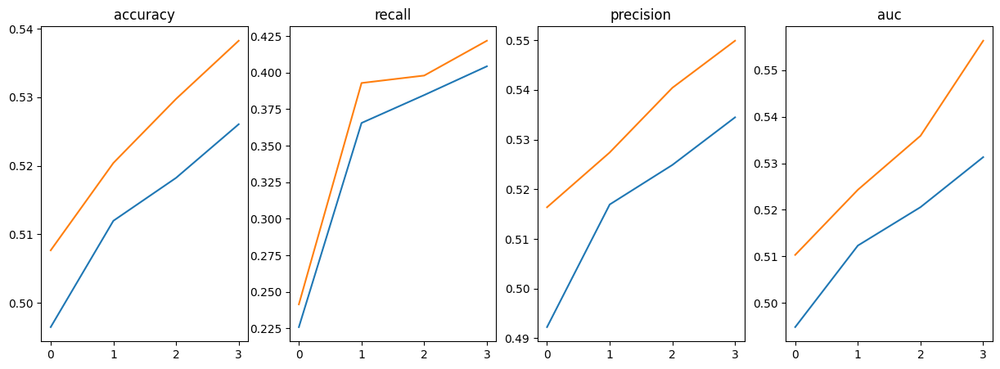

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [4] [ 0/14]  eta: 0:16:12  lr: 0.000005  loss: 0.6956  time: 69.4645  data: 67.0017  max mem: 15188
Train Epoch: [4] [ 6/14]  eta: 0:03:31  lr: 0.000005  loss: 0.6812  time: 26.4810  data: 23.7416  max mem: 15188
Train Epoch: [4] [12/14]  eta: 0:00:57  lr: 0.000006  loss: 0.6887  time: 28.8244  data: 26.1299  max mem: 15188
Train Epoch: [4] [13/14]  eta: 0:00:26  lr: 0.000006  loss: 0.6944  time: 26.9059  data: 24.2635  max mem: 15188
Train Epoch: [4] Total time: 0:06:16 (26.9062 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6946e_eval_time_per_batch: 14.6013


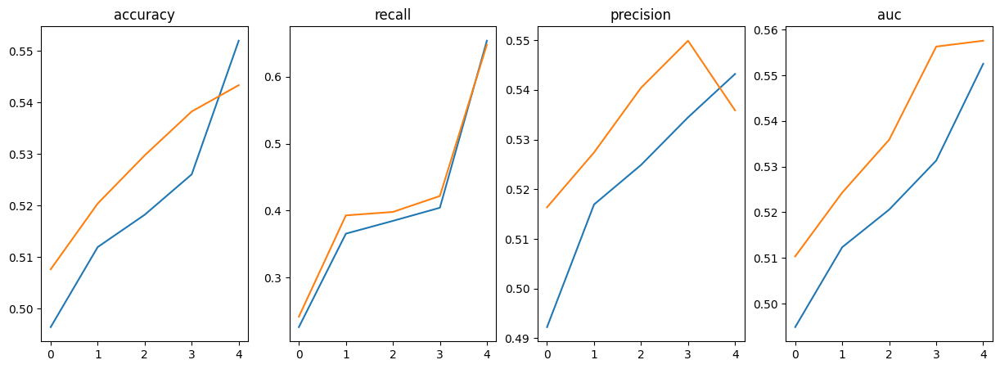

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [5] [ 0/14]  eta: 0:31:19  lr: 0.000006  loss: 0.6893  time: 134.2549  data: 131.7966  max mem: 15188
Train Epoch: [5] [ 6/14]  eta: 0:10:26  lr: 0.000006  loss: 0.6808  time: 78.3411  data: 75.6610  max mem: 15188
Train Epoch: [5] [12/14]  eta: 0:06:05  lr: 0.000007  loss: 0.6761  time: 182.7049  data: 180.0609  max mem: 15188
Train Epoch: [5] [13/14]  eta: 0:02:49  lr: 0.000007  loss: 0.6874  time: 169.8019  data: 167.1995  max mem: 15188
Train Epoch: [5] Total time: 0:39:37 (169.8023 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6931e_eval_time_per_batch: 57.67879


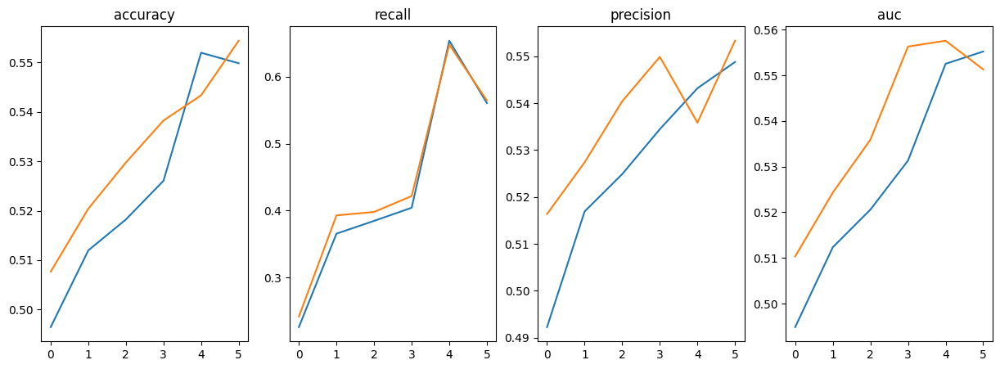

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [6] [ 0/14]  eta: 1:30:59  lr: 0.000007  loss: 0.6894  time: 389.9576  data: 387.4872  max mem: 15188
Train Epoch: [6] [ 6/14]  eta: 0:09:12  lr: 0.000007  loss: 0.6886  time: 69.0716  data: 66.3227  max mem: 15188
Train Epoch: [6] [12/14]  eta: 0:01:25  lr: 0.000008  loss: 0.7007  time: 42.7297  data: 40.1049  max mem: 15188
Train Epoch: [6] [13/14]  eta: 0:00:39  lr: 0.000008  loss: 0.6810  time: 39.8504  data: 37.2405  max mem: 15188
Train Epoch: [6] Total time: 0:09:17 (39.8510 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6923e_eval_time_per_batch: 21.1134


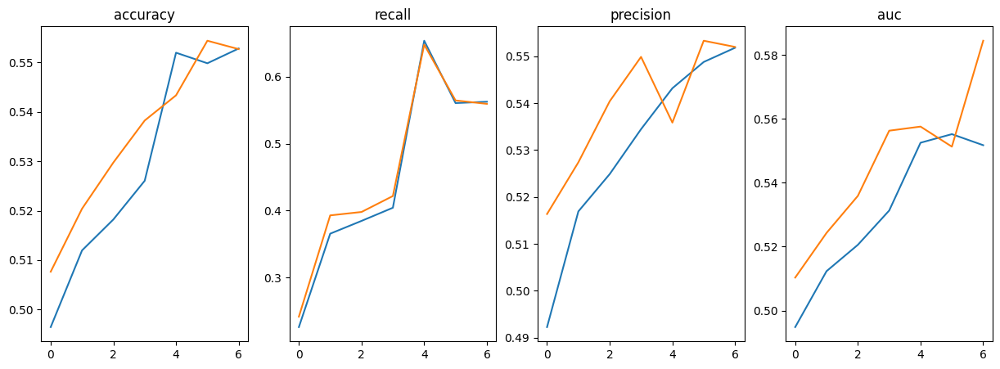

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [7] [ 0/14]  eta: 0:17:31  lr: 0.000008  loss: 0.6722  time: 75.0868  data: 72.4367  max mem: 15188
Train Epoch: [7] [ 6/14]  eta: 0:02:31  lr: 0.000008  loss: 0.6884  time: 18.9651  data: 16.2238  max mem: 15188
Train Epoch: [7] [12/14]  eta: 0:00:31  lr: 0.000009  loss: 0.6810  time: 15.8759  data: 13.1022  max mem: 15188
Train Epoch: [7] [13/14]  eta: 0:00:14  lr: 0.000009  loss: 0.6895  time: 14.8662  data: 12.1663  max mem: 15188
Train Epoch: [7] Total time: 0:03:28 (14.8668 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6911e_eval_time_per_batch: 20.1275


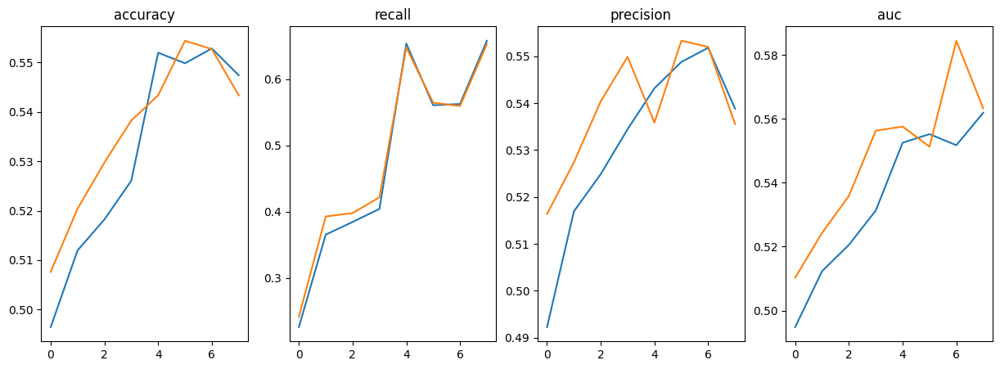

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [8] [ 0/14]  eta: 0:11:40  lr: 0.000009  loss: 0.6883  time: 50.0273  data: 41.5684  max mem: 15188
Train Epoch: [8] [ 6/14]  eta: 0:01:47  lr: 0.000010  loss: 0.6817  time: 13.4816  data: 9.9571  max mem: 15188
Train Epoch: [8] [12/14]  eta: 0:00:24  lr: 0.000010  loss: 0.6831  time: 12.2554  data: 9.1493  max mem: 15188
Train Epoch: [8] [13/14]  eta: 0:00:11  lr: 0.000010  loss: 0.6967  time: 11.5160  data: 8.4958  max mem: 15188
Train Epoch: [8] Total time: 0:02:41 (11.5164 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6903e_eval_time_per_batch: 14.6822


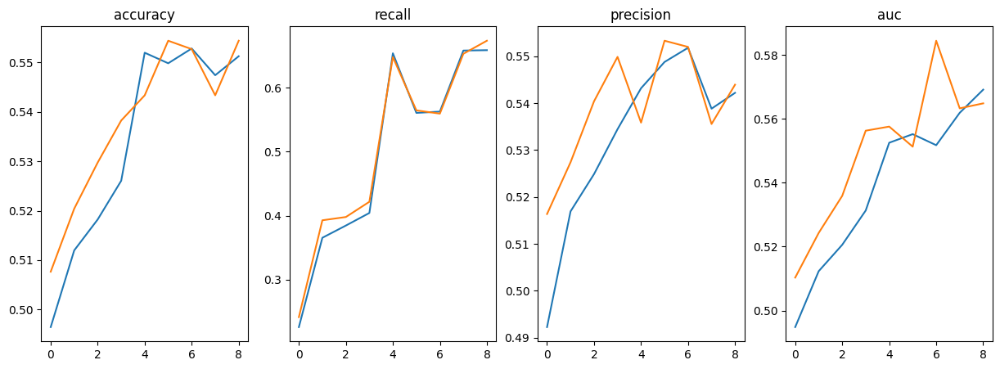

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [9] [ 0/14]  eta: 0:10:56  lr: 0.000010  loss: 0.6869  time: 46.9133  data: 44.2674  max mem: 15188
Train Epoch: [9] [ 6/14]  eta: 0:01:46  lr: 0.000011  loss: 0.6674  time: 13.3365  data: 10.6119  max mem: 15188
Train Epoch: [9] [12/14]  eta: 0:00:24  lr: 0.000011  loss: 0.6844  time: 12.1906  data: 9.5450  max mem: 15188
Train Epoch: [9] [13/14]  eta: 0:00:11  lr: 0.000011  loss: 0.6890  time: 11.4465  data: 8.8632  max mem: 15188
Train Epoch: [9] Total time: 0:02:40 (11.4469 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6895e_eval_time_per_batch: 14.6405


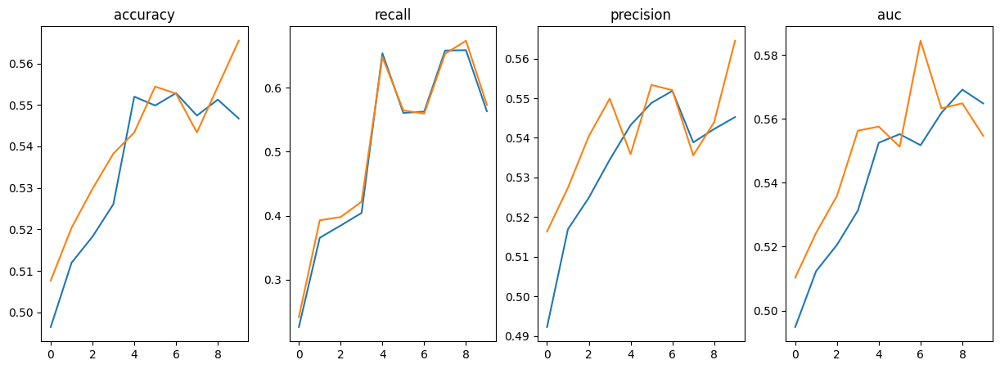

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [10] [ 0/14]  eta: 0:11:41  lr: 0.000011  loss: 0.6592  time: 50.1342  data: 46.6786  max mem: 15188
Train Epoch: [10] [ 6/14]  eta: 0:01:49  lr: 0.000012  loss: 0.6724  time: 13.7424  data: 10.9992  max mem: 15188
Train Epoch: [10] [12/14]  eta: 0:00:26  lr: 0.000012  loss: 0.6776  time: 13.4566  data: 10.6631  max mem: 15188
Train Epoch: [10] [13/14]  eta: 0:00:12  lr: 0.000012  loss: 0.6944  time: 12.6226  data: 9.9015  max mem: 15188
Train Epoch: [10] Total time: 0:02:56 (12.6231 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6886e_eval_time_per_batch: 14.6078


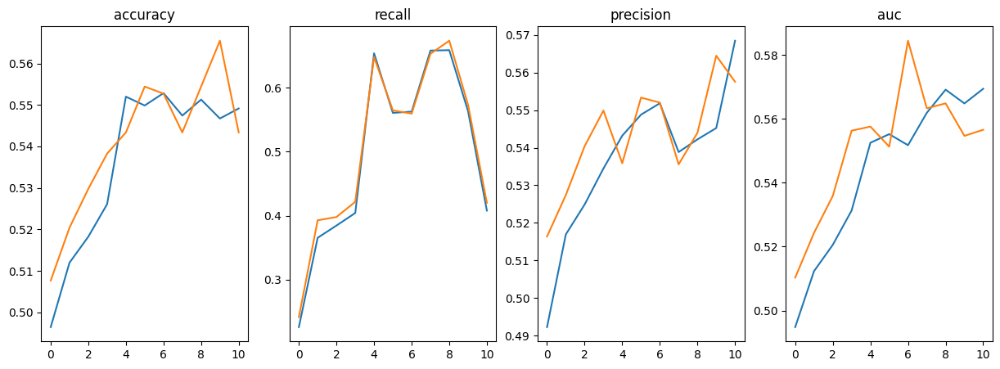

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [11] [ 0/14]  eta: 0:15:13  lr: 0.000012  loss: 0.6706  time: 65.2745  data: 62.6173  max mem: 15188
Train Epoch: [11] [ 6/14]  eta: 0:02:54  lr: 0.000013  loss: 0.6786  time: 21.7751  data: 18.9874  max mem: 15188
Train Epoch: [11] [12/14]  eta: 0:00:40  lr: 0.000013  loss: 0.6848  time: 20.3231  data: 17.6142  max mem: 15188
Train Epoch: [11] [13/14]  eta: 0:00:19  lr: 0.000013  loss: 0.6731  time: 19.0010  data: 16.3561  max mem: 15188
Train Epoch: [11] Total time: 0:04:26 (19.0014 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6878e_eval_time_per_batch: 34.58521


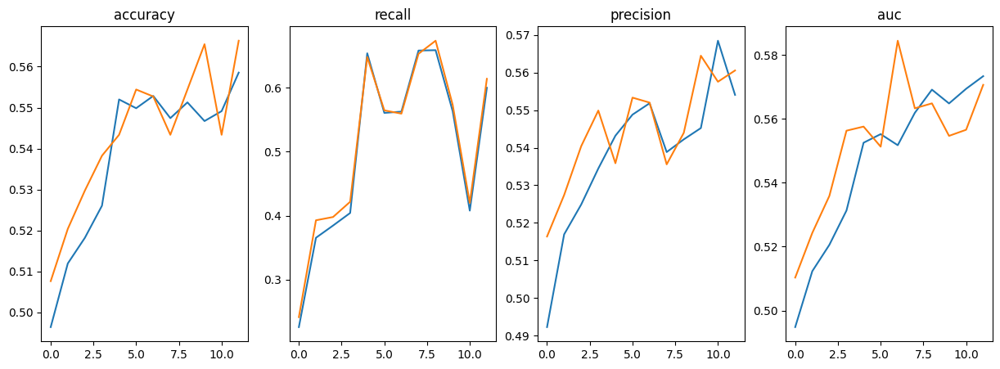

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [12] [ 0/14]  eta: 0:17:00  lr: 0.000014  loss: 0.6756  time: 72.8898  data: 70.4771  max mem: 15188
Train Epoch: [12] [ 6/14]  eta: 0:03:32  lr: 0.000014  loss: 0.6865  time: 26.6064  data: 23.9896  max mem: 15188
Train Epoch: [12] [12/14]  eta: 0:00:55  lr: 0.000014  loss: 0.6789  time: 27.6913  data: 25.0347  max mem: 15188
Train Epoch: [12] [13/14]  eta: 0:00:25  lr: 0.000015  loss: 0.6839  time: 25.8541  data: 23.2465  max mem: 15188
Train Epoch: [12] Total time: 0:06:01 (25.8546 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6874e_eval_time_per_batch: 23.4874


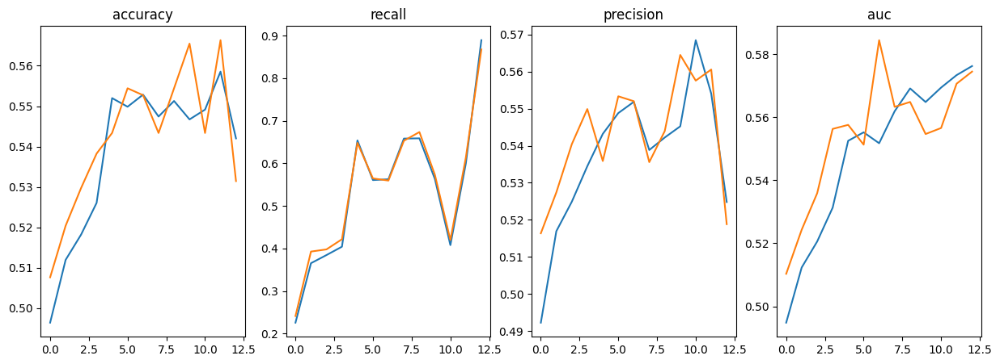

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [13] [ 0/14]  eta: 0:23:13  lr: 0.000015  loss: 0.6931  time: 99.5642  data: 89.6866  max mem: 15188
Train Epoch: [13] [ 6/14]  eta: 0:02:56  lr: 0.000015  loss: 0.6797  time: 22.0243  data: 18.3915  max mem: 15188
Train Epoch: [13] [12/14]  eta: 0:00:37  lr: 0.000016  loss: 0.6713  time: 18.9117  data: 15.6584  max mem: 15188
Train Epoch: [13] [13/14]  eta: 0:00:17  lr: 0.000016  loss: 0.6688  time: 17.7209  data: 14.5400  max mem: 15188
Train Epoch: [13] Total time: 0:04:08 (17.7215 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6869e_eval_time_per_batch: 19.7915


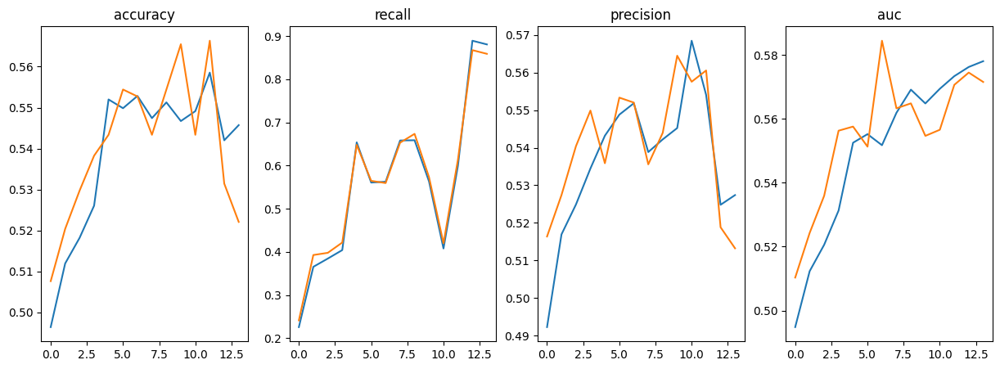

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [14] [ 0/14]  eta: 0:13:57  lr: 0.000016  loss: 0.6923  time: 59.7917  data: 57.1971  max mem: 15188
Train Epoch: [14] [ 6/14]  eta: 0:02:14  lr: 0.000016  loss: 0.6634  time: 16.7908  data: 14.0260  max mem: 15188
Train Epoch: [14] [12/14]  eta: 0:00:29  lr: 0.000017  loss: 0.6725  time: 14.9151  data: 12.1972  max mem: 15188
Train Epoch: [14] [13/14]  eta: 0:00:14  lr: 0.000017  loss: 0.6980  time: 14.0172  data: 11.3260  max mem: 15188
Train Epoch: [14] Total time: 0:03:16 (14.0176 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6863e_eval_time_per_batch: 14.7095


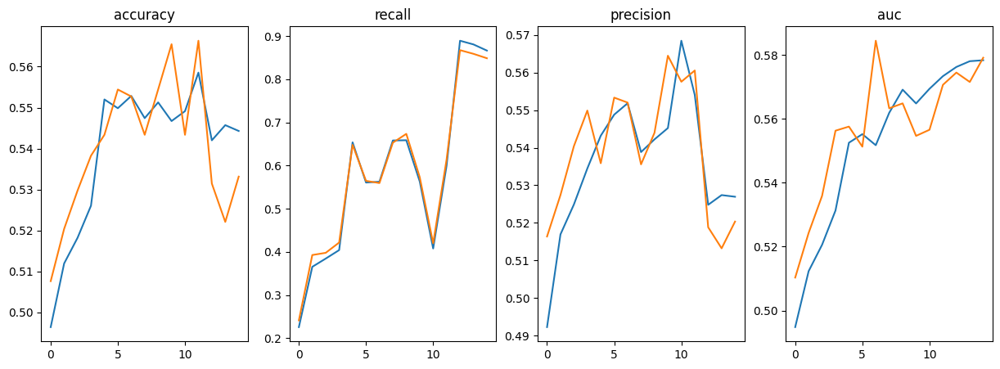

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [15] [ 0/14]  eta: 0:12:30  lr: 0.000017  loss: 0.6805  time: 53.5822  data: 51.0951  max mem: 15188
Train Epoch: [15] [ 6/14]  eta: 0:01:59  lr: 0.000017  loss: 0.6679  time: 14.9918  data: 12.2063  max mem: 15188
Train Epoch: [15] [12/14]  eta: 0:00:27  lr: 0.000018  loss: 0.6837  time: 13.5825  data: 10.7588  max mem: 15188
Train Epoch: [15] [13/14]  eta: 0:00:12  lr: 0.000018  loss: 0.6713  time: 12.7446  data: 9.9903  max mem: 15188
Train Epoch: [15] Total time: 0:02:58 (12.7450 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6859e_eval_time_per_batch: 18.7046


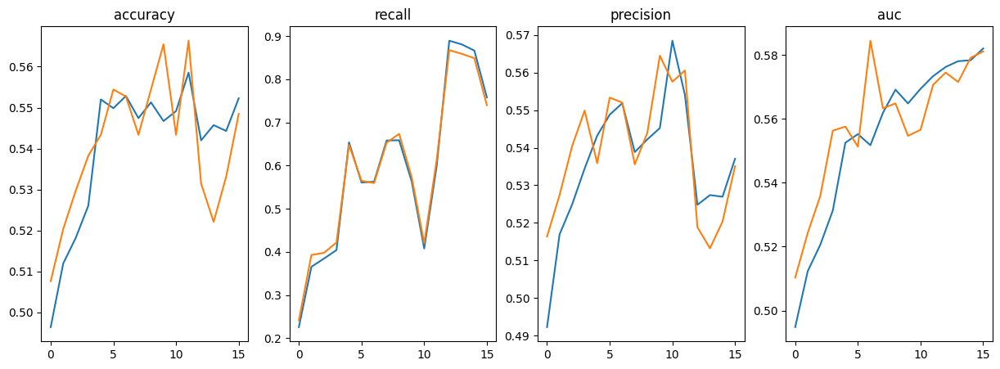

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [16] [ 0/14]  eta: 0:15:03  lr: 0.000018  loss: 0.6673  time: 64.5513  data: 62.0190  max mem: 15188
Train Epoch: [16] [ 6/14]  eta: 0:02:20  lr: 0.000018  loss: 0.6707  time: 17.5049  data: 14.8255  max mem: 15188
Train Epoch: [16] [12/14]  eta: 0:00:29  lr: 0.000019  loss: 0.6681  time: 14.9941  data: 12.2412  max mem: 15188
Train Epoch: [16] [13/14]  eta: 0:00:14  lr: 0.000019  loss: 0.6683  time: 14.0650  data: 11.3669  max mem: 15188
Train Epoch: [16] Total time: 0:03:16 (14.0653 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6853e_eval_time_per_batch: 14.6077


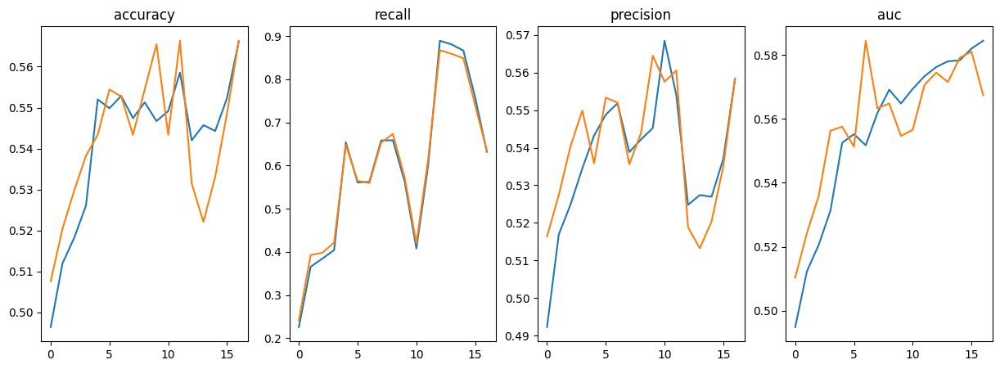

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [17] [ 0/14]  eta: 0:13:13  lr: 0.000019  loss: 0.6794  time: 56.7104  data: 54.3567  max mem: 15188
Train Epoch: [17] [ 6/14]  eta: 0:02:10  lr: 0.000020  loss: 0.6760  time: 16.2844  data: 13.5059  max mem: 15188
Train Epoch: [17] [12/14]  eta: 0:00:30  lr: 0.000020  loss: 0.6747  time: 15.3162  data: 12.5191  max mem: 15188
Train Epoch: [17] [13/14]  eta: 0:00:14  lr: 0.000020  loss: 0.6833  time: 14.3464  data: 11.6249  max mem: 15188
Train Epoch: [17] Total time: 0:03:20 (14.3467 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6847e_eval_time_per_batch: 14.7176


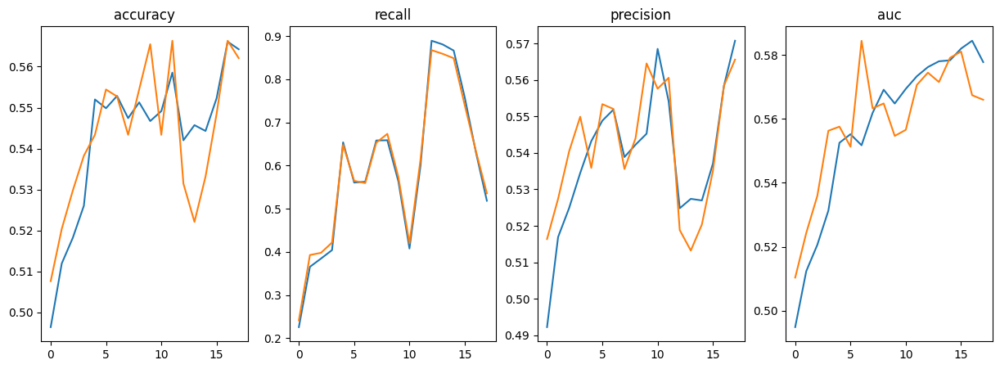

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [18] [ 0/14]  eta: 0:13:27  lr: 0.000020  loss: 0.6758  time: 57.7123  data: 55.1941  max mem: 15188
Train Epoch: [18] [ 6/14]  eta: 0:02:07  lr: 0.000021  loss: 0.6840  time: 15.9758  data: 12.5306  max mem: 15188
Train Epoch: [18] [12/14]  eta: 0:00:29  lr: 0.000021  loss: 0.6738  time: 14.9315  data: 11.7937  max mem: 15188
Train Epoch: [18] [13/14]  eta: 0:00:14  lr: 0.000021  loss: 0.6860  time: 14.0033  data: 10.9513  max mem: 15188
Train Epoch: [18] Total time: 0:03:16 (14.0036 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6843e_eval_time_per_batch: 14.2875


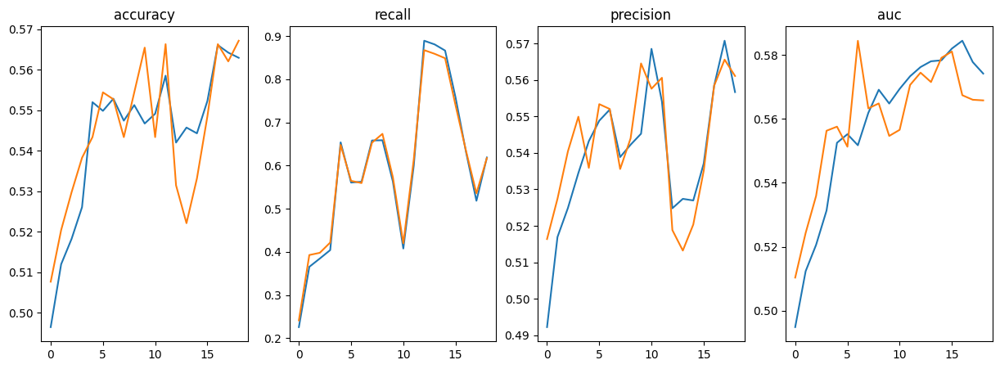

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [19] [ 0/14]  eta: 0:10:58  lr: 0.000021  loss: 0.6613  time: 47.0681  data: 44.6029  max mem: 15188
Train Epoch: [19] [ 6/14]  eta: 0:01:47  lr: 0.000022  loss: 0.6646  time: 13.4479  data: 10.7008  max mem: 15188
Train Epoch: [19] [12/14]  eta: 0:00:25  lr: 0.000022  loss: 0.6750  time: 12.8148  data: 10.0820  max mem: 15188
Train Epoch: [19] [13/14]  eta: 0:00:12  lr: 0.000022  loss: 0.6923  time: 12.0282  data: 9.3619  max mem: 15188
Train Epoch: [19] Total time: 0:02:48 (12.0285 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6836e_eval_time_per_batch: 14.2368


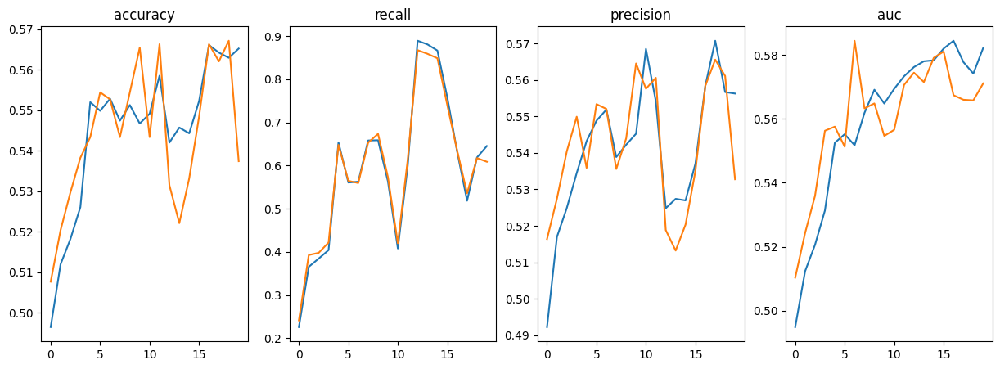

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [20] [ 0/14]  eta: 0:10:42  lr: 0.000022  loss: 0.6774  time: 45.8608  data: 43.3769  max mem: 15188
Train Epoch: [20] [ 6/14]  eta: 0:01:44  lr: 0.000023  loss: 0.6762  time: 13.0881  data: 10.4477  max mem: 15188
Train Epoch: [20] [12/14]  eta: 0:00:25  lr: 0.000023  loss: 0.6634  time: 12.7689  data: 10.0420  max mem: 15188
Train Epoch: [20] [13/14]  eta: 0:00:11  lr: 0.000024  loss: 0.6857  time: 11.9830  data: 9.3248  max mem: 15188
Train Epoch: [20] Total time: 0:02:47 (11.9833 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6831e_eval_time_per_batch: 14.4953


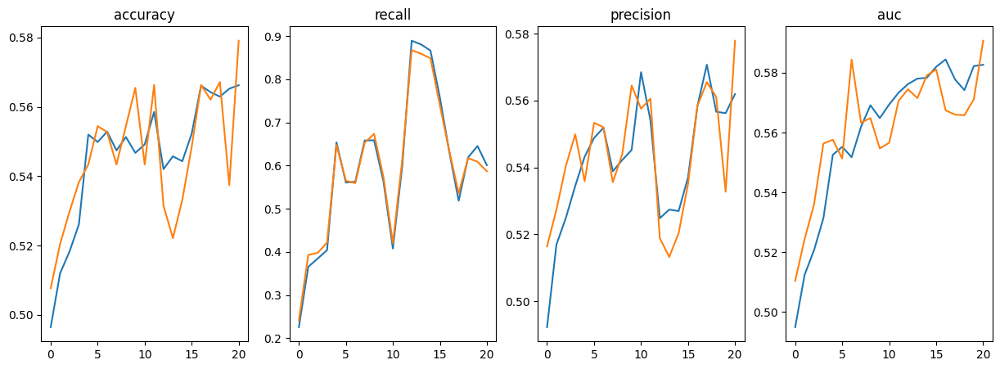

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [21] [ 0/14]  eta: 0:10:50  lr: 0.000024  loss: 0.6834  time: 46.4992  data: 43.1491  max mem: 15188
Train Epoch: [21] [ 6/14]  eta: 0:01:51  lr: 0.000024  loss: 0.6665  time: 13.9097  data: 10.9478  max mem: 15188
Train Epoch: [21] [12/14]  eta: 0:00:25  lr: 0.000025  loss: 0.6757  time: 12.6297  data: 9.8881  max mem: 15188
Train Epoch: [21] [13/14]  eta: 0:00:11  lr: 0.000025  loss: 0.6887  time: 11.8712  data: 9.1818  max mem: 15188
Train Epoch: [21] Total time: 0:02:46 (11.8716 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6828e_eval_time_per_batch: 14.9963


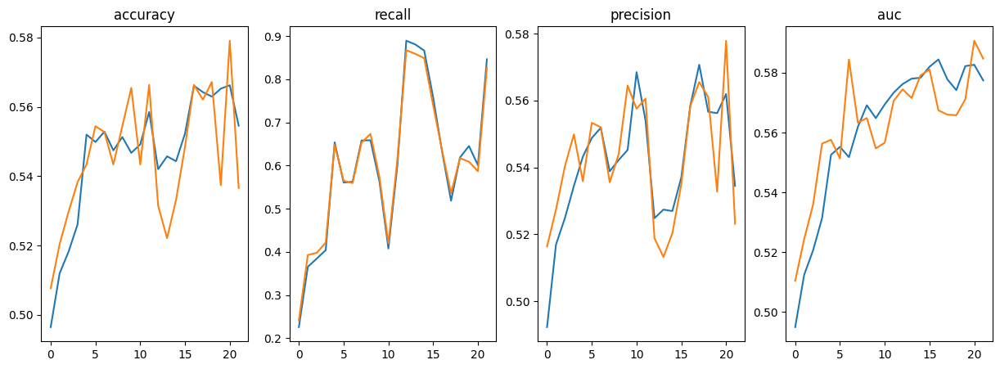

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [22] [ 0/14]  eta: 0:10:34  lr: 0.000025  loss: 0.6736  time: 45.3130  data: 42.7989  max mem: 15188
Train Epoch: [22] [ 6/14]  eta: 0:01:50  lr: 0.000025  loss: 0.6616  time: 13.8613  data: 10.9727  max mem: 15188
Train Epoch: [22] [12/14]  eta: 0:00:25  lr: 0.000026  loss: 0.6585  time: 12.6807  data: 9.9428  max mem: 15188
Train Epoch: [22] [13/14]  eta: 0:00:11  lr: 0.000026  loss: 0.6712  time: 11.9045  data: 9.2326  max mem: 15188
Train Epoch: [22] Total time: 0:02:46 (11.9048 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6822e_eval_time_per_batch: 14.8385


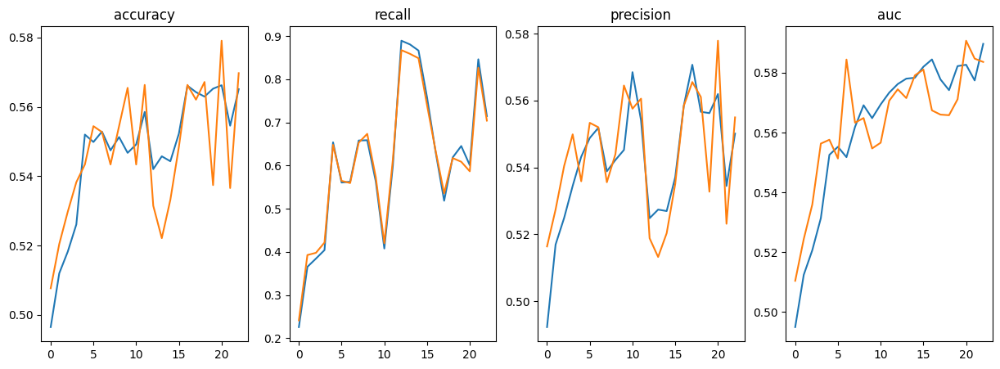

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [23] [ 0/14]  eta: 0:11:20  lr: 0.000026  loss: 0.6724  time: 48.5936  data: 45.9165  max mem: 15188
Train Epoch: [23] [ 6/14]  eta: 0:01:52  lr: 0.000026  loss: 0.6761  time: 14.0429  data: 10.6606  max mem: 15188
Train Epoch: [23] [12/14]  eta: 0:00:25  lr: 0.000027  loss: 0.6847  time: 12.9041  data: 9.7884  max mem: 15188
Train Epoch: [23] [13/14]  eta: 0:00:12  lr: 0.000027  loss: 0.6818  time: 12.1131  data: 9.0893  max mem: 15188
Train Epoch: [23] Total time: 0:02:49 (12.1134 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6818e_eval_time_per_batch: 15.4055


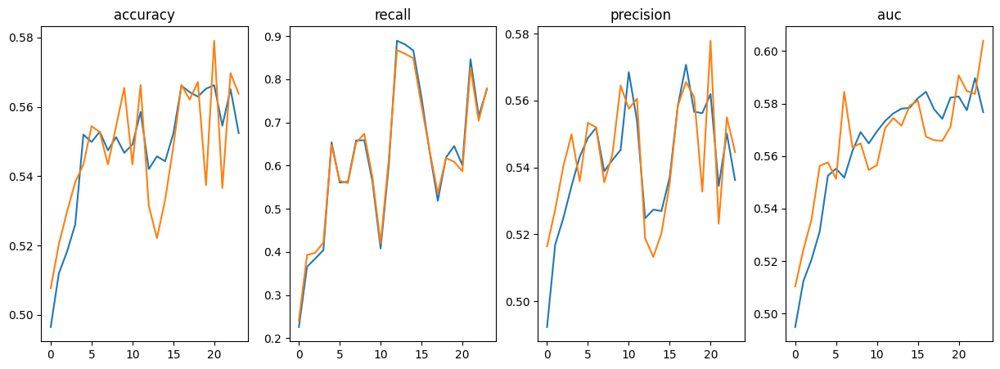

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [24] [ 0/14]  eta: 0:11:22  lr: 0.000027  loss: 0.6749  time: 48.7769  data: 46.3900  max mem: 15188
Train Epoch: [24] [ 6/14]  eta: 0:01:54  lr: 0.000027  loss: 0.6899  time: 14.3339  data: 11.5414  max mem: 15188
Train Epoch: [24] [12/14]  eta: 0:00:26  lr: 0.000028  loss: 0.6870  time: 13.0671  data: 10.2735  max mem: 15188
Train Epoch: [24] [13/14]  eta: 0:00:12  lr: 0.000028  loss: 0.6772  time: 12.2607  data: 9.5396  max mem: 15188
Train Epoch: [24] Total time: 0:02:51 (12.2610 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6816e_eval_time_per_batch: 14.8258


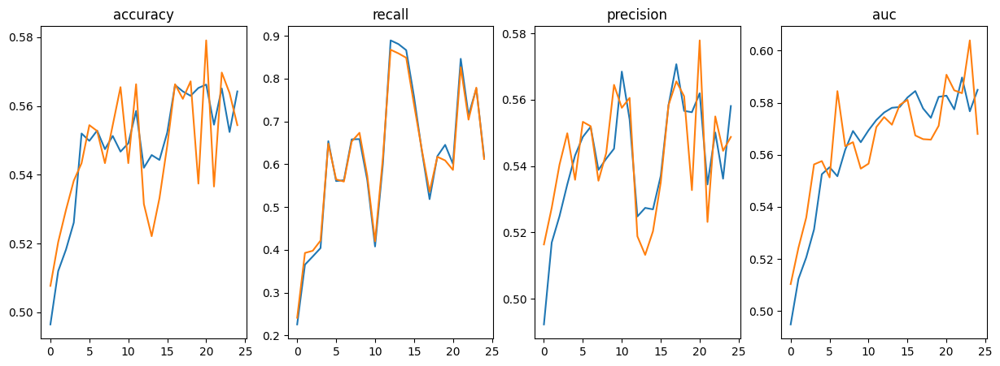

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [25] [ 0/14]  eta: 0:12:03  lr: 0.000028  loss: 0.6752  time: 51.6456  data: 48.3869  max mem: 15188
Train Epoch: [25] [ 6/14]  eta: 0:01:59  lr: 0.000029  loss: 0.6870  time: 14.9476  data: 12.1827  max mem: 15188
Train Epoch: [25] [12/14]  eta: 0:00:28  lr: 0.000029  loss: 0.6693  time: 14.1420  data: 11.4264  max mem: 15188
Train Epoch: [25] [13/14]  eta: 0:00:13  lr: 0.000029  loss: 0.6669  time: 13.2629  data: 10.6102  max mem: 15188
Train Epoch: [25] Total time: 0:03:05 (13.2634 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6813e_eval_time_per_batch: 14.7036


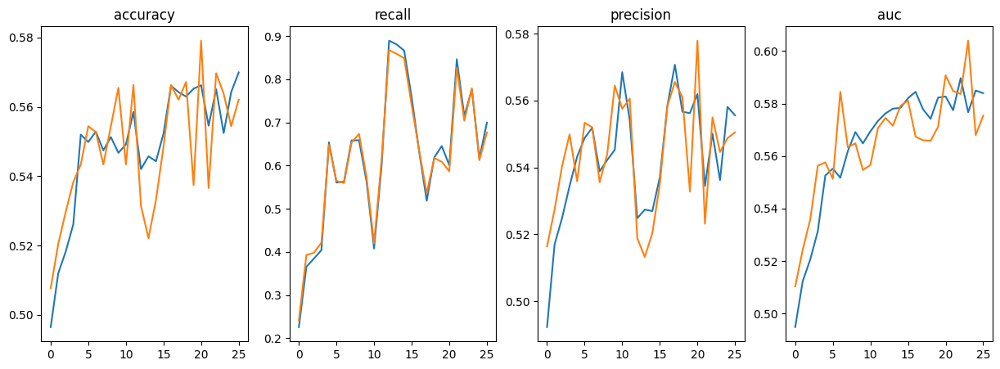

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [26] [ 0/14]  eta: 0:11:41  lr: 0.000029  loss: 0.6681  time: 50.1032  data: 47.4014  max mem: 15188
Train Epoch: [26] [ 6/14]  eta: 0:01:54  lr: 0.000030  loss: 0.6809  time: 14.3234  data: 11.7071  max mem: 15188
Train Epoch: [26] [12/14]  eta: 0:00:26  lr: 0.000030  loss: 0.6714  time: 13.2066  data: 10.5687  max mem: 15188
Train Epoch: [26] [13/14]  eta: 0:00:12  lr: 0.000030  loss: 0.6744  time: 12.4373  data: 9.8138  max mem: 15188
Train Epoch: [26] Total time: 0:02:54 (12.4376 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6810e_eval_time_per_batch: 14.4546


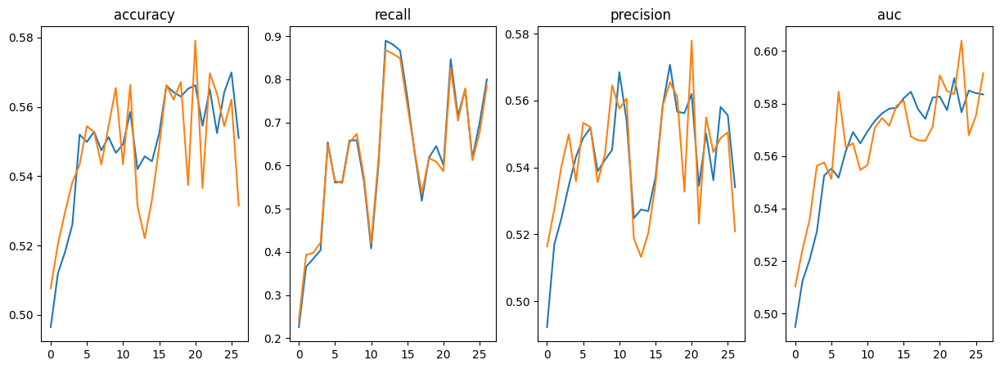

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [27] [ 0/14]  eta: 0:09:58  lr: 0.000030  loss: 0.6688  time: 42.7164  data: 40.0625  max mem: 15188
Train Epoch: [27] [ 6/14]  eta: 0:01:42  lr: 0.000031  loss: 0.6793  time: 12.7685  data: 10.0533  max mem: 15188
Train Epoch: [27] [12/14]  eta: 0:00:24  lr: 0.000031  loss: 0.6605  time: 12.2933  data: 9.5553  max mem: 15188
Train Epoch: [27] [13/14]  eta: 0:00:11  lr: 0.000031  loss: 0.6887  time: 11.5751  data: 8.8728  max mem: 15188
Train Epoch: [27] Total time: 0:02:42 (11.5753 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6807e_eval_time_per_batch: 14.6992


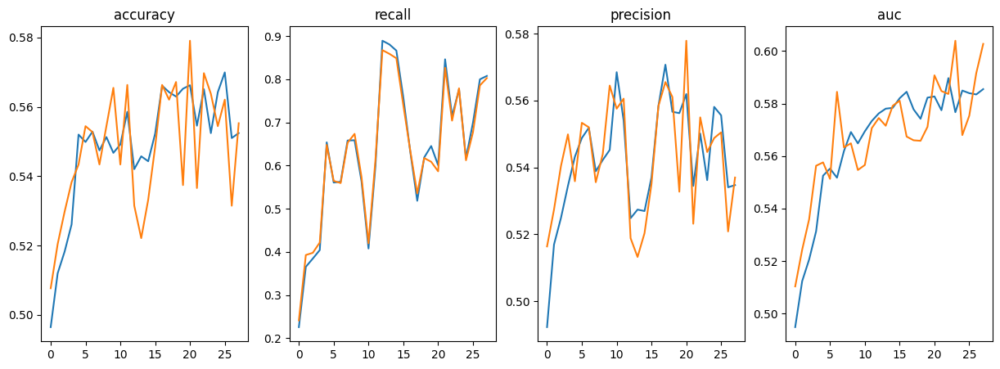

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [28] [ 0/14]  eta: 0:09:36  lr: 0.000031  loss: 0.6776  time: 41.1829  data: 38.5068  max mem: 15188
Train Epoch: [28] [ 6/14]  eta: 0:01:40  lr: 0.000032  loss: 0.6787  time: 12.6171  data: 9.1395  max mem: 15188
Train Epoch: [28] [12/14]  eta: 0:00:22  lr: 0.000032  loss: 0.6673  time: 11.1624  data: 8.1117  max mem: 15188
Train Epoch: [28] [13/14]  eta: 0:00:10  lr: 0.000032  loss: 0.6770  time: 10.5035  data: 7.5323  max mem: 15188
Train Epoch: [28] Total time: 0:02:27 (10.5039 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6805e_eval_time_per_batch: 14.7037


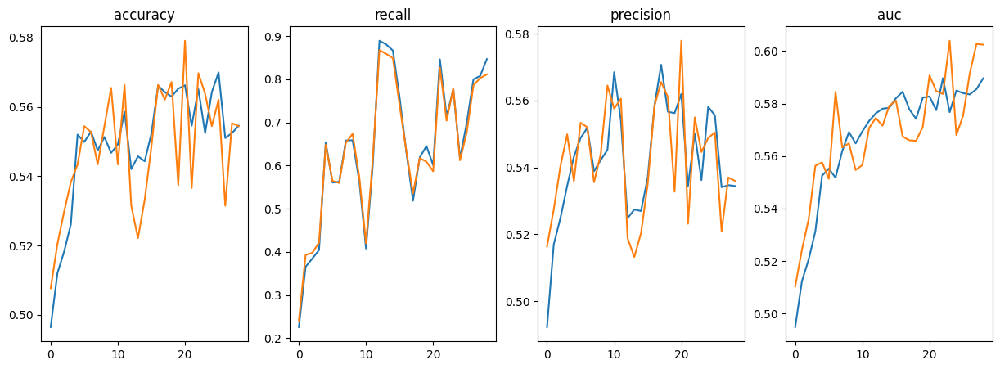

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [29] [ 0/14]  eta: 0:11:21  lr: 0.000033  loss: 0.6694  time: 48.6671  data: 46.1463  max mem: 15188
Train Epoch: [29] [ 6/14]  eta: 0:01:48  lr: 0.000033  loss: 0.7115  time: 13.5799  data: 10.9312  max mem: 15188
Train Epoch: [29] [12/14]  eta: 0:00:24  lr: 0.000034  loss: 0.6787  time: 12.4265  data: 9.6943  max mem: 15188
Train Epoch: [29] [13/14]  eta: 0:00:11  lr: 0.000034  loss: 0.7038  time: 11.7091  data: 9.0018  max mem: 15188
Train Epoch: [29] Total time: 0:02:43 (11.7094 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6805e_eval_time_per_batch: 14.8369


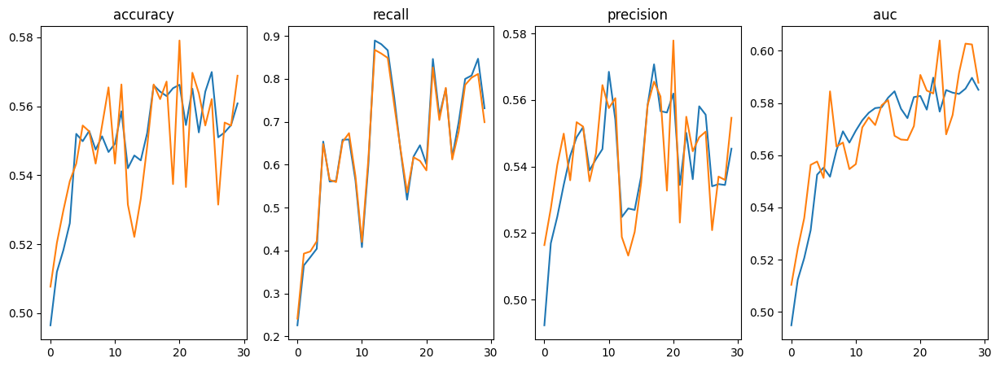

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [30] [ 0/14]  eta: 0:11:43  lr: 0.000034  loss: 0.6649  time: 50.2429  data: 47.5470  max mem: 15188
Train Epoch: [30] [ 6/14]  eta: 0:01:51  lr: 0.000034  loss: 0.6762  time: 13.8784  data: 11.2153  max mem: 15188
Train Epoch: [30] [12/14]  eta: 0:00:25  lr: 0.000035  loss: 0.6678  time: 12.9397  data: 10.2875  max mem: 15188
Train Epoch: [30] [13/14]  eta: 0:00:12  lr: 0.000035  loss: 0.6789  time: 12.1409  data: 9.5527  max mem: 15188
Train Epoch: [30] Total time: 0:02:49 (12.1412 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6802e_eval_time_per_batch: 14.7108


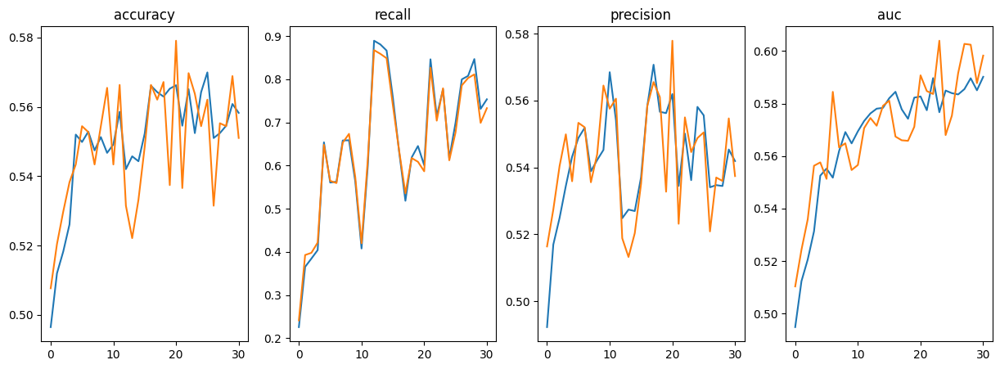

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [31] [ 0/14]  eta: 0:11:31  lr: 0.000035  loss: 0.6684  time: 49.3714  data: 46.9878  max mem: 15188
Train Epoch: [31] [ 6/14]  eta: 0:01:51  lr: 0.000035  loss: 0.6820  time: 13.8778  data: 11.1442  max mem: 15188
Train Epoch: [31] [12/14]  eta: 0:00:26  lr: 0.000036  loss: 0.6705  time: 13.2967  data: 10.5363  max mem: 15188
Train Epoch: [31] [13/14]  eta: 0:00:12  lr: 0.000036  loss: 0.6797  time: 12.4776  data: 9.7837  max mem: 15188
Train Epoch: [31] Total time: 0:02:54 (12.4779 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6800e_eval_time_per_batch: 14.1299


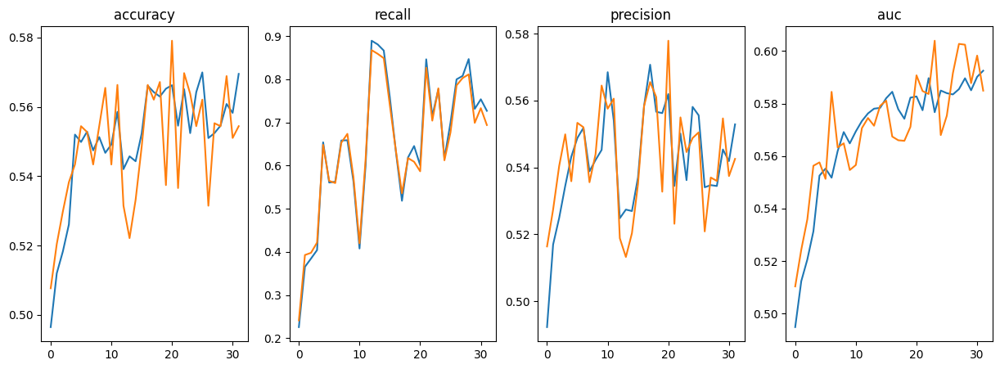

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [32] [ 0/14]  eta: 0:11:59  lr: 0.000036  loss: 0.6845  time: 51.3585  data: 48.3396  max mem: 15188
Train Epoch: [32] [ 6/14]  eta: 0:01:55  lr: 0.000036  loss: 0.6588  time: 14.4214  data: 11.6010  max mem: 15188
Train Epoch: [32] [12/14]  eta: 0:00:25  lr: 0.000037  loss: 0.6718  time: 12.9844  data: 10.2524  max mem: 15188
Train Epoch: [32] [13/14]  eta: 0:00:12  lr: 0.000037  loss: 0.6807  time: 12.1913  data: 9.5201  max mem: 15188
Train Epoch: [32] Total time: 0:02:50 (12.1916 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6796e_eval_time_per_batch: 14.8118


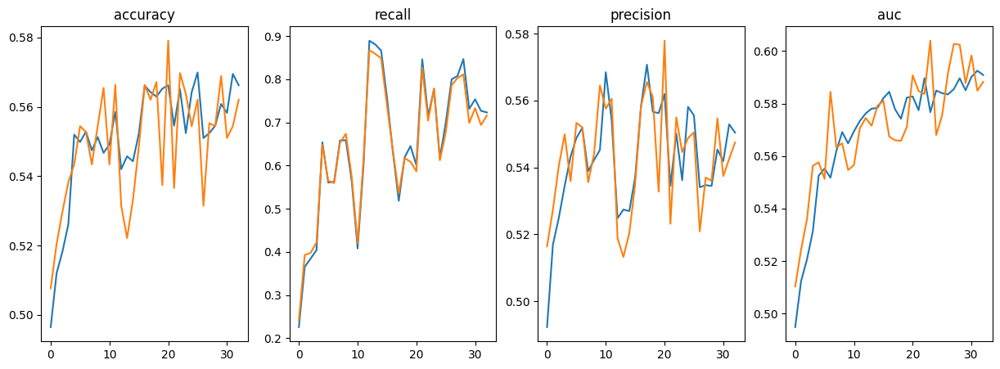

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [33] [ 0/14]  eta: 0:11:56  lr: 0.000037  loss: 0.6781  time: 51.1440  data: 47.7963  max mem: 15188
Train Epoch: [33] [ 6/14]  eta: 0:01:56  lr: 0.000038  loss: 0.6636  time: 14.5729  data: 11.8671  max mem: 15188
Train Epoch: [33] [12/14]  eta: 0:00:27  lr: 0.000038  loss: 0.6687  time: 13.5294  data: 10.3777  max mem: 15188
Train Epoch: [33] [13/14]  eta: 0:00:12  lr: 0.000038  loss: 0.6667  time: 12.6969  data: 9.6364  max mem: 15188
Train Epoch: [33] Total time: 0:02:57 (12.6972 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6794e_eval_time_per_batch: 14.7978


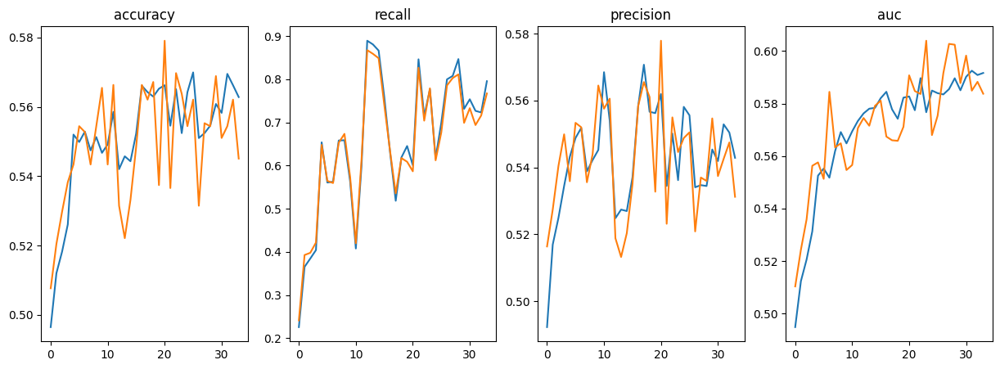

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [34] [ 0/14]  eta: 0:11:40  lr: 0.000038  loss: 0.6722  time: 50.0263  data: 47.2258  max mem: 15188
Train Epoch: [34] [ 6/14]  eta: 0:01:51  lr: 0.000039  loss: 0.6545  time: 13.9683  data: 11.2990  max mem: 15188
Train Epoch: [34] [12/14]  eta: 0:00:25  lr: 0.000039  loss: 0.6682  time: 12.9013  data: 10.1948  max mem: 15188
Train Epoch: [34] [13/14]  eta: 0:00:12  lr: 0.000039  loss: 0.6837  time: 12.1533  data: 9.4666  max mem: 15188
Train Epoch: [34] Total time: 0:02:50 (12.1536 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6791e_eval_time_per_batch: 14.7858


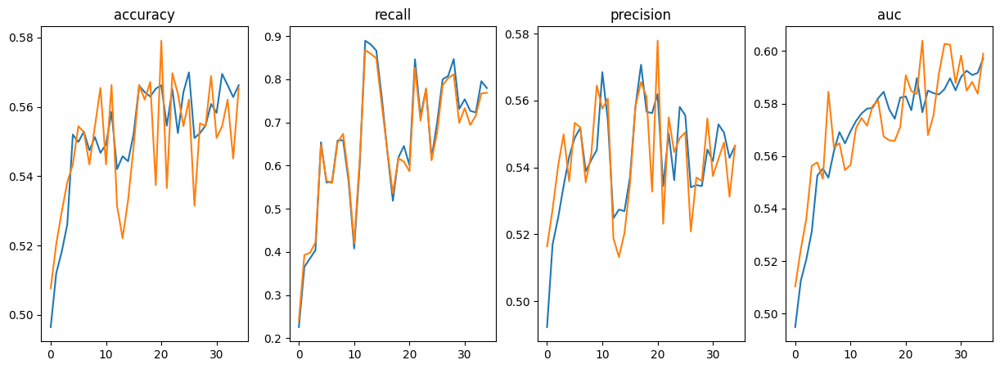

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [35] [ 0/14]  eta: 0:11:48  lr: 0.000039  loss: 0.6743  time: 50.5724  data: 47.2683  max mem: 15188
Train Epoch: [35] [ 6/14]  eta: 0:01:54  lr: 0.000040  loss: 0.6792  time: 14.2632  data: 11.5507  max mem: 15188
Train Epoch: [35] [12/14]  eta: 0:00:26  lr: 0.000040  loss: 0.6734  time: 13.3428  data: 10.6775  max mem: 15188
Train Epoch: [35] [13/14]  eta: 0:00:12  lr: 0.000040  loss: 0.6376  time: 12.5352  data: 9.9149  max mem: 15188
Train Epoch: [35] Total time: 0:02:55 (12.5355 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6788e_eval_time_per_batch: 17.1288


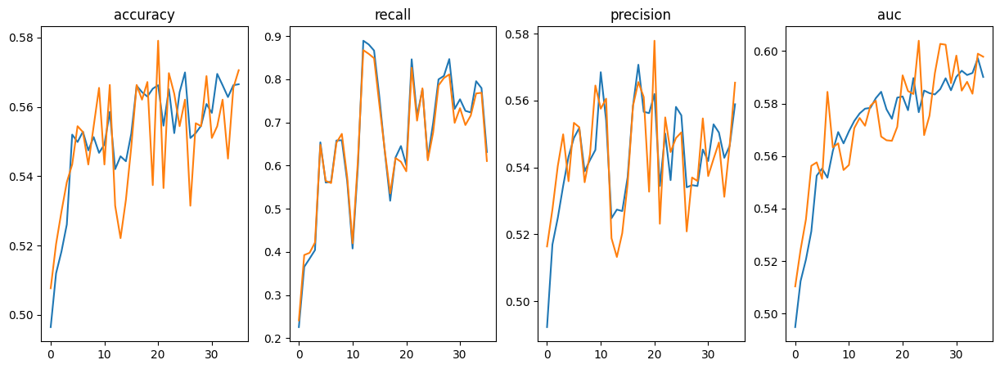

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [36] [ 0/14]  eta: 0:55:09  lr: 0.000040  loss: 0.6812  time: 236.3593  data: 233.0712  max mem: 15188
Train Epoch: [36] [ 6/14]  eta: 0:09:24  lr: 0.000041  loss: 0.6553  time: 70.5875  data: 67.7510  max mem: 15188
Train Epoch: [36] [12/14]  eta: 0:01:46  lr: 0.000041  loss: 0.6711  time: 53.2469  data: 50.4775  max mem: 15188
Train Epoch: [36] [13/14]  eta: 0:00:49  lr: 0.000041  loss: 0.6749  time: 49.5758  data: 46.8720  max mem: 15188
Train Epoch: [36] Total time: 0:11:34 (49.5763 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6784e_eval_time_per_batch: 49.41593


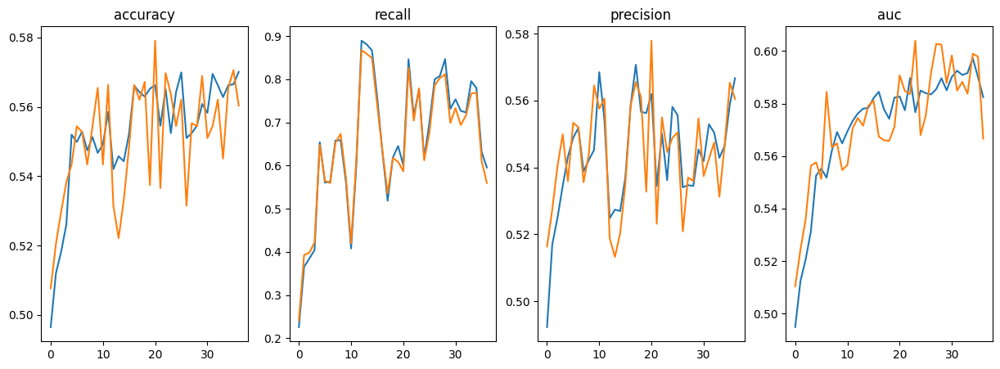

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [37] [ 0/14]  eta: 0:37:11  lr: 0.000042  loss: 0.6798  time: 159.3942  data: 156.8103  max mem: 15188
Train Epoch: [37] [ 6/14]  eta: 0:05:00  lr: 0.000042  loss: 0.6880  time: 37.5192  data: 34.7684  max mem: 15188
Train Epoch: [37] [12/14]  eta: 0:00:59  lr: 0.000042  loss: 0.6743  time: 29.6565  data: 26.9460  max mem: 15188
Train Epoch: [37] [13/14]  eta: 0:00:27  lr: 0.000043  loss: 0.6546  time: 27.6727  data: 25.0213  max mem: 15188
Train Epoch: [37] Total time: 0:06:27 (27.6731 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6782e_eval_time_per_batch: 19.8436


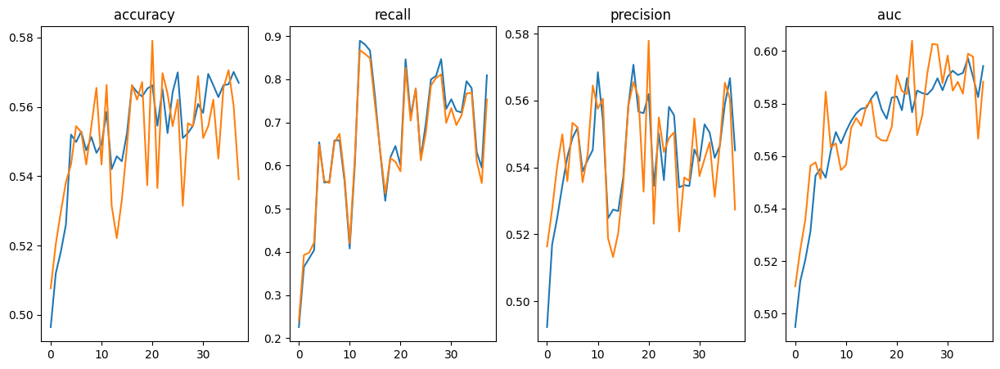

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [38] [ 0/14]  eta: 0:17:52  lr: 0.000043  loss: 0.6768  time: 76.6292  data: 73.3065  max mem: 15188
Train Epoch: [38] [ 6/14]  eta: 0:02:56  lr: 0.000043  loss: 0.6681  time: 22.1140  data: 19.3030  max mem: 15188
Train Epoch: [38] [12/14]  eta: 0:00:40  lr: 0.000044  loss: 0.6612  time: 20.2651  data: 17.1623  max mem: 15188
Train Epoch: [38] [13/14]  eta: 0:00:18  lr: 0.000044  loss: 0.6768  time: 18.9590  data: 15.9364  max mem: 15188
Train Epoch: [38] Total time: 0:04:25 (18.9594 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6780e_eval_time_per_batch: 19.9071


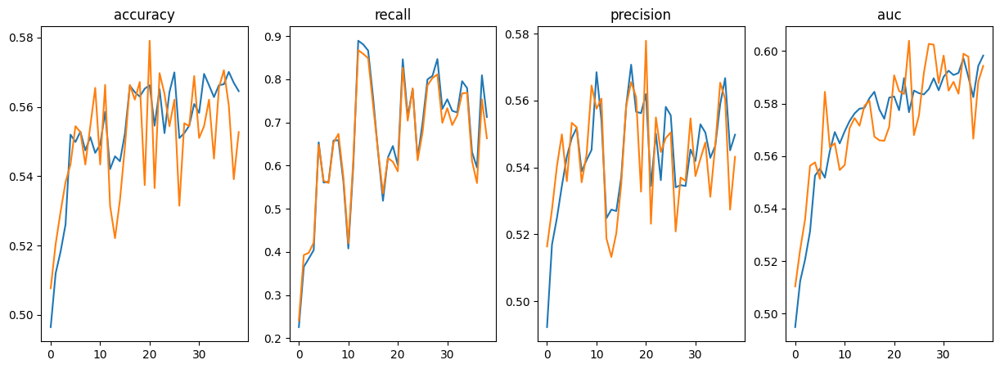

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [39] [ 0/14]  eta: 0:16:52  lr: 0.000044  loss: 0.6512  time: 72.3210  data: 69.8788  max mem: 15188
Train Epoch: [39] [ 6/14]  eta: 0:02:45  lr: 0.000044  loss: 0.6849  time: 20.6271  data: 18.1025  max mem: 15188
Train Epoch: [39] [12/14]  eta: 0:00:38  lr: 0.000045  loss: 0.6569  time: 19.1941  data: 16.4804  max mem: 15188
Train Epoch: [39] [13/14]  eta: 0:00:17  lr: 0.000045  loss: 0.6786  time: 17.9610  data: 15.3033  max mem: 15188
Train Epoch: [39] Total time: 0:04:11 (17.9613 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6779e_eval_time_per_batch: 21.0419


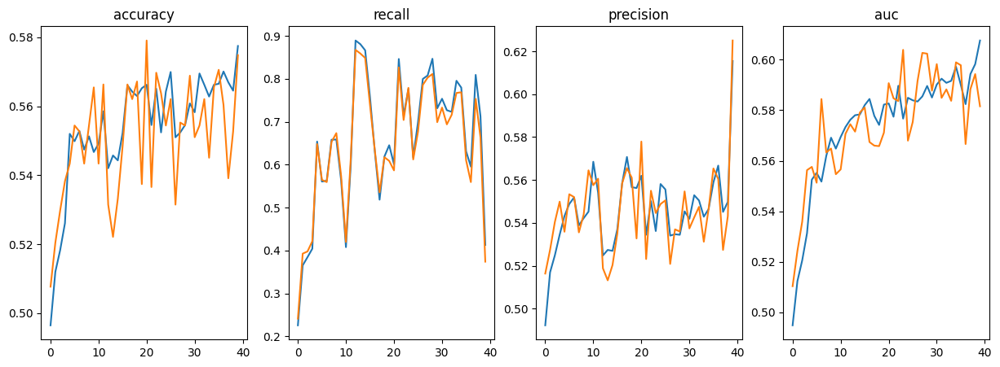

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [40] [ 0/14]  eta: 0:17:24  lr: 0.000045  loss: 0.6748  time: 74.6373  data: 72.0913  max mem: 15188
Train Epoch: [40] [ 6/14]  eta: 0:02:40  lr: 0.000045  loss: 0.6693  time: 20.0258  data: 17.5400  max mem: 15188
Train Epoch: [40] [12/14]  eta: 0:00:36  lr: 0.000046  loss: 0.6680  time: 18.3526  data: 15.7475  max mem: 15188
Train Epoch: [40] [13/14]  eta: 0:00:17  lr: 0.000046  loss: 0.6727  time: 17.2148  data: 14.6227  max mem: 15188
Train Epoch: [40] Total time: 0:04:01 (17.2151 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6778e_eval_time_per_batch: 19.4137


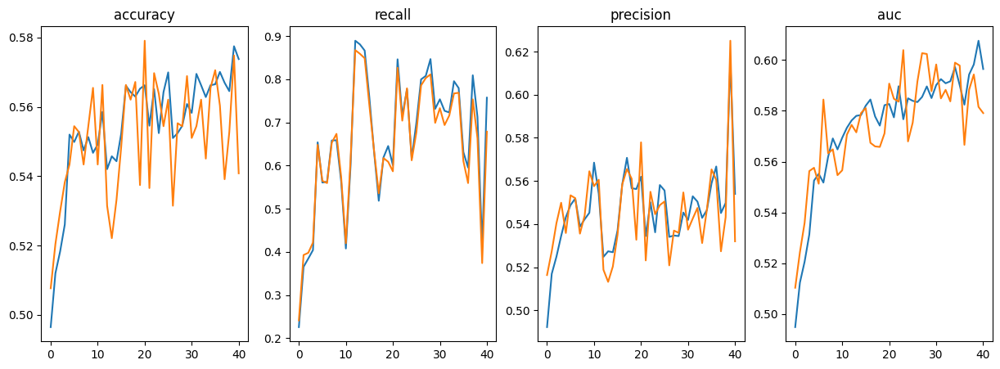

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [41] [ 0/14]  eta: 0:16:16  lr: 0.000046  loss: 0.6689  time: 69.7523  data: 67.2787  max mem: 15188
Train Epoch: [41] [ 6/14]  eta: 0:02:37  lr: 0.000046  loss: 0.6571  time: 19.7026  data: 17.0791  max mem: 15188
Train Epoch: [41] [12/14]  eta: 0:00:36  lr: 0.000047  loss: 0.6651  time: 18.4888  data: 15.8645  max mem: 15188
Train Epoch: [41] [13/14]  eta: 0:00:17  lr: 0.000047  loss: 0.6537  time: 17.3102  data: 14.7313  max mem: 15188
Train Epoch: [41] Total time: 0:04:02 (17.3105 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6775e_eval_time_per_batch: 19.8164


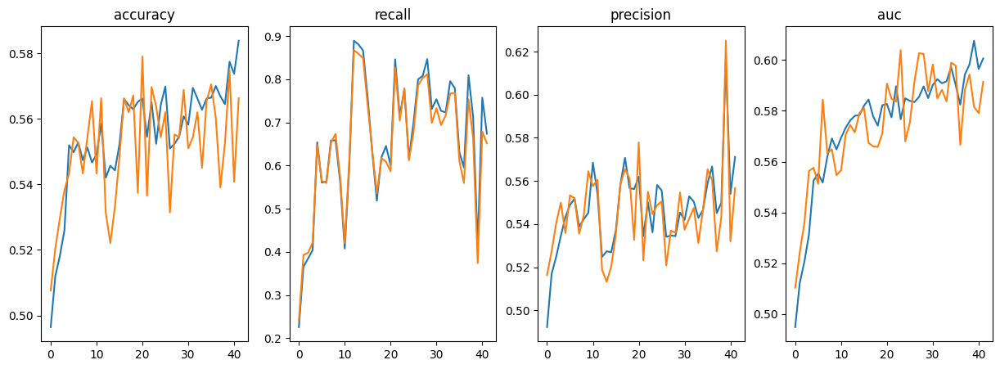

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [42] [ 0/14]  eta: 0:15:34  lr: 0.000047  loss: 0.6495  time: 66.7144  data: 63.4475  max mem: 15188
Train Epoch: [42] [ 6/14]  eta: 0:02:33  lr: 0.000048  loss: 0.6631  time: 19.1652  data: 16.3811  max mem: 15188
Train Epoch: [42] [12/14]  eta: 0:00:35  lr: 0.000048  loss: 0.6544  time: 17.9746  data: 15.3110  max mem: 15188
Train Epoch: [42] [13/14]  eta: 0:00:16  lr: 0.000048  loss: 0.6527  time: 16.8654  data: 14.2173  max mem: 15188
Train Epoch: [42] Total time: 0:03:56 (16.8657 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6772e_eval_time_per_batch: 19.5456


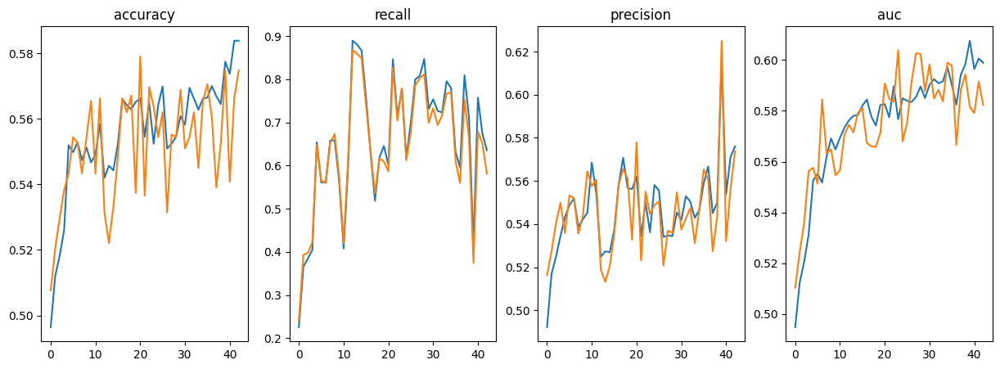

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [43] [ 0/14]  eta: 0:15:45  lr: 0.000048  loss: 0.6595  time: 67.5368  data: 65.0383  max mem: 15188
Train Epoch: [43] [ 6/14]  eta: 0:02:31  lr: 0.000049  loss: 0.6644  time: 18.9602  data: 16.2178  max mem: 15188
Train Epoch: [43] [12/14]  eta: 0:00:35  lr: 0.000049  loss: 0.6657  time: 17.5655  data: 14.9164  max mem: 15188
Train Epoch: [43] [13/14]  eta: 0:00:16  lr: 0.000049  loss: 0.6705  time: 16.4358  data: 13.8509  max mem: 15188
Train Epoch: [43] Total time: 0:03:50 (16.4362 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6770e_eval_time_per_batch: 19.2133


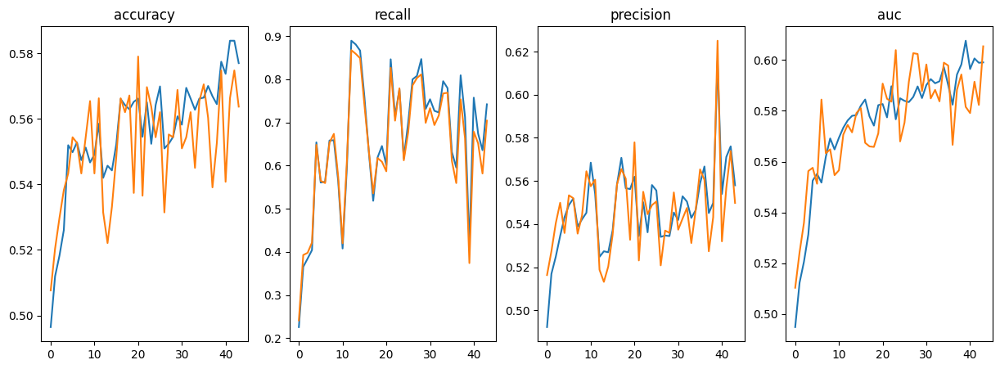

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [44] [ 0/14]  eta: 0:12:43  lr: 0.000049  loss: 0.6634  time: 54.5298  data: 51.9975  max mem: 15188
Train Epoch: [44] [ 6/14]  eta: 0:02:05  lr: 0.000050  loss: 0.6578  time: 15.6882  data: 13.0324  max mem: 15188
Train Epoch: [44] [12/14]  eta: 0:00:29  lr: 0.000050  loss: 0.6670  time: 14.6036  data: 11.9079  max mem: 15188
Train Epoch: [44] [13/14]  eta: 0:00:13  lr: 0.000050  loss: 0.6665  time: 13.6873  data: 11.0574  max mem: 15188
Train Epoch: [44] Total time: 0:03:11 (13.6877 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6768e_eval_time_per_batch: 16.7881


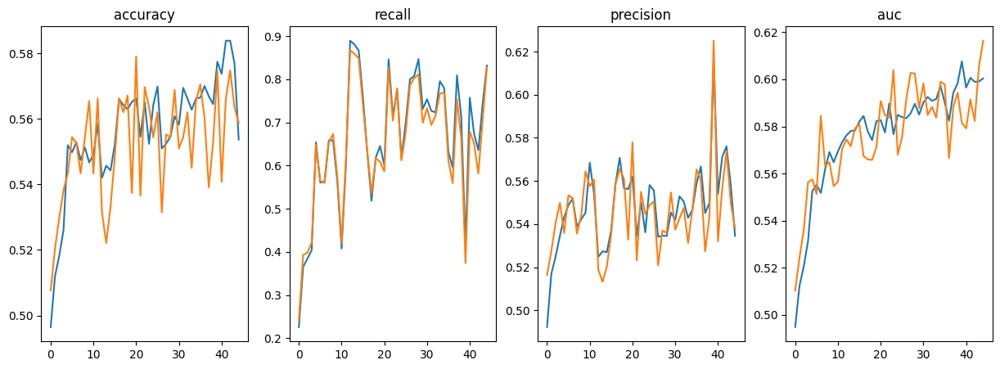

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [45] [ 0/14]  eta: 0:12:24  lr: 0.000050  loss: 0.6711  time: 53.1733  data: 50.6491  max mem: 15188
Train Epoch: [45] [ 6/14]  eta: 0:02:06  lr: 0.000051  loss: 0.6512  time: 15.8361  data: 13.0415  max mem: 15188
Train Epoch: [45] [12/14]  eta: 0:00:29  lr: 0.000051  loss: 0.6666  time: 14.6079  data: 11.8838  max mem: 15188
Train Epoch: [45] [13/14]  eta: 0:00:13  lr: 0.000052  loss: 0.6753  time: 13.6977  data: 11.0349  max mem: 15188
Train Epoch: [45] Total time: 0:03:11 (13.6982 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6765e_eval_time_per_batch: 14.6371


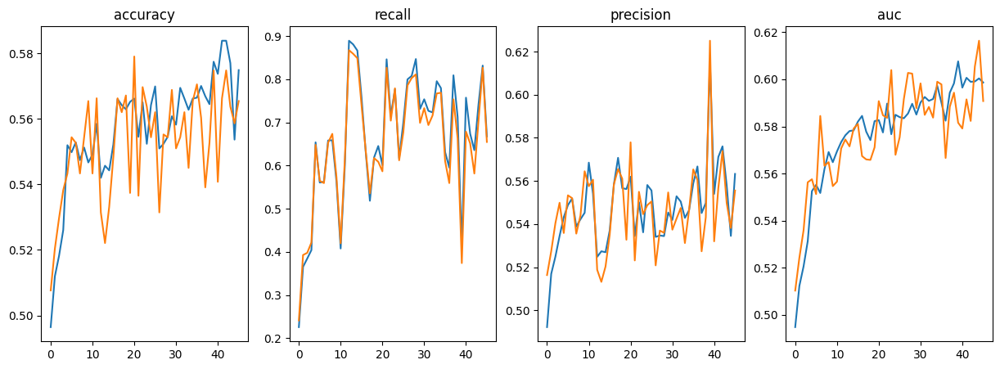

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [46] [ 0/14]  eta: 0:12:57  lr: 0.000052  loss: 0.6553  time: 55.5427  data: 53.1103  max mem: 15188
Train Epoch: [46] [ 6/14]  eta: 0:02:12  lr: 0.000052  loss: 0.6851  time: 16.6193  data: 13.9084  max mem: 15188
Train Epoch: [46] [12/14]  eta: 0:00:29  lr: 0.000053  loss: 0.6523  time: 14.6771  data: 12.0294  max mem: 15188
Train Epoch: [46] [13/14]  eta: 0:00:13  lr: 0.000053  loss: 0.6561  time: 13.7710  data: 11.1701  max mem: 15188
Train Epoch: [46] Total time: 0:03:12 (13.7715 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6763e_eval_time_per_batch: 14.526


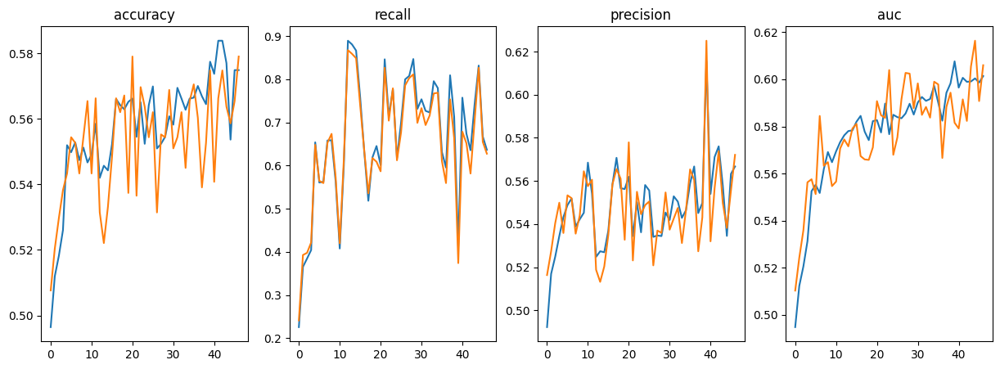

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [47] [ 0/14]  eta: 0:11:43  lr: 0.000053  loss: 0.6701  time: 50.2486  data: 47.7901  max mem: 15188
Train Epoch: [47] [ 6/14]  eta: 0:01:59  lr: 0.000053  loss: 0.6577  time: 14.9627  data: 12.2534  max mem: 15188
Train Epoch: [47] [12/14]  eta: 0:00:28  lr: 0.000054  loss: 0.6487  time: 14.3899  data: 11.7132  max mem: 15188
Train Epoch: [47] [13/14]  eta: 0:00:13  lr: 0.000054  loss: 0.6539  time: 13.5343  data: 10.8765  max mem: 15188
Train Epoch: [47] Total time: 0:03:09 (13.5346 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6760e_eval_time_per_batch: 14.6258


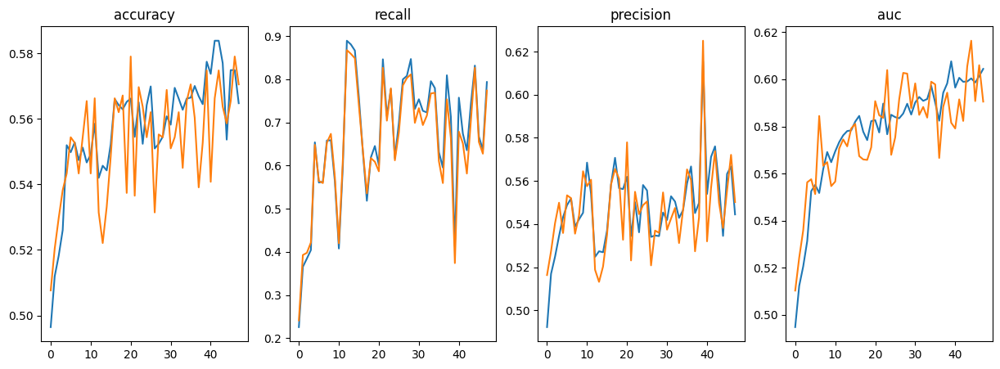

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [48] [ 0/14]  eta: 0:12:39  lr: 0.000054  loss: 0.6734  time: 54.2810  data: 51.6832  max mem: 15188
Train Epoch: [48] [ 6/14]  eta: 0:02:00  lr: 0.000054  loss: 0.6792  time: 15.0179  data: 12.2410  max mem: 15188
Train Epoch: [48] [12/14]  eta: 0:00:28  lr: 0.000055  loss: 0.6695  time: 14.2213  data: 11.5117  max mem: 15188
Train Epoch: [48] [13/14]  eta: 0:00:13  lr: 0.000055  loss: 0.6701  time: 13.3754  data: 10.6894  max mem: 15188
Train Epoch: [48] Total time: 0:03:07 (13.3757 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6758e_eval_time_per_batch: 14.8762


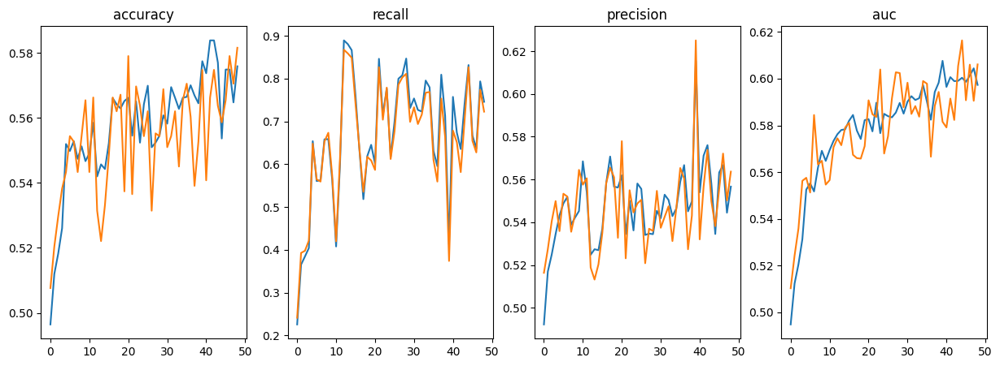

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [49] [ 0/14]  eta: 0:11:27  lr: 0.000055  loss: 0.6781  time: 49.1286  data: 46.6801  max mem: 15188
Train Epoch: [49] [ 6/14]  eta: 0:01:50  lr: 0.000055  loss: 0.6700  time: 13.7593  data: 10.9969  max mem: 15188
Train Epoch: [49] [12/14]  eta: 0:00:26  lr: 0.000056  loss: 0.6578  time: 13.1550  data: 10.4268  max mem: 15188
Train Epoch: [49] [13/14]  eta: 0:00:12  lr: 0.000056  loss: 0.6543  time: 12.3440  data: 9.6821  max mem: 15188
Train Epoch: [49] Total time: 0:02:52 (12.3444 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6755e_eval_time_per_batch: 14.4555


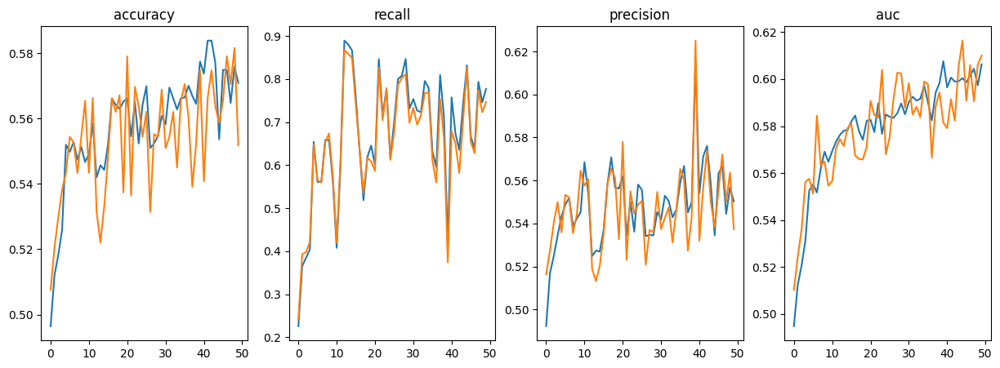

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [50] [ 0/14]  eta: 0:11:40  lr: 0.000056  loss: 0.6639  time: 50.0671  data: 47.5998  max mem: 15188
Train Epoch: [50] [ 6/14]  eta: 0:02:00  lr: 0.000057  loss: 0.6494  time: 15.1191  data: 12.3988  max mem: 15188
Train Epoch: [50] [12/14]  eta: 0:00:29  lr: 0.000057  loss: 0.6663  time: 14.5394  data: 11.9079  max mem: 15188
Train Epoch: [50] [13/14]  eta: 0:00:13  lr: 0.000057  loss: 0.6638  time: 13.6740  data: 11.0573  max mem: 15188
Train Epoch: [50] Total time: 0:03:11 (13.6743 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6752e_eval_time_per_batch: 14.7458


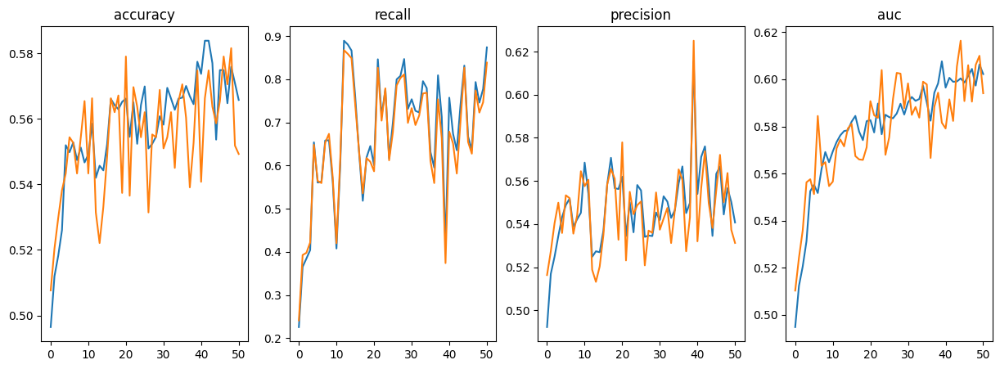

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [51] [ 0/14]  eta: 0:12:50  lr: 0.000057  loss: 0.6867  time: 55.0405  data: 52.5753  max mem: 15188
Train Epoch: [51] [ 6/14]  eta: 0:02:05  lr: 0.000058  loss: 0.6516  time: 15.6774  data: 13.0741  max mem: 15188
Train Epoch: [51] [12/14]  eta: 0:00:30  lr: 0.000058  loss: 0.6642  time: 15.1679  data: 12.4243  max mem: 15188
Train Epoch: [51] [13/14]  eta: 0:00:14  lr: 0.000058  loss: 0.6587  time: 14.2265  data: 11.5368  max mem: 15188
Train Epoch: [51] Total time: 0:03:19 (14.2268 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6751e_eval_time_per_batch: 14.4366


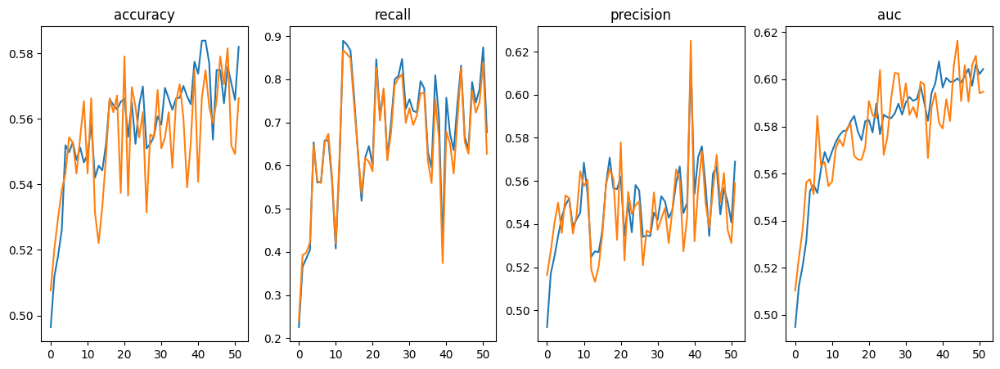

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [52] [ 0/14]  eta: 0:12:15  lr: 0.000058  loss: 0.6672  time: 52.5429  data: 50.0740  max mem: 15188
Train Epoch: [52] [ 6/14]  eta: 0:02:01  lr: 0.000059  loss: 0.6680  time: 15.1874  data: 12.5582  max mem: 15188
Train Epoch: [52] [12/14]  eta: 0:00:28  lr: 0.000059  loss: 0.6655  time: 14.3052  data: 11.6647  max mem: 15188
Train Epoch: [52] [13/14]  eta: 0:00:13  lr: 0.000059  loss: 0.6646  time: 13.4131  data: 10.8315  max mem: 15188
Train Epoch: [52] Total time: 0:03:07 (13.4135 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6749e_eval_time_per_batch: 14.6485


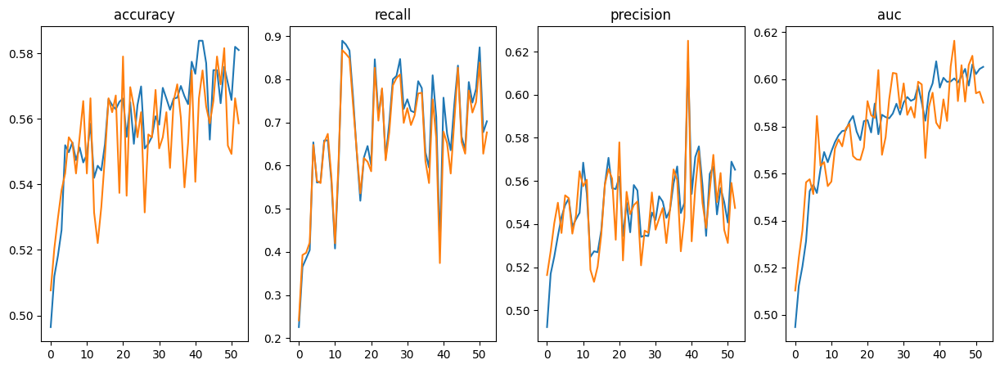

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [53] [ 0/14]  eta: 0:12:23  lr: 0.000059  loss: 0.6619  time: 53.1351  data: 50.5809  max mem: 15188
Train Epoch: [53] [ 6/14]  eta: 0:01:58  lr: 0.000060  loss: 0.6847  time: 14.8227  data: 12.2523  max mem: 15188
Train Epoch: [53] [12/14]  eta: 0:00:27  lr: 0.000060  loss: 0.6572  time: 13.9319  data: 11.2478  max mem: 15188
Train Epoch: [53] [13/14]  eta: 0:00:13  lr: 0.000060  loss: 0.6621  time: 13.1121  data: 10.4444  max mem: 15188
Train Epoch: [53] Total time: 0:03:03 (13.1125 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6748e_eval_time_per_batch: 14.2895


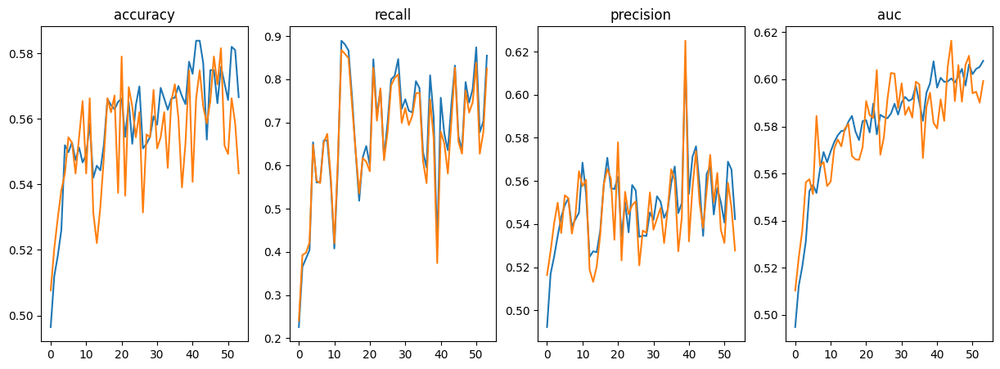

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [54] [ 0/14]  eta: 0:13:00  lr: 0.000061  loss: 0.6672  time: 55.7379  data: 52.4472  max mem: 15188
Train Epoch: [54] [ 6/14]  eta: 0:02:05  lr: 0.000061  loss: 0.6695  time: 15.6545  data: 12.8170  max mem: 15188
Train Epoch: [54] [12/14]  eta: 0:00:29  lr: 0.000062  loss: 0.6663  time: 14.5658  data: 11.8323  max mem: 15188
Train Epoch: [54] [13/14]  eta: 0:00:13  lr: 0.000062  loss: 0.6681  time: 13.6663  data: 10.9872  max mem: 15188
Train Epoch: [54] Total time: 0:03:11 (13.6667 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6747e_eval_time_per_batch: 14.6231


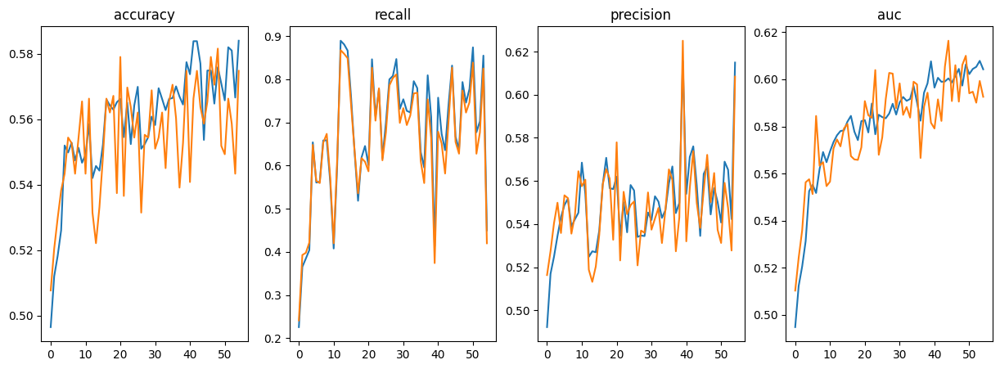

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [55] [ 0/14]  eta: 0:12:35  lr: 0.000062  loss: 0.6685  time: 53.9860  data: 50.7003  max mem: 15188
Train Epoch: [55] [ 6/14]  eta: 0:02:03  lr: 0.000062  loss: 0.6738  time: 15.3980  data: 11.9106  max mem: 15188
Train Epoch: [55] [12/14]  eta: 0:00:28  lr: 0.000063  loss: 0.6545  time: 14.4417  data: 11.3221  max mem: 15188
Train Epoch: [55] [13/14]  eta: 0:00:13  lr: 0.000063  loss: 0.6554  time: 13.5467  data: 10.5134  max mem: 15188
Train Epoch: [55] Total time: 0:03:09 (13.5471 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6744e_eval_time_per_batch: 14.6236


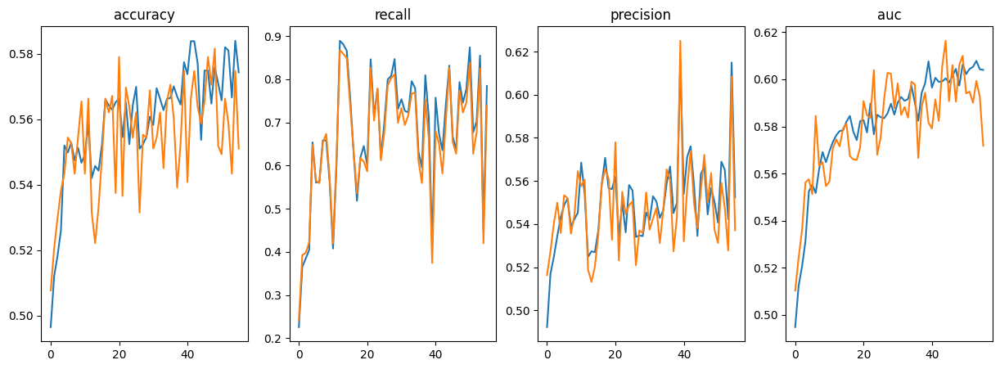

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [56] [ 0/14]  eta: 0:13:03  lr: 0.000063  loss: 0.6573  time: 55.9697  data: 53.2694  max mem: 15188
Train Epoch: [56] [ 6/14]  eta: 0:02:04  lr: 0.000063  loss: 0.6552  time: 15.6082  data: 12.9665  max mem: 15188
Train Epoch: [56] [12/14]  eta: 0:00:29  lr: 0.000064  loss: 0.6610  time: 14.5160  data: 11.8587  max mem: 15188
Train Epoch: [56] [13/14]  eta: 0:00:13  lr: 0.000064  loss: 0.6582  time: 13.6480  data: 11.0117  max mem: 15188
Train Epoch: [56] Total time: 0:03:11 (13.6483 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6741e_eval_time_per_batch: 14.5715


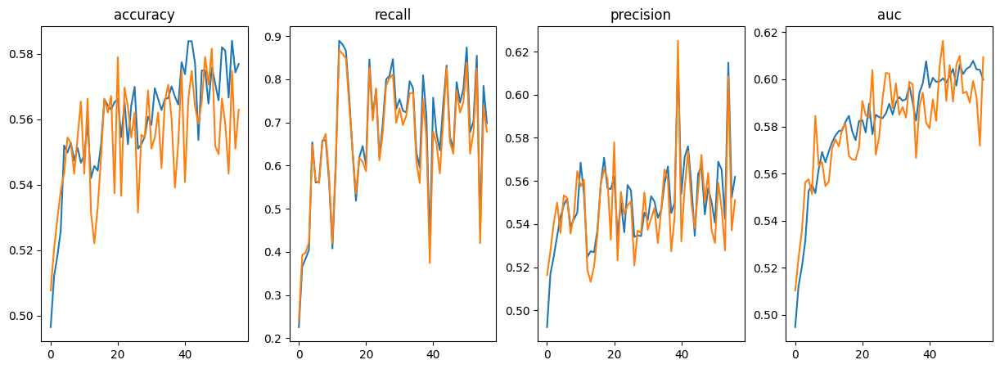

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [57] [ 0/14]  eta: 0:11:03  lr: 0.000064  loss: 0.6474  time: 47.3815  data: 44.1078  max mem: 15188
Train Epoch: [57] [ 6/14]  eta: 0:01:47  lr: 0.000064  loss: 0.6471  time: 13.4905  data: 10.7227  max mem: 15188
Train Epoch: [57] [12/14]  eta: 0:00:25  lr: 0.000065  loss: 0.6639  time: 12.7574  data: 10.0093  max mem: 15188
Train Epoch: [57] [13/14]  eta: 0:00:11  lr: 0.000065  loss: 0.6568  time: 11.9756  data: 9.2944  max mem: 15188
Train Epoch: [57] Total time: 0:02:47 (11.9762 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6738e_eval_time_per_batch: 14.8318


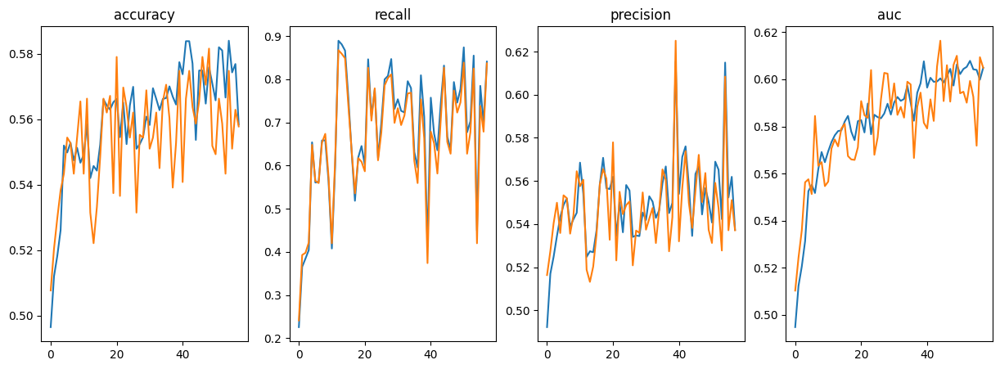

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [58] [ 0/14]  eta: 0:12:47  lr: 0.000065  loss: 0.6496  time: 54.7900  data: 52.1701  max mem: 15188
Train Epoch: [58] [ 6/14]  eta: 0:02:01  lr: 0.000066  loss: 0.6550  time: 15.2075  data: 12.4713  max mem: 15188
Train Epoch: [58] [12/14]  eta: 0:00:28  lr: 0.000066  loss: 0.6687  time: 14.1717  data: 11.4002  max mem: 15188
Train Epoch: [58] [13/14]  eta: 0:00:13  lr: 0.000066  loss: 0.6622  time: 13.2949  data: 10.5859  max mem: 15188
Train Epoch: [58] Total time: 0:03:06 (13.2952 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6734e_eval_time_per_batch: 14.5416


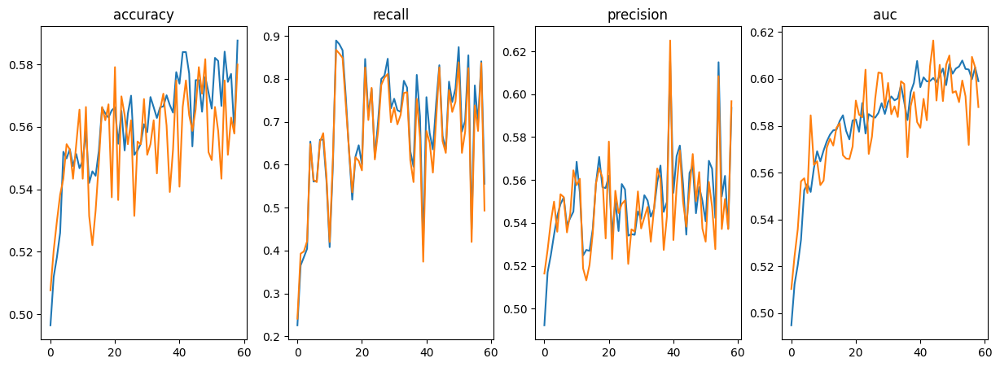

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [59] [ 0/14]  eta: 0:12:21  lr: 0.000066  loss: 0.6661  time: 52.9732  data: 50.5268  max mem: 15188
Train Epoch: [59] [ 6/14]  eta: 0:02:02  lr: 0.000067  loss: 0.6508  time: 15.2850  data: 12.5584  max mem: 15188
Train Epoch: [59] [12/14]  eta: 0:00:28  lr: 0.000067  loss: 0.6504  time: 14.4609  data: 11.7621  max mem: 15188
Train Epoch: [59] [13/14]  eta: 0:00:13  lr: 0.000067  loss: 0.6665  time: 13.5526  data: 10.9220  max mem: 15188
Train Epoch: [59] Total time: 0:03:09 (13.5530 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6732e_eval_time_per_batch: 14.5876


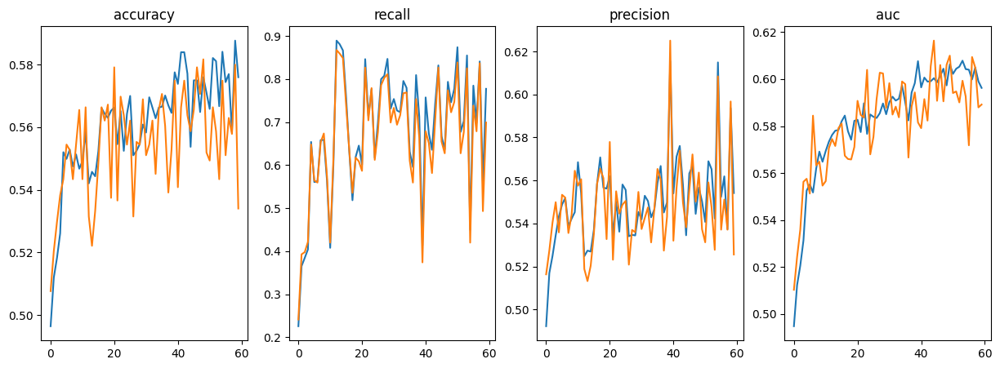

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [60] [ 0/14]  eta: 0:13:51  lr: 0.000067  loss: 0.6586  time: 59.4207  data: 56.6347  max mem: 15188
Train Epoch: [60] [ 6/14]  eta: 0:02:17  lr: 0.000068  loss: 0.6473  time: 17.2140  data: 13.9167  max mem: 15188
Train Epoch: [60] [12/14]  eta: 0:00:32  lr: 0.000068  loss: 0.6552  time: 16.1728  data: 13.2411  max mem: 15188
Train Epoch: [60] [13/14]  eta: 0:00:15  lr: 0.000068  loss: 0.6603  time: 15.1881  data: 12.2953  max mem: 15188
Train Epoch: [60] Total time: 0:03:32 (15.1885 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6729e_eval_time_per_batch: 14.5352


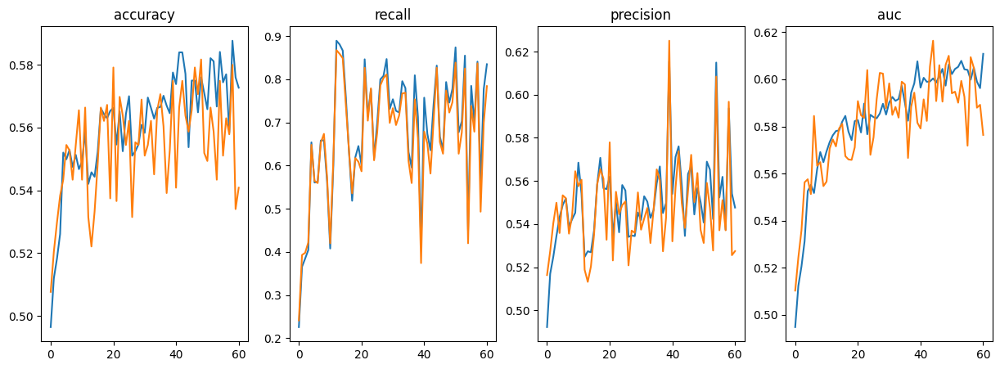

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [61] [ 0/14]  eta: 0:14:10  lr: 0.000068  loss: 0.6610  time: 60.7259  data: 58.3662  max mem: 15188
Train Epoch: [61] [ 6/14]  eta: 0:02:10  lr: 0.000069  loss: 0.6866  time: 16.2948  data: 13.6886  max mem: 15188
Train Epoch: [61] [12/14]  eta: 0:00:28  lr: 0.000069  loss: 0.6485  time: 14.2285  data: 11.5578  max mem: 15188
Train Epoch: [61] [13/14]  eta: 0:00:13  lr: 0.000069  loss: 0.6541  time: 13.3366  data: 10.7323  max mem: 15188
Train Epoch: [61] Total time: 0:03:06 (13.3370 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6727e_eval_time_per_batch: 14.5578


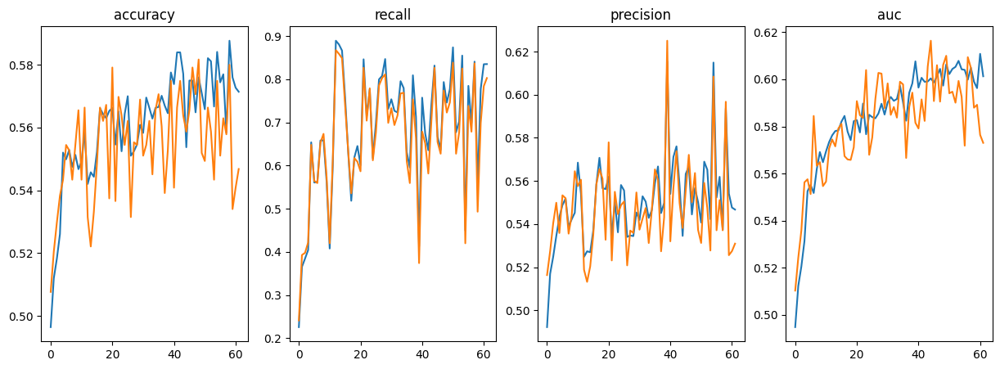

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [62] [ 0/14]  eta: 0:11:55  lr: 0.000070  loss: 0.6607  time: 51.1384  data: 47.8872  max mem: 15188
Train Epoch: [62] [ 6/14]  eta: 0:02:02  lr: 0.000070  loss: 0.6538  time: 15.2786  data: 12.5421  max mem: 15188
Train Epoch: [62] [12/14]  eta: 0:00:30  lr: 0.000070  loss: 0.6392  time: 15.1202  data: 12.4879  max mem: 15188
Train Epoch: [62] [13/14]  eta: 0:00:14  lr: 0.000071  loss: 0.6733  time: 14.2093  data: 11.5959  max mem: 15188
Train Epoch: [62] Total time: 0:03:18 (14.2098 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6724e_eval_time_per_batch: 16.3185


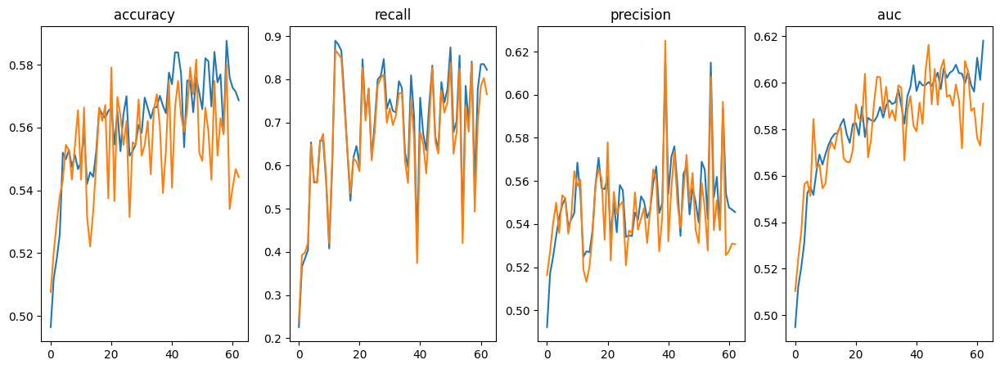

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [63] [ 0/14]  eta: 0:13:49  lr: 0.000071  loss: 0.6583  time: 59.2312  data: 56.6622  max mem: 15188
Train Epoch: [63] [ 6/14]  eta: 0:02:28  lr: 0.000071  loss: 0.6782  time: 18.5898  data: 15.7980  max mem: 15188
Train Epoch: [63] [12/14]  eta: 0:00:37  lr: 0.000072  loss: 0.6337  time: 18.6148  data: 15.8888  max mem: 15188
Train Epoch: [63] [13/14]  eta: 0:00:17  lr: 0.000072  loss: 0.6497  time: 17.4143  data: 14.7539  max mem: 15188
Train Epoch: [63] Total time: 0:04:03 (17.4147 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6721e_eval_time_per_batch: 18.7434


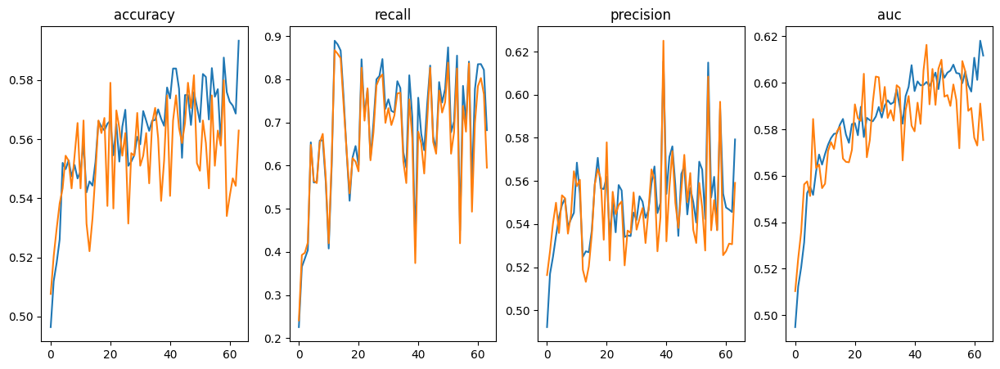

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [64] [ 0/14]  eta: 0:15:05  lr: 0.000072  loss: 0.6598  time: 64.7025  data: 62.2800  max mem: 15188
Train Epoch: [64] [ 6/14]  eta: 0:02:35  lr: 0.000072  loss: 0.6681  time: 19.4227  data: 16.9531  max mem: 15188
Train Epoch: [64] [12/14]  eta: 0:00:35  lr: 0.000073  loss: 0.6691  time: 17.7728  data: 15.1236  max mem: 15188
Train Epoch: [64] [13/14]  eta: 0:00:16  lr: 0.000073  loss: 0.6535  time: 16.6409  data: 14.0433  max mem: 15188
Train Epoch: [64] Total time: 0:03:52 (16.6415 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6719e_eval_time_per_batch: 14.6758


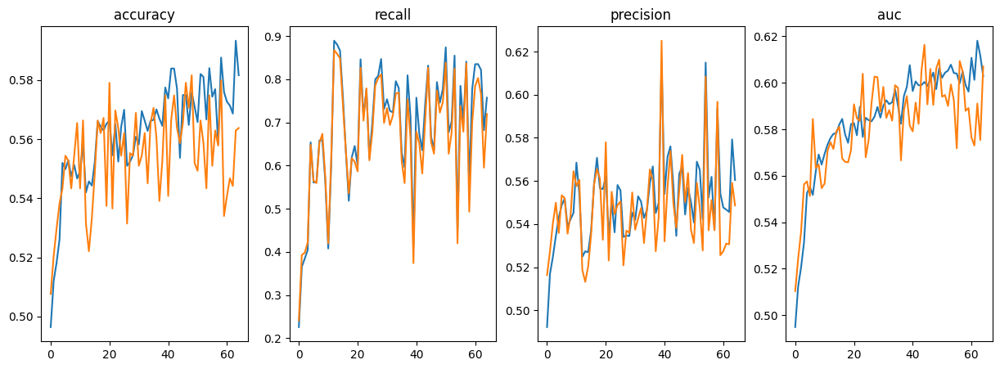

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [65] [ 0/14]  eta: 0:11:31  lr: 0.000073  loss: 0.6369  time: 49.3981  data: 46.9047  max mem: 15188
Train Epoch: [65] [ 6/14]  eta: 0:02:00  lr: 0.000073  loss: 0.6358  time: 15.0040  data: 11.4941  max mem: 15188
Train Epoch: [65] [12/14]  eta: 0:00:29  lr: 0.000074  loss: 0.6919  time: 14.6201  data: 11.5857  max mem: 15188
Train Epoch: [65] [13/14]  eta: 0:00:13  lr: 0.000074  loss: 0.6540  time: 13.7146  data: 10.7582  max mem: 15188
Train Epoch: [65] Total time: 0:03:12 (13.7151 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6716e_eval_time_per_batch: 19.1439


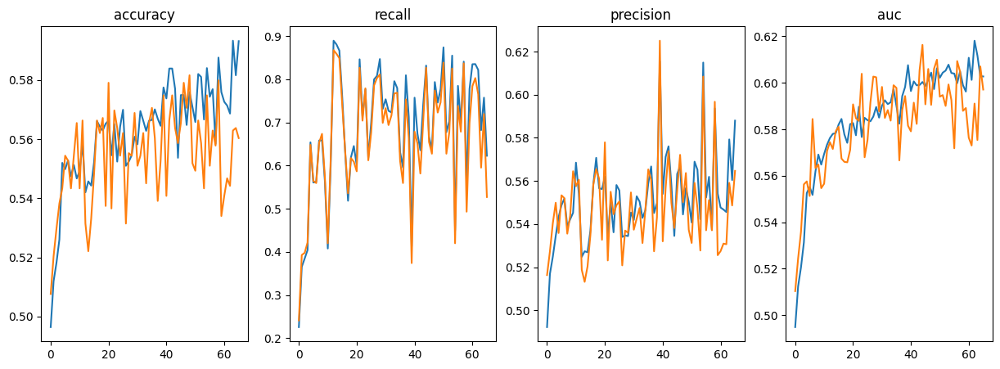

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [66] [ 0/14]  eta: 0:16:12  lr: 0.000074  loss: 0.6557  time: 69.4287  data: 66.7837  max mem: 15188
Train Epoch: [66] [ 6/14]  eta: 0:02:25  lr: 0.000074  loss: 0.6574  time: 18.2060  data: 15.4556  max mem: 15188
Train Epoch: [66] [12/14]  eta: 0:00:30  lr: 0.000075  loss: 0.6536  time: 15.4393  data: 12.7560  max mem: 15188
Train Epoch: [66] [13/14]  eta: 0:00:14  lr: 0.000075  loss: 0.6746  time: 14.4701  data: 11.8448  max mem: 15188
Train Epoch: [66] Total time: 0:03:22 (14.4704 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6714e_eval_time_per_batch: 16.0108


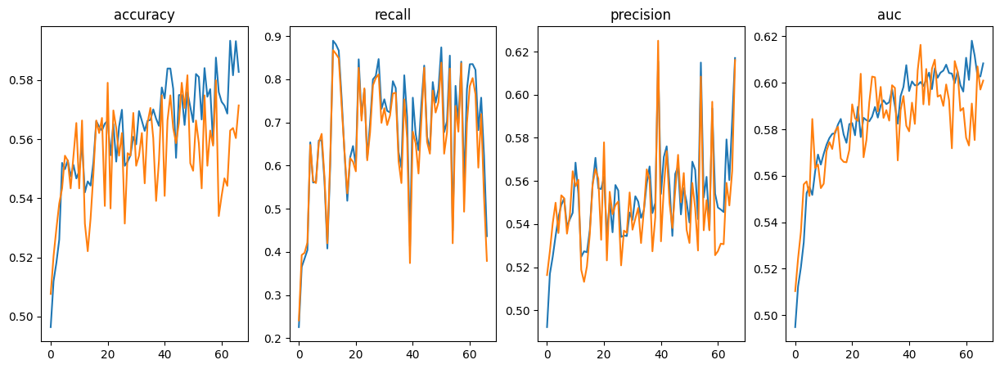

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [67] [ 0/14]  eta: 0:12:09  lr: 0.000075  loss: 0.6433  time: 52.0730  data: 49.6126  max mem: 15188
Train Epoch: [67] [ 6/14]  eta: 0:01:57  lr: 0.000076  loss: 0.6435  time: 14.7217  data: 12.0116  max mem: 15188
Train Epoch: [67] [12/14]  eta: 0:00:27  lr: 0.000076  loss: 0.6537  time: 13.9535  data: 11.2318  max mem: 15188
Train Epoch: [67] [13/14]  eta: 0:00:13  lr: 0.000076  loss: 0.6241  time: 13.0821  data: 10.4295  max mem: 15188
Train Epoch: [67] Total time: 0:03:03 (13.0825 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6711e_eval_time_per_batch: 14.8237


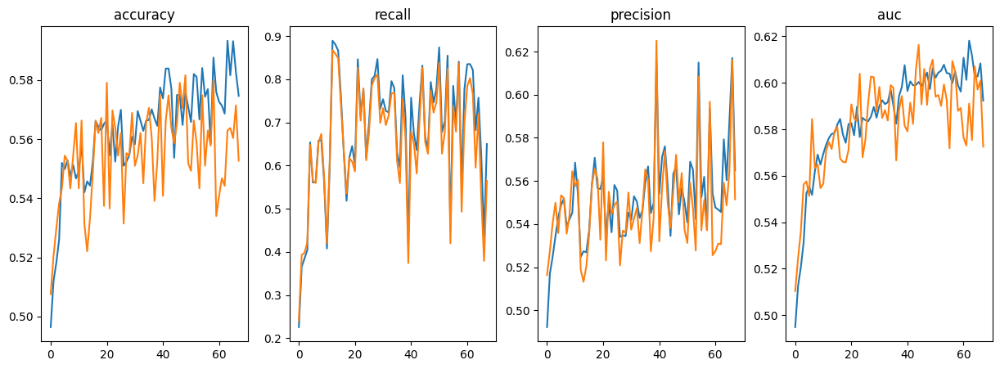

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [68] [ 0/14]  eta: 0:12:22  lr: 0.000076  loss: 0.6404  time: 53.0531  data: 50.3762  max mem: 15188
Train Epoch: [68] [ 6/14]  eta: 0:01:54  lr: 0.000077  loss: 0.6443  time: 14.3590  data: 11.7435  max mem: 15188
Train Epoch: [68] [12/14]  eta: 0:00:26  lr: 0.000077  loss: 0.6368  time: 13.3200  data: 10.6150  max mem: 15188
Train Epoch: [68] [13/14]  eta: 0:00:12  lr: 0.000077  loss: 0.6456  time: 12.4955  data: 9.8567  max mem: 15188
Train Epoch: [68] Total time: 0:02:54 (12.4958 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6709e_eval_time_per_batch: 14.8096


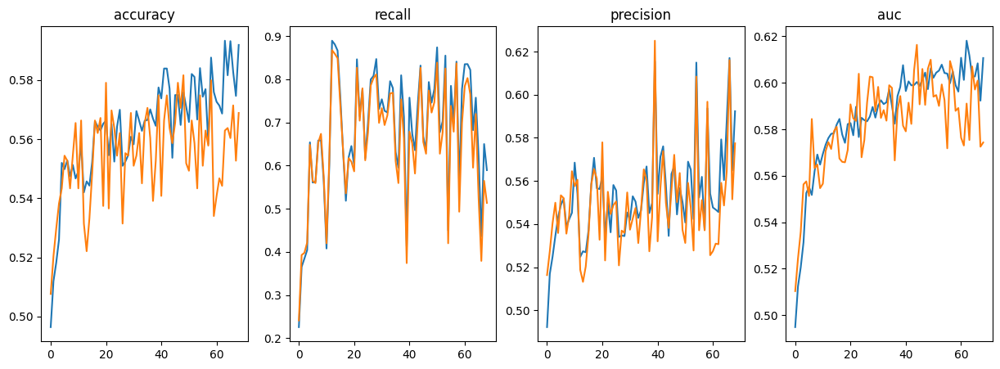

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [69] [ 0/14]  eta: 0:11:14  lr: 0.000077  loss: 0.6459  time: 48.2067  data: 45.4103  max mem: 15188
Train Epoch: [69] [ 6/14]  eta: 0:01:51  lr: 0.000078  loss: 0.6461  time: 13.9098  data: 11.2691  max mem: 15188
Train Epoch: [69] [12/14]  eta: 0:00:25  lr: 0.000078  loss: 0.6794  time: 12.6294  data: 9.8909  max mem: 15188
Train Epoch: [69] [13/14]  eta: 0:00:11  lr: 0.000078  loss: 0.6784  time: 11.8663  data: 9.1844  max mem: 15188
Train Epoch: [69] Total time: 0:02:46 (11.8667 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6708e_eval_time_per_batch: 15.0695


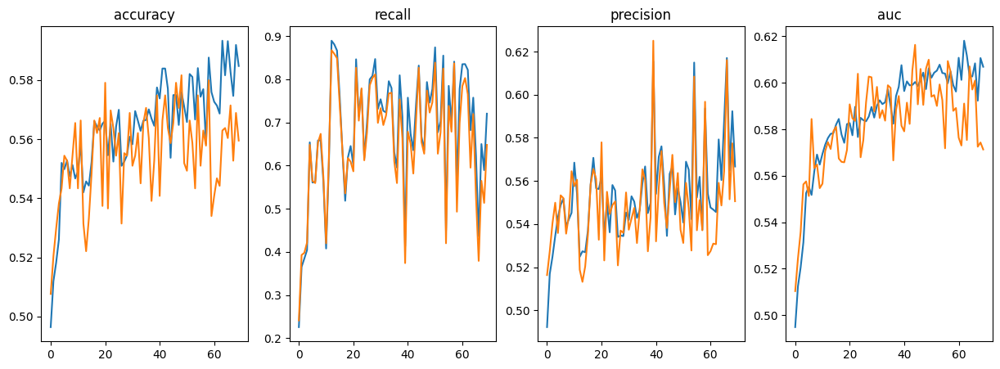

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [70] [ 0/14]  eta: 0:12:57  lr: 0.000078  loss: 0.6413  time: 55.5451  data: 52.2821  max mem: 15188
Train Epoch: [70] [ 6/14]  eta: 0:01:59  lr: 0.000079  loss: 0.6468  time: 14.9372  data: 11.3830  max mem: 15188
Train Epoch: [70] [12/14]  eta: 0:00:27  lr: 0.000079  loss: 0.6572  time: 13.5965  data: 10.4970  max mem: 15188
Train Epoch: [70] [13/14]  eta: 0:00:12  lr: 0.000080  loss: 0.6626  time: 12.7530  data: 9.7473  max mem: 15188
Train Epoch: [70] Total time: 0:02:58 (12.7533 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6706e_eval_time_per_batch: 14.7876


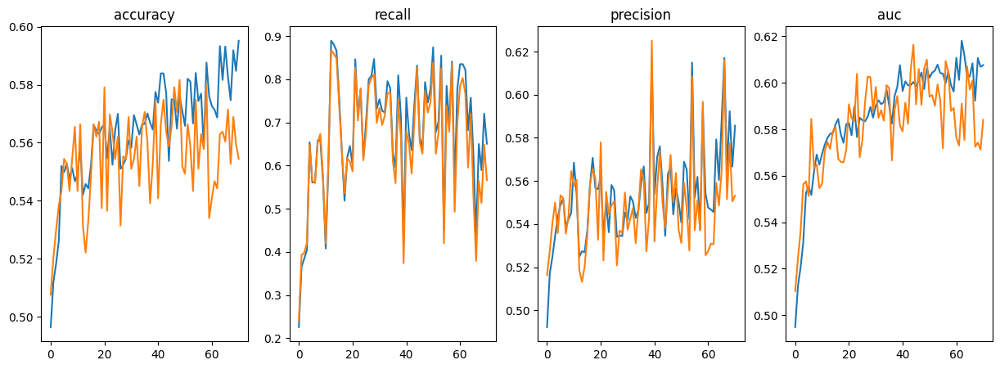

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [71] [ 0/14]  eta: 0:11:20  lr: 0.000080  loss: 0.6567  time: 48.6080  data: 46.0775  max mem: 15188
Train Epoch: [71] [ 6/14]  eta: 0:01:52  lr: 0.000080  loss: 0.6390  time: 14.0664  data: 11.5249  max mem: 15188
Train Epoch: [71] [12/14]  eta: 0:00:26  lr: 0.000081  loss: 0.6604  time: 13.3806  data: 10.7737  max mem: 15188
Train Epoch: [71] [13/14]  eta: 0:00:12  lr: 0.000081  loss: 0.6563  time: 12.5944  data: 10.0042  max mem: 15188
Train Epoch: [71] Total time: 0:02:56 (12.5947 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6703e_eval_time_per_batch: 14.7961


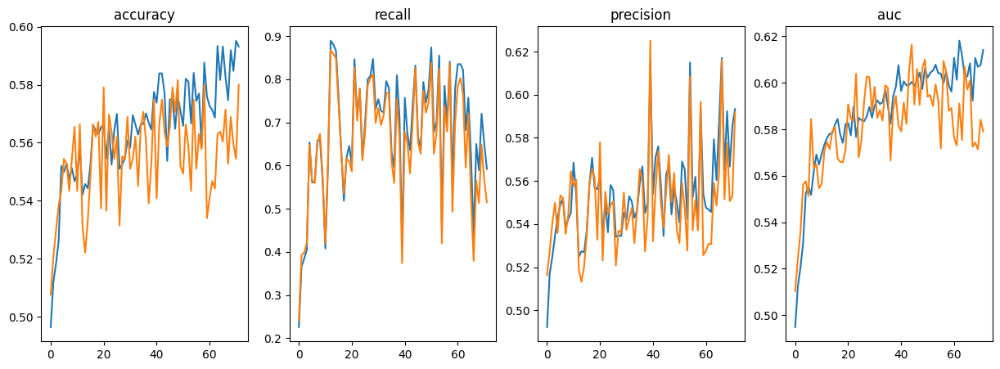

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [72] [ 0/14]  eta: 0:12:17  lr: 0.000081  loss: 0.6759  time: 52.6549  data: 49.3899  max mem: 15188
Train Epoch: [72] [ 6/14]  eta: 0:02:03  lr: 0.000081  loss: 0.6512  time: 15.4293  data: 12.6516  max mem: 15188
Train Epoch: [72] [12/14]  eta: 0:00:27  lr: 0.000082  loss: 0.6403  time: 13.8686  data: 11.1379  max mem: 15188
Train Epoch: [72] [13/14]  eta: 0:00:13  lr: 0.000082  loss: 0.6433  time: 13.0042  data: 10.3424  max mem: 15188
Train Epoch: [72] Total time: 0:03:02 (13.0046 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6700e_eval_time_per_batch: 15.2406


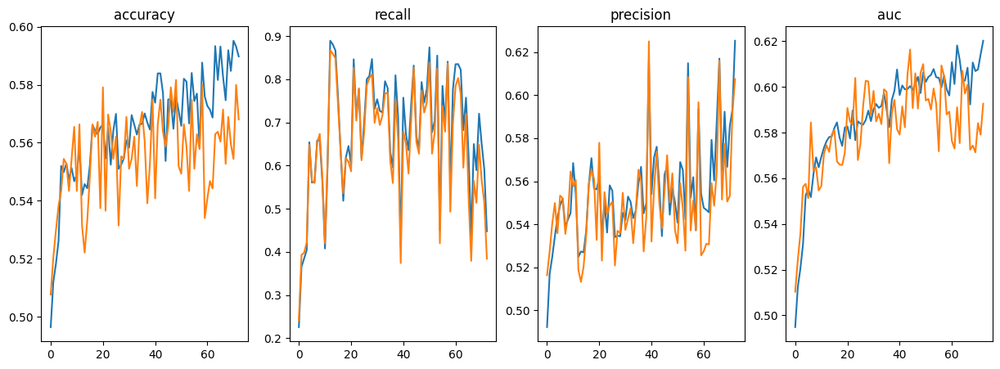

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [73] [ 0/14]  eta: 0:13:22  lr: 0.000082  loss: 0.6501  time: 57.3390  data: 54.7793  max mem: 15188
Train Epoch: [73] [ 6/14]  eta: 0:02:10  lr: 0.000082  loss: 0.6598  time: 16.2817  data: 13.3257  max mem: 15188
Train Epoch: [73] [12/14]  eta: 0:00:28  lr: 0.000083  loss: 0.6442  time: 14.3256  data: 11.5471  max mem: 15188
Train Epoch: [73] [13/14]  eta: 0:00:13  lr: 0.000083  loss: 0.6451  time: 13.4422  data: 10.7223  max mem: 15188
Train Epoch: [73] Total time: 0:03:08 (13.4427 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6697e_eval_time_per_batch: 18.8903


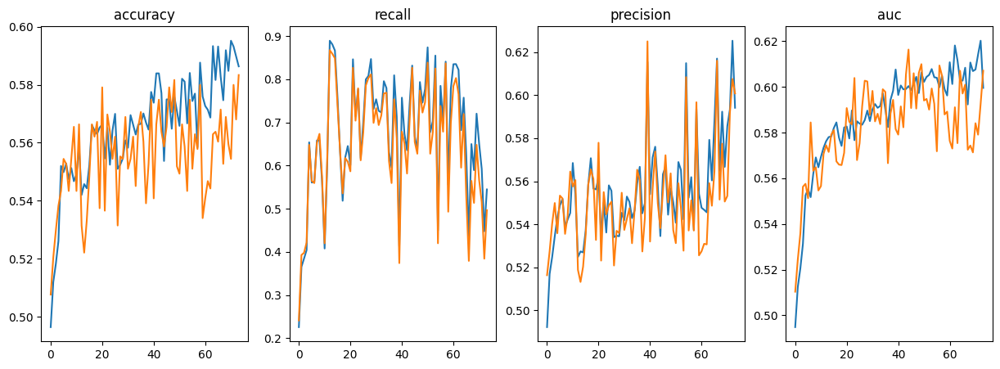

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [74] [ 0/14]  eta: 0:11:48  lr: 0.000083  loss: 0.6688  time: 50.5767  data: 46.7084  max mem: 15188
Train Epoch: [74] [ 6/14]  eta: 0:01:55  lr: 0.000083  loss: 0.6481  time: 14.4229  data: 11.4541  max mem: 15188
Train Epoch: [74] [12/14]  eta: 0:00:27  lr: 0.000084  loss: 0.6356  time: 13.6149  data: 10.9036  max mem: 15188
Train Epoch: [74] [13/14]  eta: 0:00:12  lr: 0.000084  loss: 0.6626  time: 12.7782  data: 10.1248  max mem: 15188
Train Epoch: [74] Total time: 0:02:58 (12.7786 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6695e_eval_time_per_batch: 14.5763


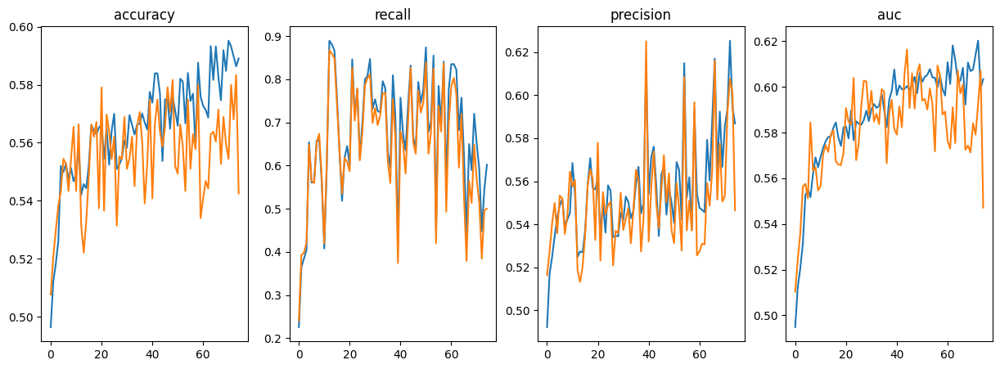

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [75] [ 0/14]  eta: 0:11:17  lr: 0.000084  loss: 0.6526  time: 48.4211  data: 45.7458  max mem: 15188
Train Epoch: [75] [ 6/14]  eta: 0:01:48  lr: 0.000085  loss: 0.6446  time: 13.5932  data: 10.9515  max mem: 15188
Train Epoch: [75] [12/14]  eta: 0:00:26  lr: 0.000085  loss: 0.6534  time: 13.0198  data: 9.9331  max mem: 15188
Train Epoch: [75] [13/14]  eta: 0:00:12  lr: 0.000085  loss: 0.6496  time: 12.2282  data: 9.2236  max mem: 15188
Train Epoch: [75] Total time: 0:02:51 (12.2286 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6692e_eval_time_per_batch: 14.6295


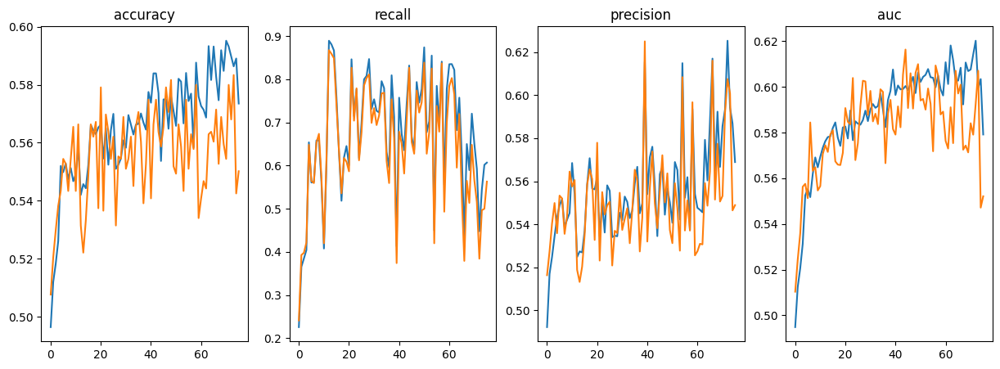

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [76] [ 0/14]  eta: 0:10:34  lr: 0.000085  loss: 0.6437  time: 45.3134  data: 42.7418  max mem: 15188
Train Epoch: [76] [ 6/14]  eta: 0:01:52  lr: 0.000086  loss: 0.6331  time: 14.0074  data: 11.4147  max mem: 15188
Train Epoch: [76] [12/14]  eta: 0:00:25  lr: 0.000086  loss: 0.6430  time: 12.8134  data: 10.2082  max mem: 15188
Train Epoch: [76] [13/14]  eta: 0:00:12  lr: 0.000086  loss: 0.6457  time: 12.0708  data: 9.4791  max mem: 15188
Train Epoch: [76] Total time: 0:02:48 (12.0712 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6689e_eval_time_per_batch: 18.0094


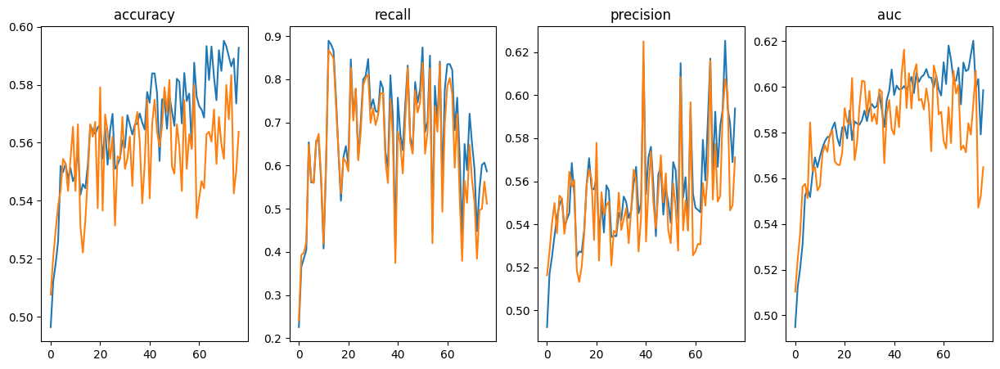

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [77] [ 0/14]  eta: 0:11:18  lr: 0.000086  loss: 0.6572  time: 48.4690  data: 46.0782  max mem: 15188
Train Epoch: [77] [ 6/14]  eta: 0:01:53  lr: 0.000087  loss: 0.6595  time: 14.1348  data: 11.5191  max mem: 15188
Train Epoch: [77] [12/14]  eta: 0:00:26  lr: 0.000087  loss: 0.6237  time: 13.0212  data: 10.3532  max mem: 15188
Train Epoch: [77] [13/14]  eta: 0:00:12  lr: 0.000087  loss: 0.6561  time: 12.2456  data: 9.6136  max mem: 15188
Train Epoch: [77] Total time: 0:02:51 (12.2460 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6686e_eval_time_per_batch: 14.5232


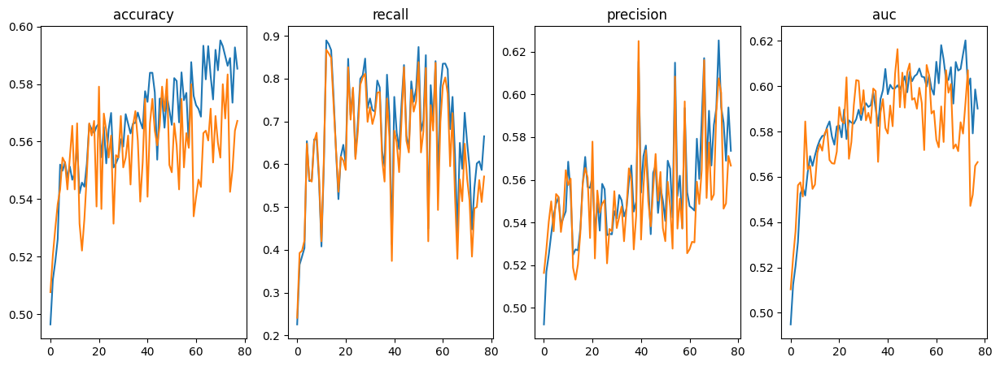

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [78] [ 0/14]  eta: 0:11:11  lr: 0.000087  loss: 0.6473  time: 47.9898  data: 45.5113  max mem: 15188
Train Epoch: [78] [ 6/14]  eta: 0:01:55  lr: 0.000088  loss: 0.6620  time: 14.4563  data: 11.9473  max mem: 15188
Train Epoch: [78] [12/14]  eta: 0:00:27  lr: 0.000088  loss: 0.6825  time: 13.6335  data: 11.0118  max mem: 15188
Train Epoch: [78] [13/14]  eta: 0:00:12  lr: 0.000088  loss: 0.6474  time: 12.7859  data: 10.2253  max mem: 15188
Train Epoch: [78] Total time: 0:02:59 (12.7863 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6684e_eval_time_per_batch: 14.6348


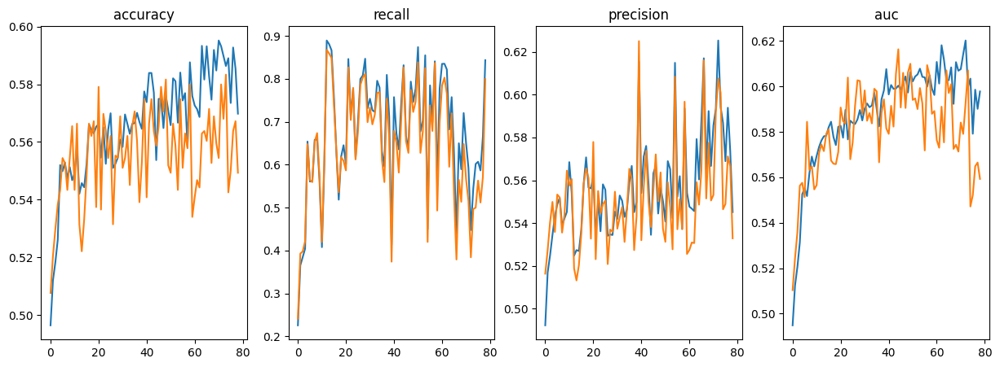

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [79] [ 0/14]  eta: 0:11:23  lr: 0.000089  loss: 0.6785  time: 48.7920  data: 46.0128  max mem: 15188
Train Epoch: [79] [ 6/14]  eta: 0:01:52  lr: 0.000089  loss: 0.6608  time: 14.0968  data: 11.2787  max mem: 15188
Train Epoch: [79] [12/14]  eta: 0:00:26  lr: 0.000090  loss: 0.6466  time: 13.1990  data: 10.4299  max mem: 15188
Train Epoch: [79] [13/14]  eta: 0:00:12  lr: 0.000090  loss: 0.6378  time: 12.3849  data: 9.6849  max mem: 15188
Train Epoch: [79] Total time: 0:02:53 (12.3853 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6682e_eval_time_per_batch: 14.5673


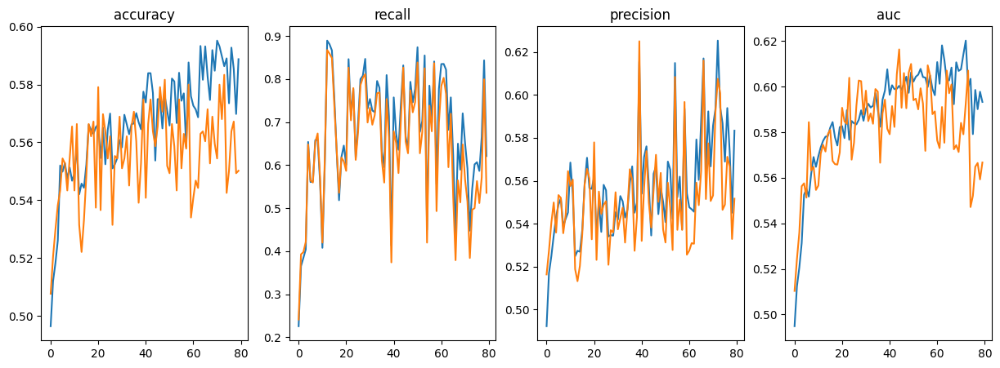

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [80] [ 0/14]  eta: 0:10:50  lr: 0.000090  loss: 0.6477  time: 46.4306  data: 43.7488  max mem: 15188
Train Epoch: [80] [ 6/14]  eta: 0:01:48  lr: 0.000090  loss: 0.6556  time: 13.5421  data: 10.8899  max mem: 15188
Train Epoch: [80] [12/14]  eta: 0:00:24  lr: 0.000091  loss: 0.6732  time: 12.1040  data: 8.9288  max mem: 15188
Train Epoch: [80] [13/14]  eta: 0:00:11  lr: 0.000091  loss: 0.6507  time: 11.3785  data: 8.2910  max mem: 15188
Train Epoch: [80] Total time: 0:02:39 (11.3789 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6679e_eval_time_per_batch: 14.7579


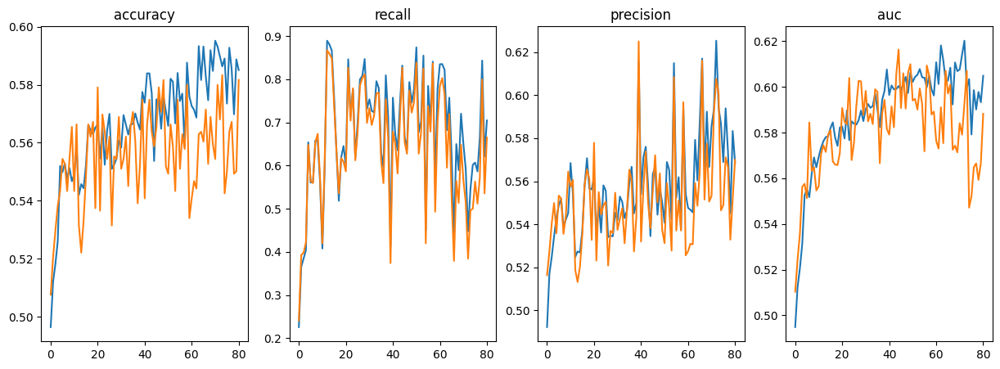

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [81] [ 0/14]  eta: 0:11:26  lr: 0.000091  loss: 0.6436  time: 49.0198  data: 46.4132  max mem: 15188
Train Epoch: [81] [ 6/14]  eta: 0:01:53  lr: 0.000091  loss: 0.6492  time: 14.2045  data: 11.4714  max mem: 15188
Train Epoch: [81] [12/14]  eta: 0:00:26  lr: 0.000092  loss: 0.6574  time: 13.3098  data: 10.6301  max mem: 15188
Train Epoch: [81] [13/14]  eta: 0:00:12  lr: 0.000092  loss: 0.6440  time: 12.5010  data: 9.8709  max mem: 15188
Train Epoch: [81] Total time: 0:02:55 (12.5014 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6676e_eval_time_per_batch: 38.41764


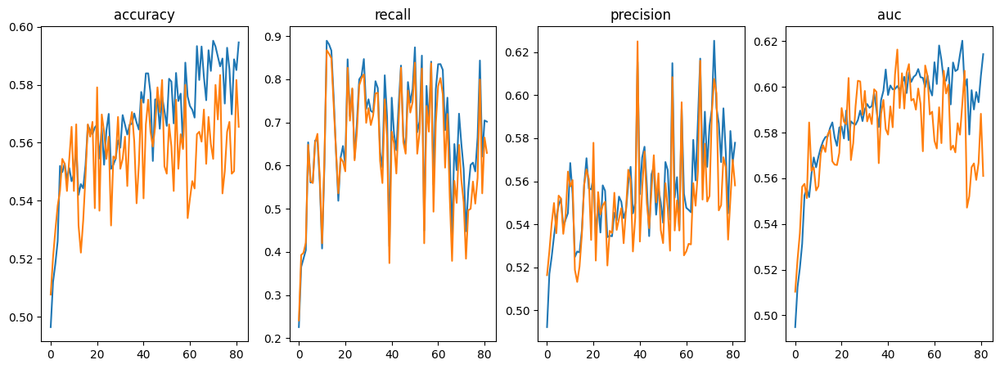

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [82] [ 0/14]  eta: 0:09:49  lr: 0.000092  loss: 0.6587  time: 42.0843  data: 39.7048  max mem: 15188
Train Epoch: [82] [ 6/14]  eta: 0:01:38  lr: 0.000092  loss: 0.6254  time: 12.3540  data: 9.6958  max mem: 15188
Train Epoch: [82] [12/14]  eta: 0:00:23  lr: 0.000093  loss: 0.6472  time: 11.6965  data: 8.9196  max mem: 15188
Train Epoch: [82] [13/14]  eta: 0:00:10  lr: 0.000093  loss: 0.6591  time: 10.9995  data: 8.2825  max mem: 15188
Train Epoch: [82] Total time: 0:02:33 (10.9999 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6674e_eval_time_per_batch: 14.6555


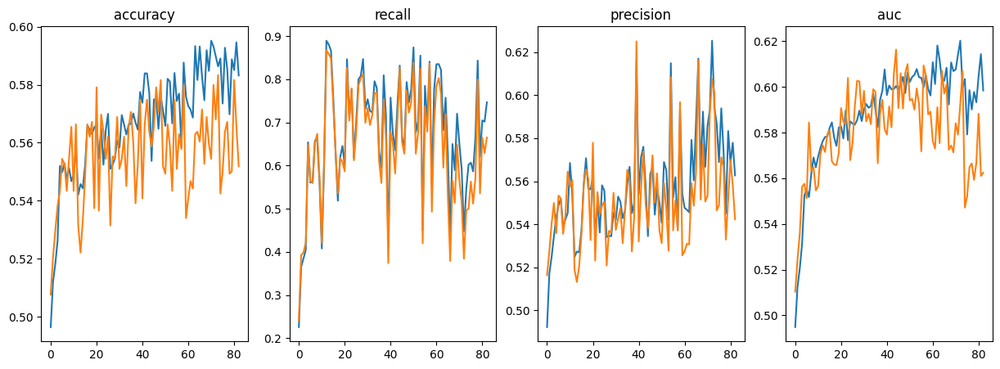

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [83] [ 0/14]  eta: 0:19:19  lr: 0.000093  loss: 0.6360  time: 82.8448  data: 80.2988  max mem: 15188
Train Epoch: [83] [ 6/14]  eta: 0:02:43  lr: 0.000094  loss: 0.6365  time: 20.3970  data: 17.6646  max mem: 15188
Train Epoch: [83] [12/14]  eta: 0:00:33  lr: 0.000094  loss: 0.6500  time: 16.9245  data: 14.2289  max mem: 15188
Train Epoch: [83] [13/14]  eta: 0:00:15  lr: 0.000094  loss: 0.6439  time: 15.8534  data: 13.2125  max mem: 15188
Train Epoch: [83] Total time: 0:03:41 (15.8538 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6671e_eval_time_per_batch: 14.6882


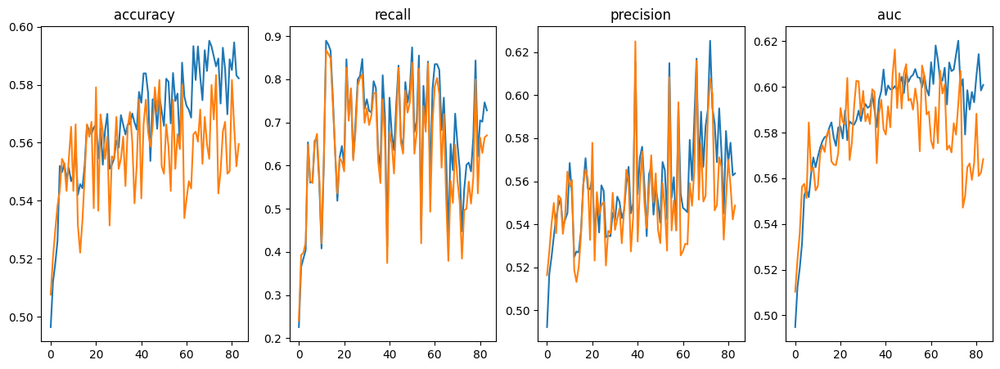

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [84] [ 0/14]  eta: 0:13:00  lr: 0.000094  loss: 0.6382  time: 55.7177  data: 53.2700  max mem: 15188
Train Epoch: [84] [ 6/14]  eta: 0:02:11  lr: 0.000095  loss: 0.6558  time: 16.4175  data: 13.8124  max mem: 15188
Train Epoch: [84] [12/14]  eta: 0:00:31  lr: 0.000095  loss: 0.6502  time: 15.6023  data: 12.9433  max mem: 15188
Train Epoch: [84] [13/14]  eta: 0:00:14  lr: 0.000095  loss: 0.6485  time: 14.6177  data: 12.0188  max mem: 15188
Train Epoch: [84] Total time: 0:03:24 (14.6181 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6669e_eval_time_per_batch: 48.24116


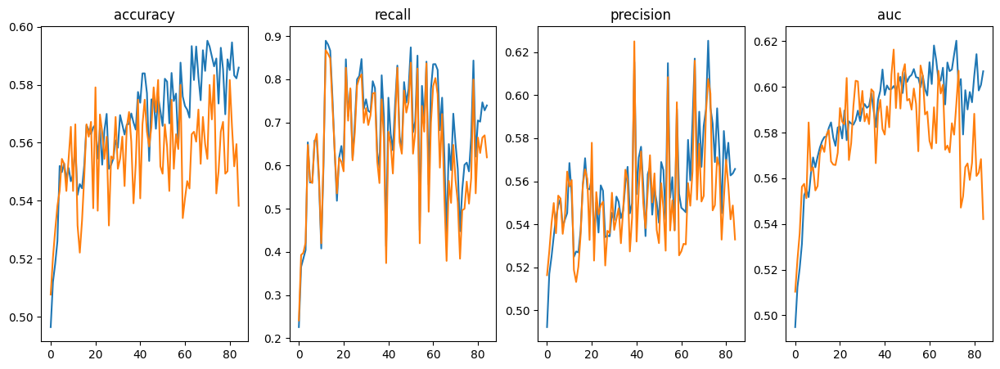

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [85] [ 0/14]  eta: 0:18:46  lr: 0.000095  loss: 0.6580  time: 80.4462  data: 77.9615  max mem: 15188
Train Epoch: [85] [ 6/14]  eta: 0:02:56  lr: 0.000096  loss: 0.6469  time: 22.1226  data: 19.5618  max mem: 15188
Train Epoch: [85] [12/14]  eta: 0:00:40  lr: 0.000096  loss: 0.6399  time: 20.0003  data: 17.3309  max mem: 15188
Train Epoch: [85] [13/14]  eta: 0:00:18  lr: 0.000096  loss: 0.6339  time: 18.7440  data: 16.0930  max mem: 15188
Train Epoch: [85] Total time: 0:04:22 (18.7444 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6666e_eval_time_per_batch: 14.5694


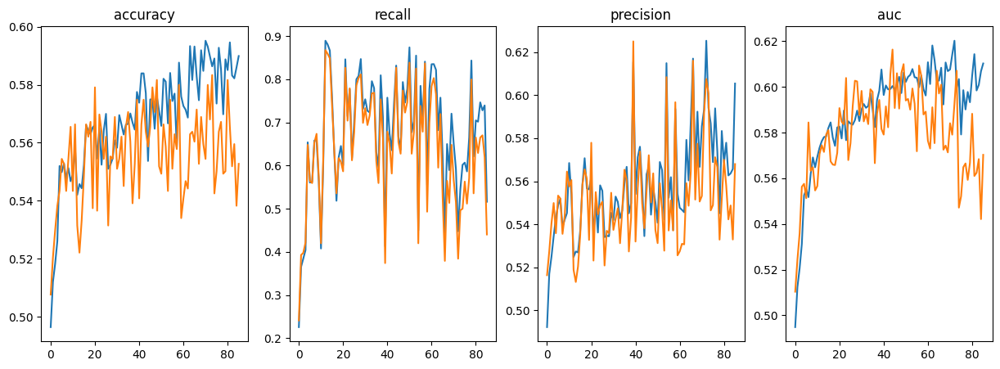

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [86] [ 0/14]  eta: 0:13:20  lr: 0.000096  loss: 0.6560  time: 57.1656  data: 54.8022  max mem: 15188
Train Epoch: [86] [ 6/14]  eta: 0:02:13  lr: 0.000097  loss: 0.6579  time: 16.7078  data: 14.0295  max mem: 15188
Train Epoch: [86] [12/14]  eta: 0:00:31  lr: 0.000097  loss: 0.6448  time: 15.5684  data: 12.9081  max mem: 15188
Train Epoch: [86] [13/14]  eta: 0:00:14  lr: 0.000097  loss: 0.6676  time: 14.5830  data: 11.9861  max mem: 15188
Train Epoch: [86] Total time: 0:03:24 (14.5835 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6664e_eval_time_per_batch: 14.4225


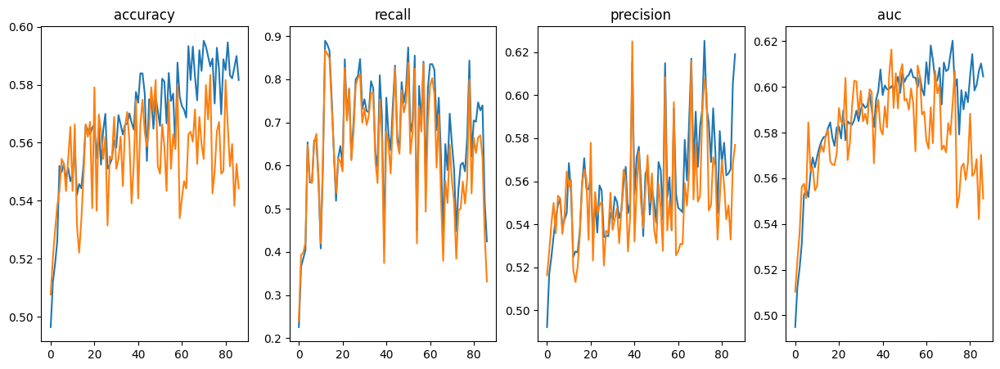

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [87] [ 0/14]  eta: 0:13:08  lr: 0.000098  loss: 0.6809  time: 56.3022  data: 53.7227  max mem: 15188
Train Epoch: [87] [ 6/14]  eta: 0:02:10  lr: 0.000098  loss: 0.6592  time: 16.2792  data: 13.5405  max mem: 15188
Train Epoch: [87] [12/14]  eta: 0:00:29  lr: 0.000098  loss: 0.6290  time: 14.8720  data: 12.1585  max mem: 15188
Train Epoch: [87] [13/14]  eta: 0:00:13  lr: 0.000099  loss: 0.6295  time: 13.9448  data: 11.2900  max mem: 15188
Train Epoch: [87] Total time: 0:03:15 (13.9451 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6662e_eval_time_per_batch: 14.7381


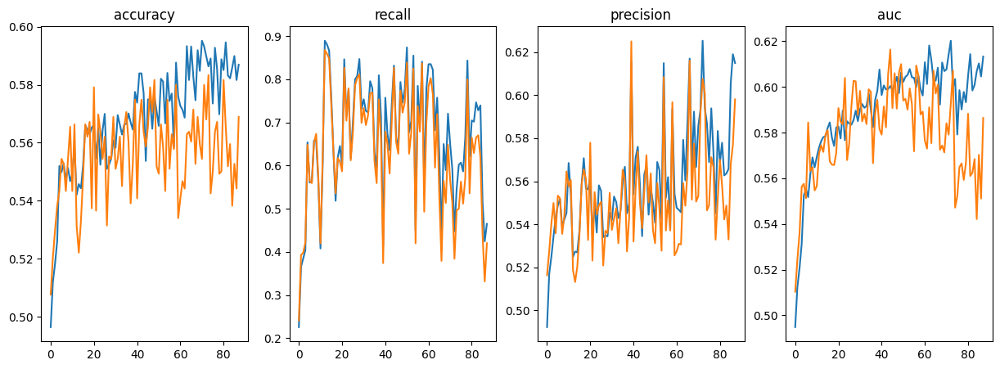

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [88] [ 0/14]  eta: 0:12:46  lr: 0.000099  loss: 0.6525  time: 54.7781  data: 52.4233  max mem: 15188
Train Epoch: [88] [ 6/14]  eta: 0:02:04  lr: 0.000099  loss: 0.6598  time: 15.6073  data: 13.1150  max mem: 15188
Train Epoch: [88] [12/14]  eta: 0:00:29  lr: 0.000100  loss: 0.6549  time: 14.5418  data: 11.8289  max mem: 15188
Train Epoch: [88] [13/14]  eta: 0:00:13  lr: 0.000100  loss: 0.6268  time: 13.6356  data: 10.9840  max mem: 15188
Train Epoch: [88] Total time: 0:03:10 (13.6361 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0000  loss: 0.6659e_eval_time_per_batch: 14.6132


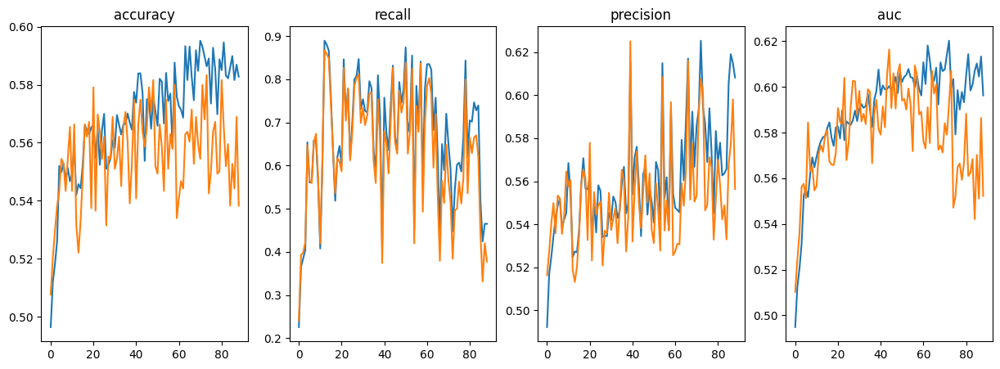

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [89] [ 0/14]  eta: 0:12:26  lr: 0.000100  loss: 0.6596  time: 53.2913  data: 50.7109  max mem: 15188
Train Epoch: [89] [ 6/14]  eta: 0:02:03  lr: 0.000100  loss: 0.6242  time: 15.3820  data: 12.6827  max mem: 15188
Train Epoch: [89] [12/14]  eta: 0:00:28  lr: 0.000101  loss: 0.6378  time: 14.2075  data: 11.5157  max mem: 15188
Train Epoch: [89] [13/14]  eta: 0:00:13  lr: 0.000101  loss: 0.6599  time: 13.3214  data: 10.6932  max mem: 15188
Train Epoch: [89] Total time: 0:03:06 (13.3218 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0001  loss: 0.6657e_eval_time_per_batch: 14.2731


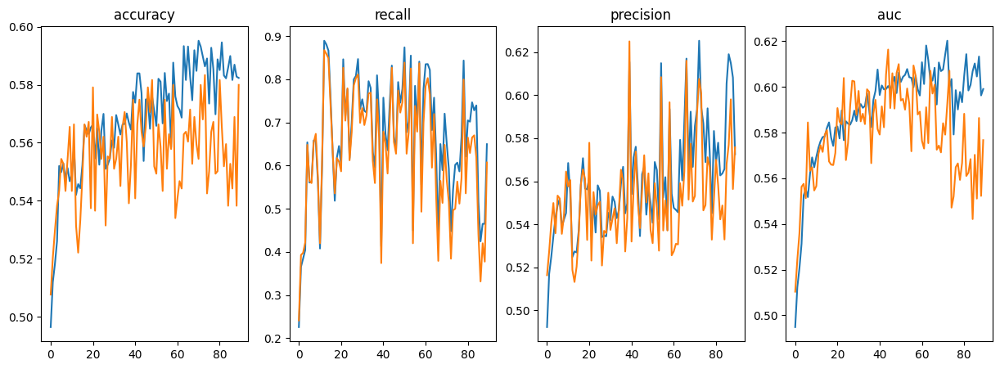

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [90] [ 0/14]  eta: 0:12:45  lr: 0.000101  loss: 0.6251  time: 54.6824  data: 52.1170  max mem: 15188
Train Epoch: [90] [ 6/14]  eta: 0:02:02  lr: 0.000101  loss: 0.6176  time: 15.2694  data: 12.5274  max mem: 15188
Train Epoch: [90] [12/14]  eta: 0:00:27  lr: 0.000102  loss: 0.6499  time: 13.7714  data: 10.9794  max mem: 15188
Train Epoch: [90] [13/14]  eta: 0:00:12  lr: 0.000102  loss: 0.6582  time: 12.9188  data: 10.1952  max mem: 15188
Train Epoch: [90] Total time: 0:03:00 (12.9191 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0001  loss: 0.6654e_eval_time_per_batch: 14.3779


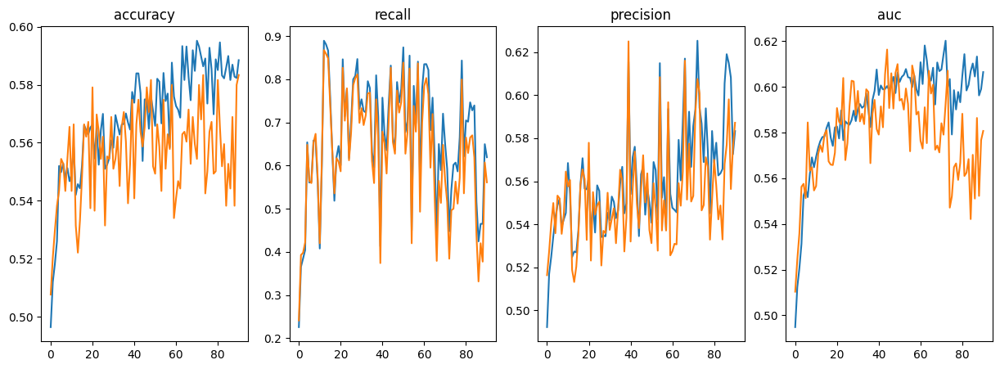

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [91] [ 0/14]  eta: 0:13:07  lr: 0.000102  loss: 0.6435  time: 56.2631  data: 53.5941  max mem: 15188
Train Epoch: [91] [ 6/14]  eta: 0:05:13  lr: 0.000102  loss: 0.6431  time: 39.2260  data: 36.5038  max mem: 15188
Train Epoch: [91] [12/14]  eta: 0:01:09  lr: 0.000103  loss: 0.6422  time: 34.6045  data: 31.9260  max mem: 15188
Train Epoch: [91] [13/14]  eta: 0:00:32  lr: 0.000103  loss: 0.6243  time: 32.3055  data: 29.6457  max mem: 15188
Train Epoch: [91] Total time: 0:07:32 (32.3059 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0001  loss: 0.6651e_eval_time_per_batch: 14.4018


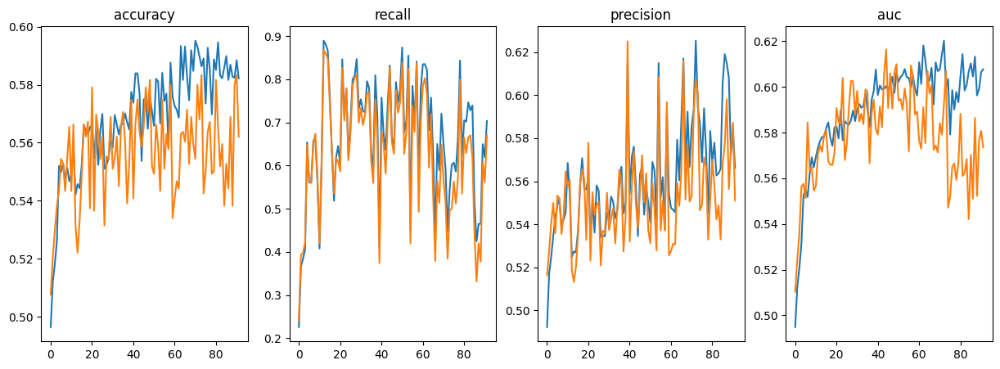

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [92] [ 0/14]  eta: 0:59:46  lr: 0.000103  loss: 0.6197  time: 256.1501  data: 248.1673  max mem: 15188
Train Epoch: [92] [ 6/14]  eta: 0:07:00  lr: 0.000104  loss: 0.6338  time: 52.5055  data: 49.1010  max mem: 15188
Train Epoch: [92] [12/14]  eta: 0:01:11  lr: 0.000104  loss: 0.6297  time: 35.6146  data: 32.4993  max mem: 15188
Train Epoch: [92] [13/14]  eta: 0:00:33  lr: 0.000104  loss: 0.6387  time: 33.2001  data: 30.1779  max mem: 15188
Train Epoch: [92] Total time: 0:07:44 (33.2005 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0001  loss: 0.6649e_eval_time_per_batch: 14.4516


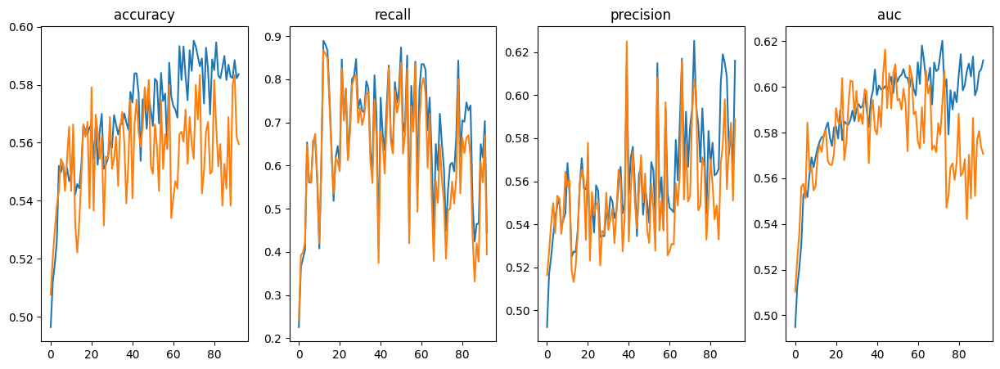

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [93] [ 0/14]  eta: 0:13:33  lr: 0.000104  loss: 0.6544  time: 58.0779  data: 55.4295  max mem: 15188
Train Epoch: [93] [ 6/14]  eta: 0:02:08  lr: 0.000105  loss: 0.6554  time: 16.0495  data: 13.3898  max mem: 15188
Train Epoch: [93] [12/14]  eta: 0:00:29  lr: 0.000105  loss: 0.6445  time: 14.9308  data: 12.2125  max mem: 15188
Train Epoch: [93] [13/14]  eta: 0:00:13  lr: 0.000105  loss: 0.6317  time: 13.9899  data: 11.3401  max mem: 15188
Train Epoch: [93] Total time: 0:03:15 (13.9903 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0001  loss: 0.6647e_eval_time_per_batch: 14.6058


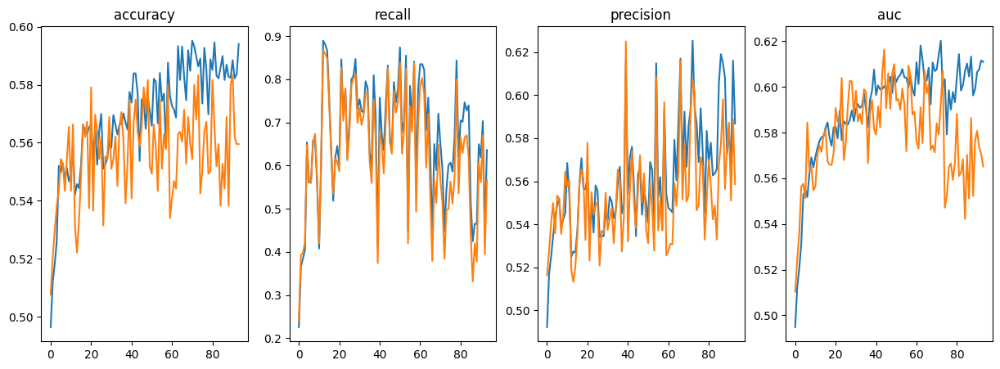

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [94] [ 0/14]  eta: 0:14:38  lr: 0.000105  loss: 0.6176  time: 62.7195  data: 60.2535  max mem: 15188
Train Epoch: [94] [ 6/14]  eta: 0:02:18  lr: 0.000106  loss: 0.6183  time: 17.3635  data: 14.5857  max mem: 15188
Train Epoch: [94] [12/14]  eta: 0:00:33  lr: 0.000106  loss: 0.6399  time: 16.5289  data: 13.7514  max mem: 15188
Train Epoch: [94] [13/14]  eta: 0:00:15  lr: 0.000106  loss: 0.6320  time: 15.4760  data: 12.7692  max mem: 15188
Train Epoch: [94] Total time: 0:03:36 (15.4764 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0001  loss: 0.6644e_eval_time_per_batch: 14.6663


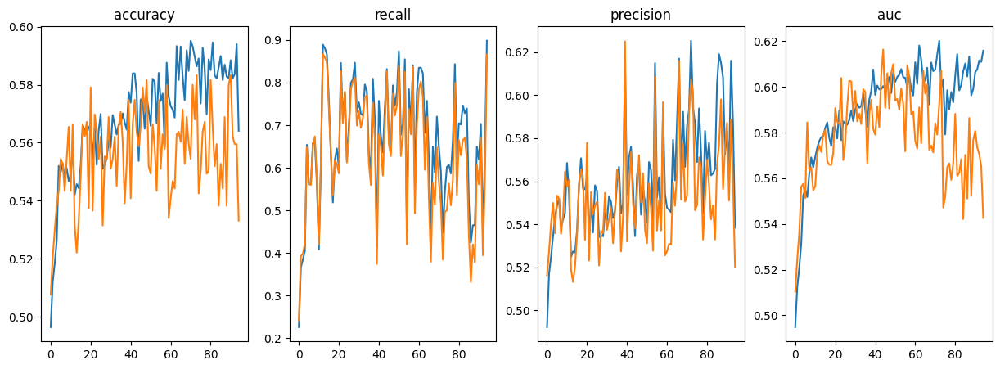

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [95] [ 0/14]  eta: 0:15:27  lr: 0.000106  loss: 0.6348  time: 66.2784  data: 63.4849  max mem: 15188
Train Epoch: [95] [ 6/14]  eta: 0:02:31  lr: 0.000107  loss: 0.6371  time: 18.9180  data: 16.3716  max mem: 15188
Train Epoch: [95] [12/14]  eta: 0:00:35  lr: 0.000107  loss: 0.6658  time: 17.6269  data: 14.9319  max mem: 15188
Train Epoch: [95] [13/14]  eta: 0:00:16  lr: 0.000108  loss: 0.6209  time: 16.5021  data: 13.8653  max mem: 15188
Train Epoch: [95] Total time: 0:03:51 (16.5024 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0001  loss: 0.6642e_eval_time_per_batch: 14.4241


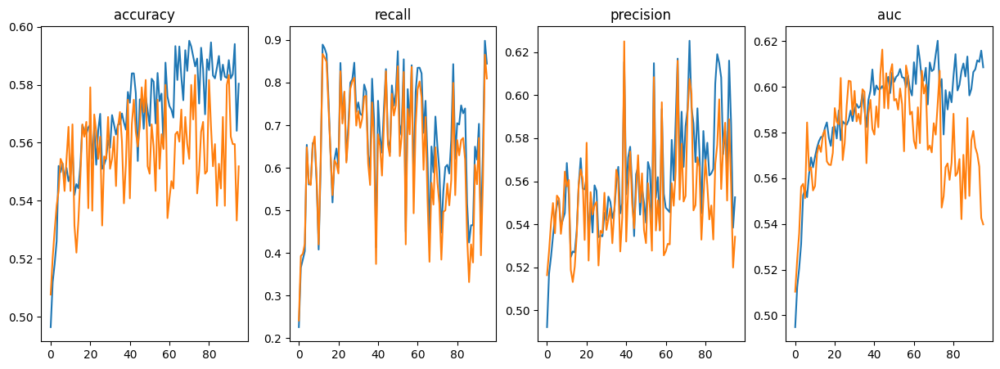

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [96] [ 0/14]  eta: 0:15:19  lr: 0.000108  loss: 0.6432  time: 65.7030  data: 62.7348  max mem: 15188
Train Epoch: [96] [ 6/14]  eta: 0:02:27  lr: 0.000108  loss: 0.6226  time: 18.3945  data: 15.6074  max mem: 15188
Train Epoch: [96] [12/14]  eta: 0:00:34  lr: 0.000109  loss: 0.6314  time: 17.1530  data: 14.4313  max mem: 15188
Train Epoch: [96] [13/14]  eta: 0:00:16  lr: 0.000109  loss: 0.6300  time: 16.0531  data: 13.4005  max mem: 15188
Train Epoch: [96] Total time: 0:03:44 (16.0534 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0001  loss: 0.6639e_eval_time_per_batch: 14.3671


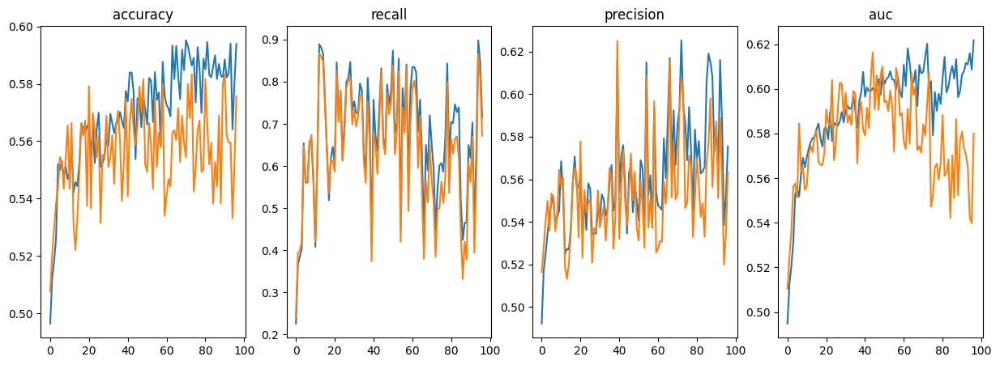

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [97] [ 0/14]  eta: 0:19:48  lr: 0.000109  loss: 0.6186  time: 84.8611  data: 82.4907  max mem: 15188
Train Epoch: [97] [ 6/14]  eta: 0:03:19  lr: 0.000109  loss: 0.6327  time: 24.9257  data: 22.2701  max mem: 15188
Train Epoch: [97] [12/14]  eta: 0:00:49  lr: 0.000110  loss: 0.6384  time: 24.6529  data: 21.5806  max mem: 15188
Train Epoch: [97] [13/14]  eta: 0:00:23  lr: 0.000110  loss: 0.6278  time: 23.0187  data: 20.0391  max mem: 15188
Train Epoch: [97] Total time: 0:05:22 (23.0191 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0001  loss: 0.6636e_eval_time_per_batch: 14.8583


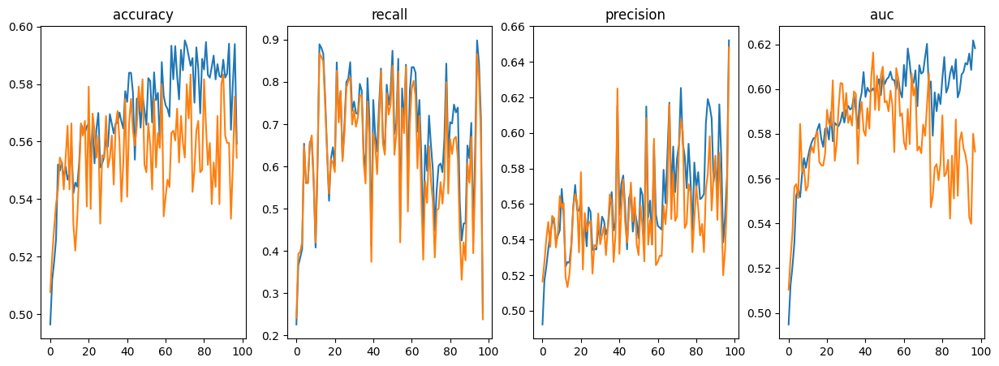

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [98] [ 0/14]  eta: 0:20:36  lr: 0.000110  loss: 0.6831  time: 88.3496  data: 85.9831  max mem: 15188
Train Epoch: [98] [ 6/14]  eta: 0:03:19  lr: 0.000110  loss: 0.6477  time: 24.9902  data: 22.4058  max mem: 15188
Train Epoch: [98] [12/14]  eta: 0:00:50  lr: 0.000111  loss: 0.6585  time: 25.1220  data: 22.5260  max mem: 15188
Train Epoch: [98] [13/14]  eta: 0:00:23  lr: 0.000111  loss: 0.6536  time: 23.5005  data: 20.9170  max mem: 15188
Train Epoch: [98] Total time: 0:05:29 (23.5009 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0001  loss: 0.6635e_eval_time_per_batch: 14.4515


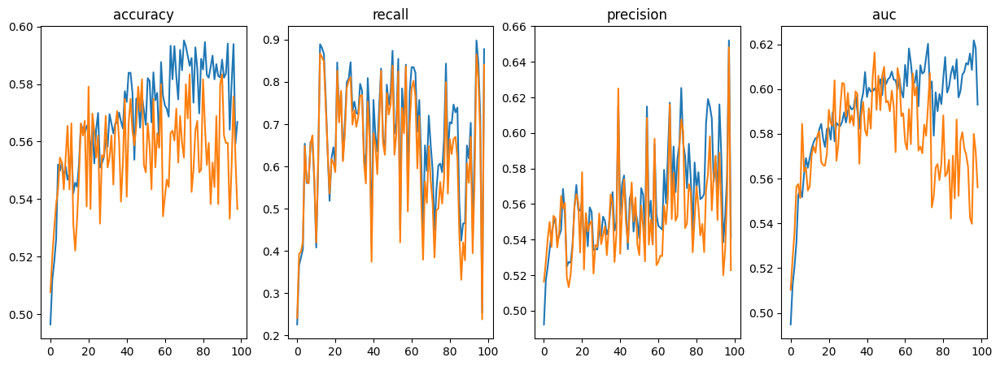

/home/kh3074/anaconda3/lib/python3.10/site-packages/torch/nn/parallel/_functions.py:68: UserWarning: Was asked to gather along dimension 0, but all input tensors were scalars; will instead unsqueeze and return a vector.
  warnings.warn('Was asked to gather along dimension 0, but all '


Train Epoch: [99] [ 0/14]  eta: 0:42:43  lr: 0.000111  loss: 0.6382  time: 183.1099  data: 180.6136  max mem: 15188
Train Epoch: [99] [ 6/14]  eta: 0:05:41  lr: 0.000111  loss: 0.6367  time: 42.6926  data: 39.9798  max mem: 15188
Train Epoch: [99] [12/14]  eta: 0:01:18  lr: 0.000112  loss: 0.6327  time: 39.0401  data: 36.3595  max mem: 15188
Train Epoch: [99] [13/14]  eta: 0:00:36  lr: 0.000112  loss: 0.6607  time: 36.4194  data: 33.7624  max mem: 15188
Train Epoch: [99] Total time: 0:08:29 (36.4198 s / it)
start eval on train dataset ---------------------------------------------
start eval on validation dataset ---------------------------------------------
Averaged stats: lr: 0.0001  loss: 0.6633e_eval_time_per_batch: 14.5302


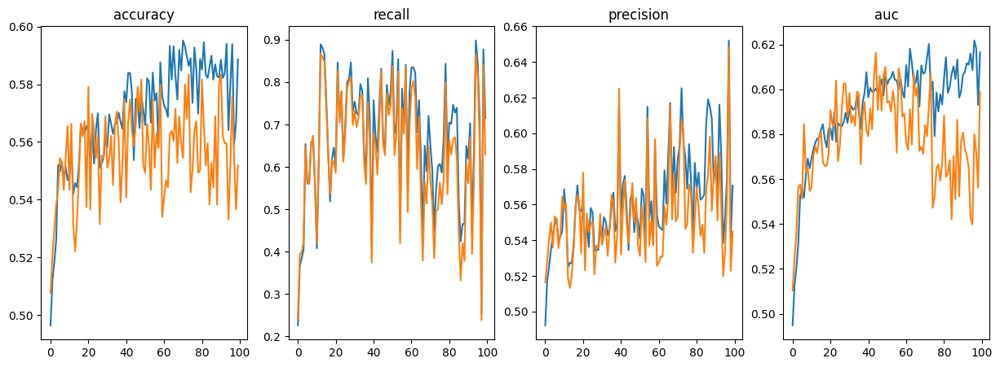

In [11]:
# trainging loop for cls head

# for each epoch: 
# 1: create a downsampled training data loader with random seed.
# 2: model.train:   train one epoch
# 3: evaluate model.eval():  (1): eval on balanced training dataset, 
                            #(2): eval on balanced val() dataset, 
                            #(3):eval on full val dataset ❌
        
# 4: model.save: preserve the model with highest eval performance



metric_logger = utils.MetricLogger(delimiter="  ")
metric_logger.add_meter('lr', utils.SmoothedValue(window_size=50, fmt='{value:.6f}'))
metric_logger.add_meter('loss', utils.SmoothedValue(window_size=50, fmt='{value:.4f}'))
 
print_freq = 6
train_accuracys = []
train_recalls = []
train_precisions = []
train_aucs = []
train_auc_precisions = []
train_auc_recalls = []
val_accuracys = []
val_recalls = []
val_precisions = []
val_aucs = []
val_auc_precisions = []
val_auc_recalls = []

top_models = []
# dirs
#os.makedirs('/mnt/swordfish-pool2/kh3074/train_cls_head_first/evaluate_results')
#os.makedirs('/mnt/swordfish-pool2/kh3074/train_cls_head_first/save_models')
#os.makedirs('/mnt/swordfish-pool2/kh3074/train_cls_head_first/trained_cls_head_model')
model_save_dir = '/mnt/swordfish-pool2/kh3074/train_cls_head_first/trained_cls_head_model'
log_save_dir = '/mnt/swordfish-pool2/kh3074/train_cls_head_first/evaluate_results'


print('Start training!!')
for epoch in range(num_epoch):
    # start new epoch of training
    my_nvlr_model.train()
    for param in my_nvlr_model.parameters():
        param.requires_grad = False
    for param in my_nvlr_model.module.cls_head.parameters():
    #for param in my_nvlr_model.cls_head.parameters():
        param.requires_grad = True
    
    train_data_loader = create_down_sample_dataloader(train_csv, epoch, train_batch_size, 
                              train_transform,evaluation = False) # use epoch as random seed
    header = 'Train Epoch: [{}]'.format(epoch) 
    for i, (image0, image1, text, targets) in enumerate(metric_logger.log_every(train_data_loader, print_freq, header)):
        images = torch.cat([image0, image1], dim=0)
        images, targets = images.to(device), targets.to(device)   

        text_inputs = tokenizer(text, padding='longest', return_tensors="pt").to(device)  

        loss = my_nvlr_model(images, text_inputs.input_ids, text_inputs.attention_mask, targets=targets, train=True)
        loss = loss.mean() # aggregate loss from different GPUs
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        lr_scheduler.step()

        metric_logger.update(lr=optimizer.param_groups[0]["lr"])
        metric_logger.update(loss=loss.item())
        
    # start evaluation
    my_nvlr_model.eval() 
    # create eval_Dataloader with fix seed for val dataset
    print('start eval on train dataset ---------------------------------------------')
    train_eval_data_loader = create_down_sample_dataloader(train_csv, 2333, eval_batch_size, 
                              val_transform,evaluation = True)
    eval_train_df = eval_on_dataset(my_nvlr_model,train_eval_data_loader,device,tokenizer)
    train_recall, train_precision, train_accuracy, train_pr_auc, train_precision_auc, train_recall_auc = calculate_matrix(eval_train_df)
    
    train_accuracys.append(train_accuracy)
    train_recalls.append(train_recall)
    train_precisions.append(train_precision)
    train_aucs.append(train_pr_auc)
    train_auc_precisions.append(train_precision_auc)
    train_auc_recalls.append(train_recall_auc)
    
    
    print('start eval on validation dataset ---------------------------------------------')
    val_data_loader = create_down_sample_dataloader(val_csv, 2333, eval_batch_size, 
                              val_transform,evaluation = True) # fix seed 2333
    eval_val_df = eval_on_dataset(my_nvlr_model,val_data_loader,device,tokenizer)
    val_recall, val_precision, val_accuracy, val_pr_auc, val_precision_auc, val_recall_auc = calculate_matrix(eval_val_df)
    
    val_accuracys.append(val_accuracy)
    val_recalls.append(val_recall)
    val_precisions.append(val_precision)
    val_aucs.append(val_pr_auc)
    val_auc_precisions.append(val_precision_auc)
    val_auc_recalls.append(val_recall_auc)
    
    
    # if auc of val dataset is the top 3, then save the model
    if len(top_models) < 3:
        top_models.append((f'model_tuned_epoch_{epoch}', val_pr_auc))
    else:
        top_models.append((f'model_tuned_epoch_{epoch}', val_pr_auc))
        top_models.sort(key=lambda x: x[1], reverse=True)
        
        if os.path.exists(os.path.join(model_save_dir,top_models[-1][0])):
            os.remove(os.path.join(model_save_dir,top_models[-1][0]))
        top_models.pop(3)
        for i in range(3):
            if os.path.exists(os.path.join(model_save_dir,top_models[i][0])):
                pass
            else:
                torch.save(my_nvlr_model.state_dict(), os.path.join(model_save_dir,top_models[i][0]))
    torch.cuda.empty_cache()

    # gather the stats from all processes
    metric_logger.synchronize_between_processes()
    print("Averaged stats:", metric_logger.global_avg())     
    log.append({k: "{:.5f}".format(meter.global_avg) for k, meter in metric_logger.meters.items()})
    
    #vis
    train_result_df = pd.DataFrame({'train_accuracys':train_accuracys,
                         'train_recalls':train_recalls ,
                         'train_precisions':train_precisions ,
                         'train_aucs':train_aucs ,
                         'train_auc_precisions':train_auc_precisions ,
                         'train_auc_recalls':train_auc_recalls ,
                         'val_accuracys':val_accuracys ,
                         'val_recalls':val_recalls ,
                         'val_precisions':val_precisions ,
                         'val_aucs':val_aucs ,
                         'val_auc_precisions':val_auc_precisions ,
                         'val_auc_recalls':val_auc_recalls })
    
    fig, ax = plt.subplots(1,4, figsize = (15,5))
    epoch_idx = range(len(train_result_df))

    ax[0].plot(epoch_idx,train_result_df.train_accuracys)
    ax[0].set_title('accuracy')

    ax[1].plot(epoch_idx,train_result_df.train_recalls)
    ax[1].set_title('recall')

    ax[2].plot(epoch_idx,train_result_df.train_precisions)
    ax[2].set_title('precision')

    ax[3].plot(epoch_idx,train_result_df.train_aucs)
    ax[3].set_title('auc')


    ax[0].plot(epoch_idx,train_result_df.val_accuracys)
    ax[1].plot(epoch_idx,train_result_df.val_recalls)
    ax[2].plot(epoch_idx,train_result_df.val_precisions)
    ax[3].plot(epoch_idx,train_result_df.val_aucs)
    plt.show()
    
    train_result_df.to_csv(os.path.join(log_save_dir,'train_transform_zoom_corp'))

In [13]:
train_result_df = pd.DataFrame({'train_accuracys':train_accuracys,
                         'train_recalls':train_recalls ,
                         'train_precisions':train_precisions ,
                         'train_aucs':train_aucs ,
                         'train_auc_precisions':train_auc_precisions ,
                         'train_auc_recalls':train_auc_recalls ,
                         'val_accuracys':val_accuracys ,
                         'val_recalls':val_recalls ,
                         'val_precisions':val_precisions ,
                         'val_aucs':val_aucs ,
                         'val_auc_precisions':val_auc_precisions ,
                         'val_auc_recalls':val_auc_recalls })

In [14]:
train_result_df.to_csv(os.path.join(log_save_dir,'train_transform_zoom_corp'))

In [15]:
top_models# higher

[('model_tuned_epoch_44', 0.6163584828136044),
 ('model_tuned_epoch_49', 0.6099649603231522),
 ('model_tuned_epoch_56', 0.60936507114698)]

In [16]:
# plot visualizations

# load result file
train_result_df = pd.read_csv(os.path.join(log_save_dir,'train_transform_zoom_corp'))

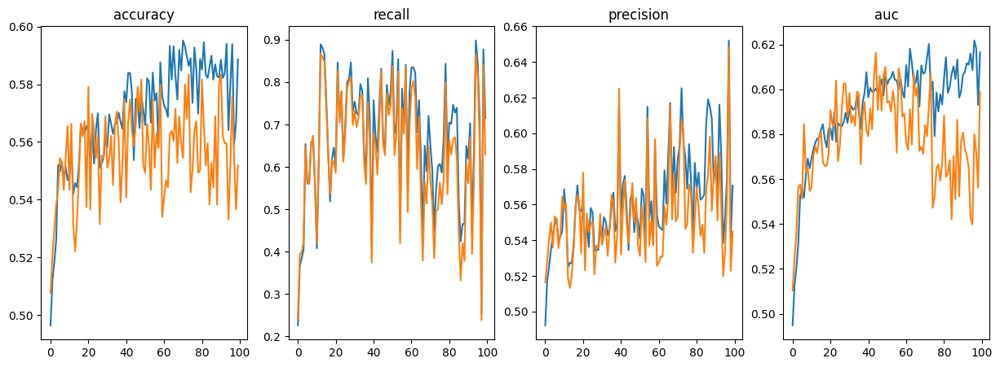

In [17]:
fig, ax = plt.subplots(1,4, figsize = (15,5))
epoch_idx = range(len(train_result_df))

ax[0].plot(epoch_idx,train_result_df.train_accuracys)
ax[0].set_title('accuracy')

ax[1].plot(epoch_idx,train_result_df.train_recalls)
ax[1].set_title('recall')

ax[2].plot(epoch_idx,train_result_df.train_precisions)
ax[2].set_title('precision')

ax[3].plot(epoch_idx,train_result_df.train_aucs)
ax[3].set_title('auc')


ax[0].plot(epoch_idx,train_result_df.val_accuracys)
ax[1].plot(epoch_idx,train_result_df.val_recalls)
ax[2].plot(epoch_idx,train_result_df.val_precisions)
ax[3].plot(epoch_idx,train_result_df.val_aucs)